In [8]:
import numpy as np
from collections import deque
import matplotlib.pyplot as plt
import random
import time
import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"   # comment this to use GPUs (if available)
os.environ["CUDA_VISIBLE_DEVICES"] = ""          # if having multiple GPUs, explicitly define which GPU to use
                                                 # tf has a nasty habit of taking up ALL available memory

# gym stuff
import gym
import gym_gazebo

# keras stuff
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam

import action_heatmap

model_save_path = './models/'

## Make environment and set parameters


In [9]:
SEED = 0
MAX_PATH_LENGTH = 5000
NUM_EPISODES = 1000

# Make the turtlebot-in-empty-world environment
env = gym.make('GazeboEmptyTurtlebotLidarNn-v0')
env.reset()
env._max_episode_steps = MAX_PATH_LENGTH

np.random.seed(SEED)


Roscore launched!
Gazebo launched!


## Create an experience replay buffer
Has the ability to store state transitions and return randomly sampled transitions. Vital for breaking correlations between data for training a neural network.

In [10]:
from collections import namedtuple, deque

class ReplayMemory:
    def __init__(self, capacity = 10000):
        self.memory = deque(maxlen=capacity) # max size for replay buffer
        self.Transition = namedtuple('Transition',
                        ('state', 'action', 'reward', 'next_state', 'done'))    
    
    def push(self, *args):
        """Saves a transition."""
        self.memory.append(self.Transition(*args))
        
    def sample(self, batch_size):
        if batch_size <= self.__len__():
            return random.sample(self.memory, batch_size)
        else:
            print('Tried to sample more samples than are in buffer')
            return -1

    def __len__(self):
        return len(self.memory)

## Define a DQN class

Has methods for creating the main and target networks, sampling actions, and syncing weights

In [11]:
class QNetwork:
    def __init__(self, state_size, action_size, activation_type, learning_rate, 
                 alpha_decay, gamma, batch_size):
        self.state_size = state_size
        self.action_size = action_size
        self.learning_rate = learning_rate
        self.alpha_decay = alpha_decay
        self.activation_type = activation_type
        self.gamma = gamma
        self.replay_buffer = ReplayMemory()
        self.batch_size = batch_size
        
    def create_model(self, hidden_layers):
        model = Sequential()
        if len(hidden_layers) == 0:
            model.add(Dense(self.action_size, input_shape=self.state_size, activation="linear"))
        else:
            for i, hid in enumerate(hidden_layers):
                if i == 0:
                    model.add(Dense(hid, input_dim=state_size, activation=self.activation_type))
                else:
                    model.add(Dense(hid, activation=self.activation_type))
            model.add(Dense(action_size, activation='linear'))
        optimizer = Adam(lr=self.learning_rate, decay=self.alpha_decay)
        model.compile(loss='mse', optimizer=optimizer)
        return model
        
    def init_models(self, hidden_layers):
        self.mainDQN = self.create_model(hidden_layers)
        self.targetDQN = self.create_model(hidden_layers)
        self.sync_weights()
    
    def model_descriptions(self):
        print('Main DQN model architecture --->')
        self.mainDQN.summary()
        
        print('Target DQN model architecture --->')
        self.targetDQN.summary()
        
    def sync_weights(self):
        self.targetDQN.set_weights(self.mainDQN.get_weights())
        
    def save_weights(self):
        self.mainDQN.save('./models/turtlebot_dqn_2.h5')
        
    def action_sampler(self, state, exploration_rate):
        if epsilon > np.random.rand():
            
            # Make a random action
            action = np.random.randint(0, self.action_size)
        else:
            
            # Get action from Q-network
            Qs = self.mainDQN.predict(state)[0]
            action = np.argmax(Qs)
        return action
    
    def train(self):
        transitions = self.replay_buffer.sample(self.batch_size)
        batch = self.replay_buffer.Transition(*zip(*transitions))
        x_batch = np.squeeze(np.asarray(batch.state))
        y_batch = self.mainDQN.predict(x_batch)
        for i, sample in enumerate(transitions):
            y_batch[i, sample.action] = sample.reward + self.gamma * \
            np.amax(self.targetDQN.predict(sample.next_state)[0]) * (1 - sample.done)
   
        self.sync_weights()
        
        self.mainDQN.fit(x_batch, y_batch, epochs=1, verbose=0)
        
        self.save_weights()
        
               

## Set hyperparameters and initialize DQN

Print out network architecture for both models to make sure everything is per plan.

In [12]:
learning_rate = 0.01
state_size = 2
action_size = 21
activation_type = 'relu'
hidden_size = [100, 100]
alpha_decay = 0.01
gamma = 0.99
batch_size = 64
learn_start = 64

DQN = QNetwork(state_size, action_size, activation_type, learning_rate, alpha_decay, gamma, batch_size)
DQN.init_models(hidden_size)
DQN.model_descriptions()

Main DQN model architecture --->
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_7 (Dense)              (None, 100)               300       
_________________________________________________________________
dense_8 (Dense)              (None, 100)               10100     
_________________________________________________________________
dense_9 (Dense)              (None, 21)                2121      
Total params: 12,521
Trainable params: 12,521
Non-trainable params: 0
_________________________________________________________________
Target DQN model architecture --->
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_10 (Dense)             (None, 100)               300       
_________________________________________________________________
dense_11 (Dense)             (None, 100)               10100     
____

## Start training!

Epsilon is set to decay at an exponential rate.

0.9803966865736877


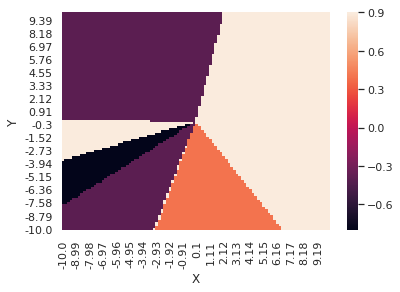

Return recorded for episode 1 :  678.8446271255541
0.9611815447608


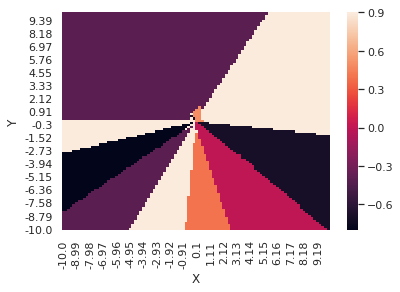

Return recorded for episode 2 :  675.0390876620124
0.9423468882484062


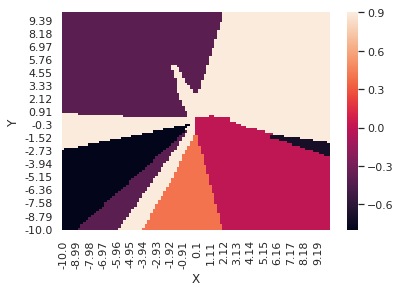

Return recorded for episode 3 :  672.583304753184
0.9238851829227694


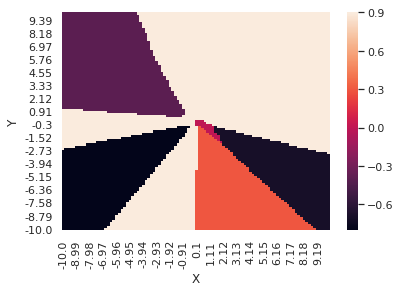

Return recorded for episode 4 :  667.3312246387206
0.9057890438555999


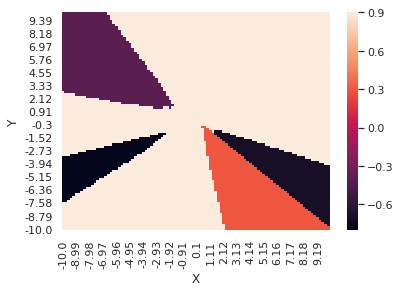

Return recorded for episode 5 :  660.122112852717
0.888051232349986


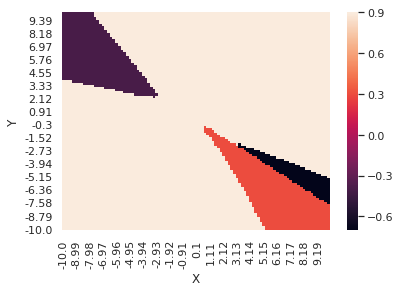

Return recorded for episode 6 :  666.1438412893808
0.8706646530448178


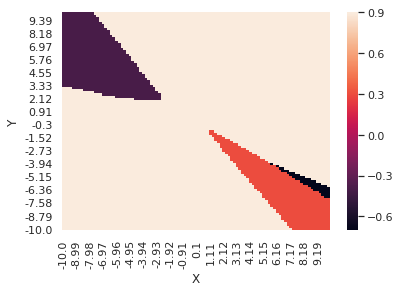

Return recorded for episode 7 :  666.3684954458047
0.8536223510765493


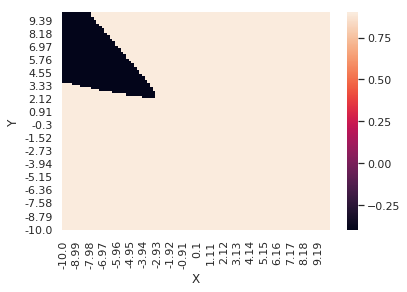

Return recorded for episode 8 :  668.5266290109328
0.8369175092971592


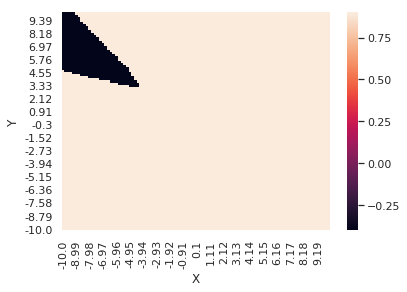

Return recorded for episode 9 :  661.131183016628
0.820543445547202


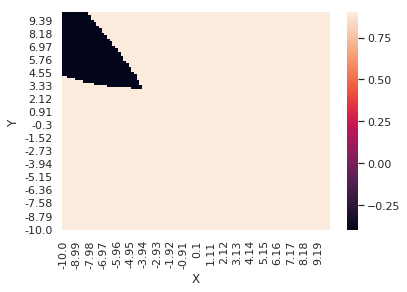

Return recorded for episode 10 :  656.0474407726585
Episode -90 ..10   Avg reward: 601.6090505794934   Epsilon: 0.8205
0.8044936099828537


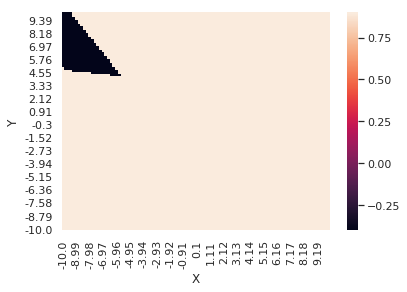

Return recorded for episode 11 :  666.7246350380241
0.7887615824558879


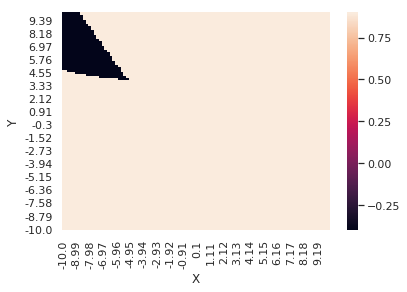

Return recorded for episode 12 :  662.4347659077357
0.7733410699455306


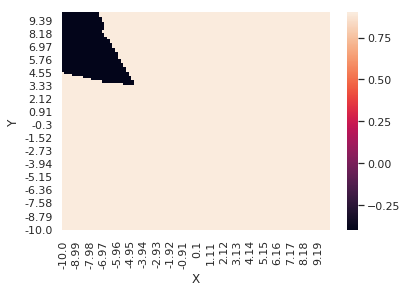

Return recorded for episode 13 :  674.9808778443468
0.7582259040411682


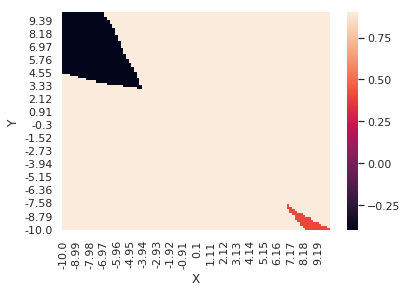

Return recorded for episode 14 :  673.6028576071802
0.7434100384749007


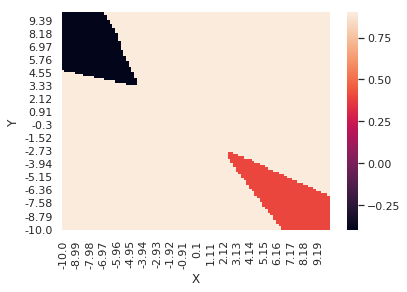

Return recorded for episode 15 :  671.3764893321078
0.7288875467029541


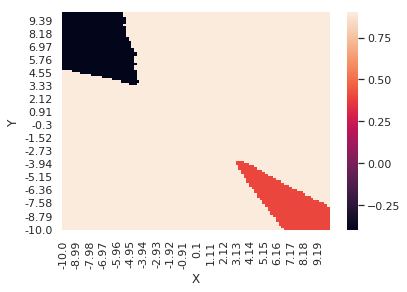

Return recorded for episode 16 :  670.1219816838424
0.7146526195349836


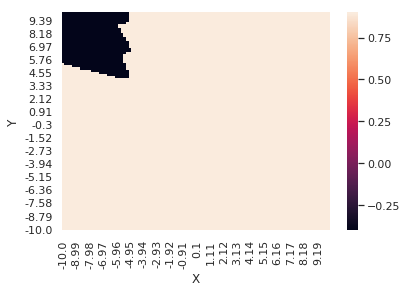

Return recorded for episode 17 :  673.081142778149
0.7006995628103208


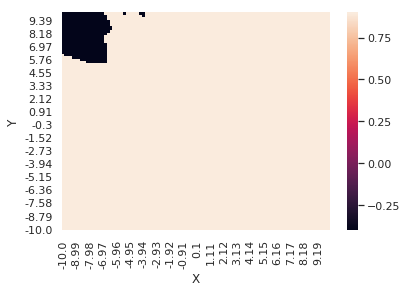

Return recorded for episode 18 :  670.8512000579537
0.6870227951202322


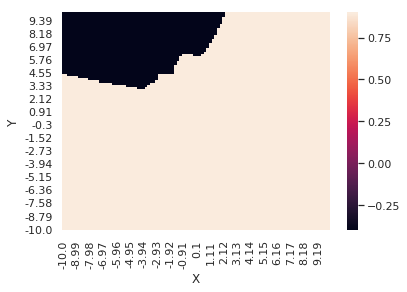

Return recorded for episode 19 :  684.5192862887932
0.6736168455752829


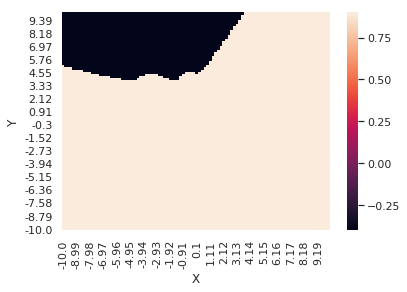

Return recorded for episode 20 :  672.8433837608113
Episode -80 ..20   Avg reward: 670.3740677310791   Epsilon: 0.6736
0.6604763516169062


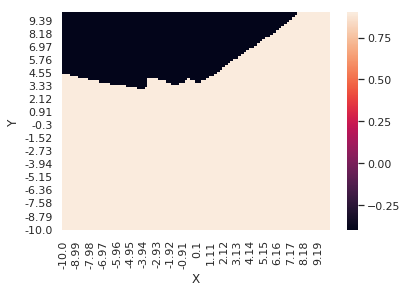

Return recorded for episode 21 :  660.4109105625482
0.64759605687231


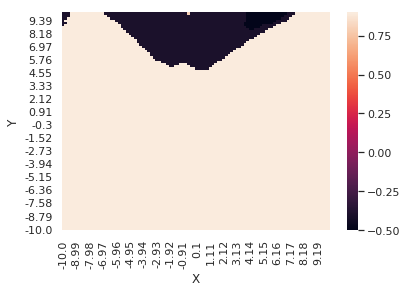

Return recorded for episode 22 :  693.6478723121229
0.6349708090518567


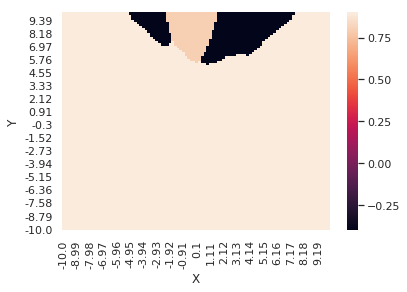

Return recorded for episode 23 :  680.8247708262608
0.6225955578880794


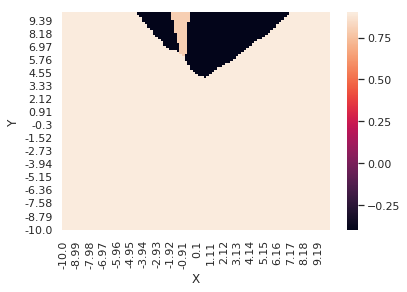

Return recorded for episode 24 :  703.2407546958997
0.6104653531155071


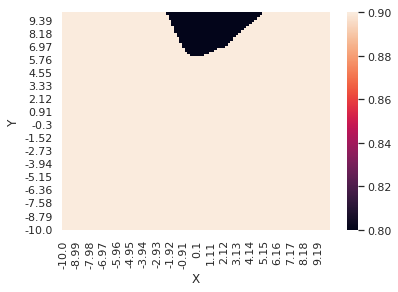

Return recorded for episode 25 :  682.3815488888598
0.5985753424904925


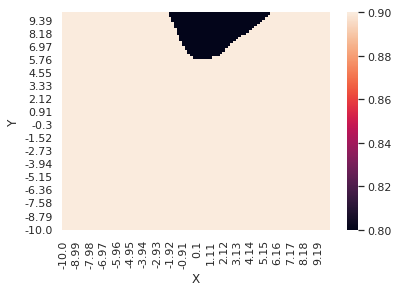

Return recorded for episode 26 :  690.9098471964137
0.5869207698502498


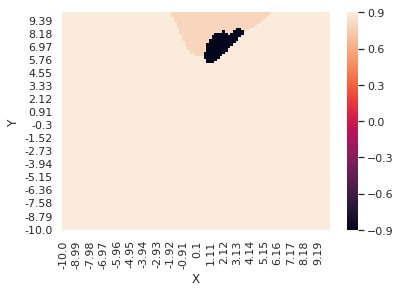

Return recorded for episode 27 :  692.0248444258475
0.5754969732103268


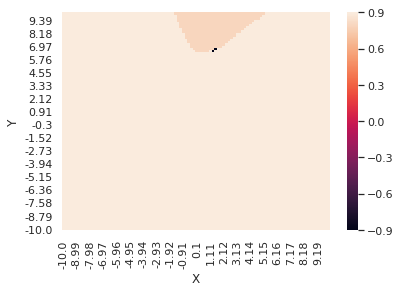

Return recorded for episode 28 :  698.9741242844457
0.564299382899748


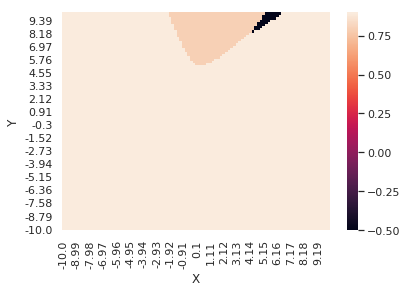

Return recorded for episode 29 :  714.2061645672085
0.5533235197330861


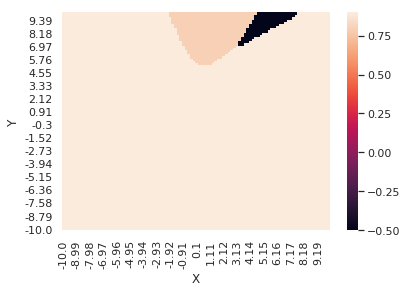

Return recorded for episode 30 :  690.2568959006283
Episode -70 ..30   Avg reward: 688.9464221520418   Epsilon: 0.5533
0.5425649932187278


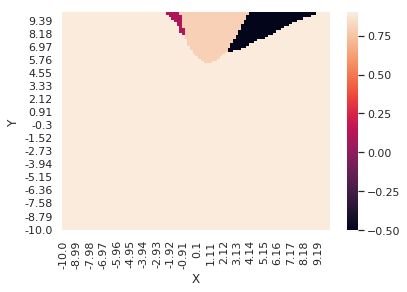

Return recorded for episode 31 :  702.7598979715834
0.5320194998026181


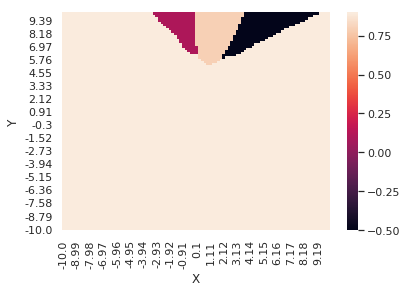

Return recorded for episode 32 :  704.5646563249248
0.5216828211467822


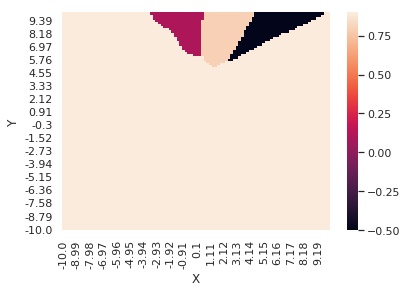

Return recorded for episode 33 :  706.0834593562486
0.5115508224419336


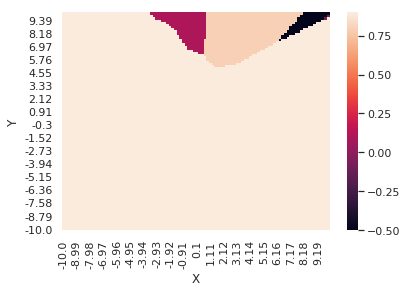

Return recorded for episode 34 :  713.9328891452184
0.5016194507534953


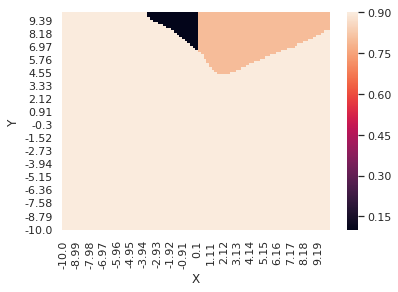

Return recorded for episode 35 :  2170.9708282031106
0.491884733400372


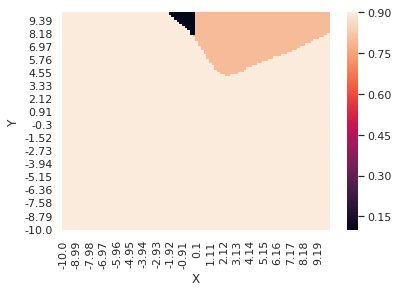

Return recorded for episode 36 :  2081.7859167570555
0.48234277636582407


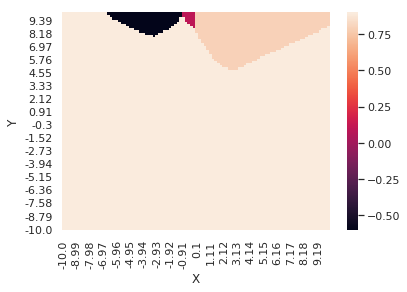

Return recorded for episode 37 :  695.452010191237
0.47298976273981014


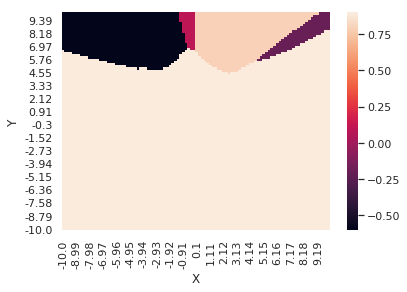

Return recorded for episode 38 :  728.5220022728283
0.4638219511921713


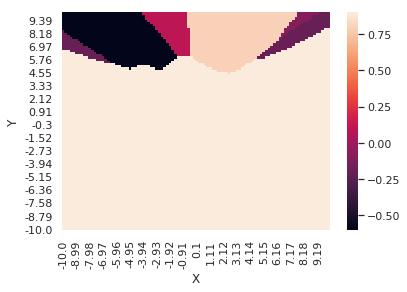

Return recorded for episode 39 :  750.3929372349054
0.45483567447604933


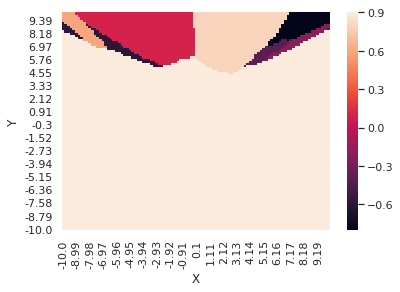

Return recorded for episode 40 :  717.9218549247158
Episode -60 ..40   Avg reward: 994.4721493357738   Epsilon: 0.4548
0.44602733796093924


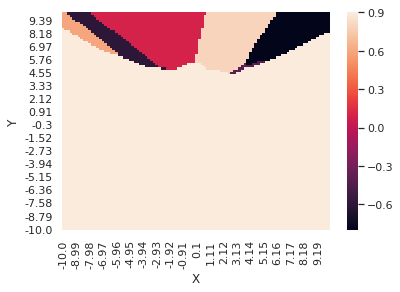

Return recorded for episode 41 :  731.6551569947829
0.43739341819478894


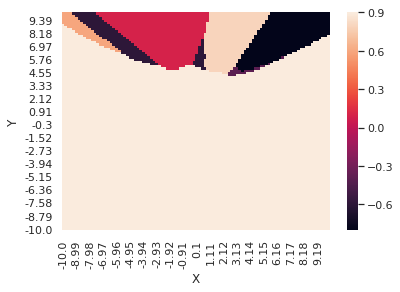

Return recorded for episode 42 :  723.2074395479109
0.4289304614945713


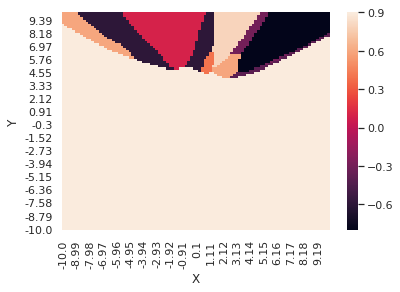

Return recorded for episode 43 :  730.0697388454638
0.42063508256476556


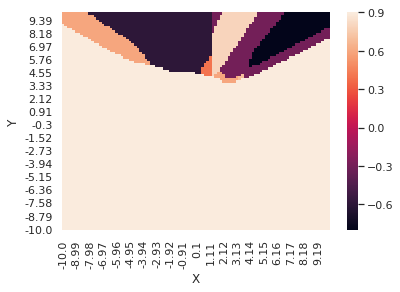

Return recorded for episode 44 :  737.0770992839924
0.4125039631431931


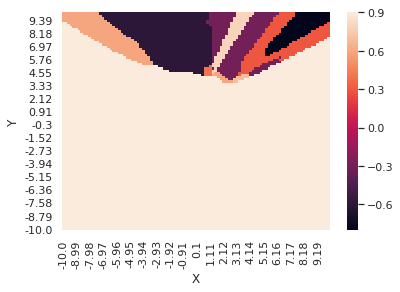

Return recorded for episode 45 :  752.054216847571
0.404533850673669


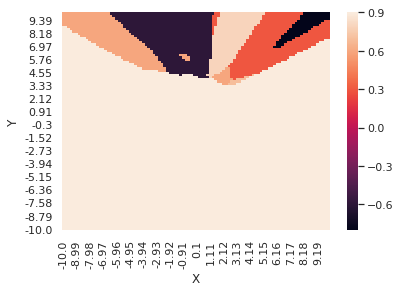

Return recorded for episode 46 :  748.9007696234113
0.3967215570049359


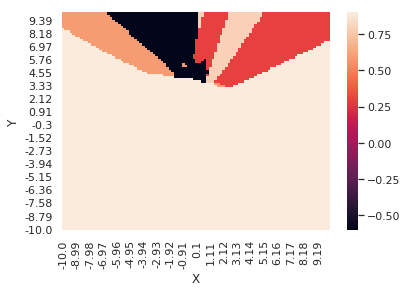

Return recorded for episode 47 :  730.5985284805525
0.38906395711536096


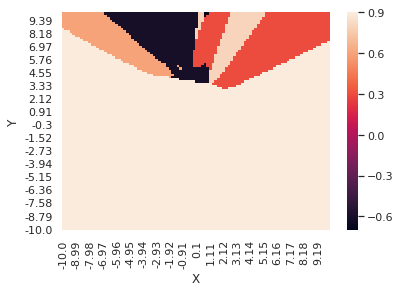

Return recorded for episode 48 :  728.4537620396176
0.3815579878628856


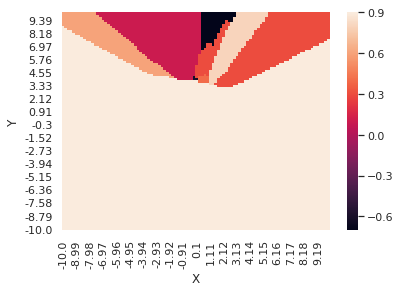

Return recorded for episode 49 :  778.2705874730145
0.3742006467597279


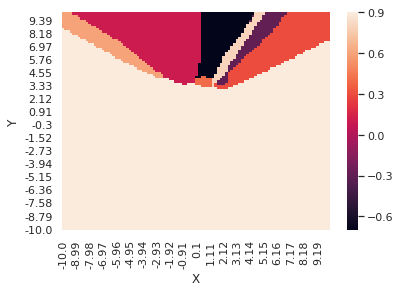

Return recorded for episode 50 :  777.1490255877296
Episode -50 ..50   Avg reward: 737.8209154061034   Epsilon: 0.3742
0.3669889907713475


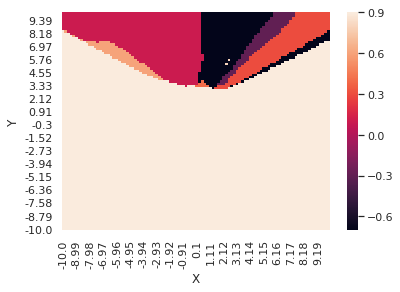

Return recorded for episode 51 :  724.4920067150194
0.35992013513919235


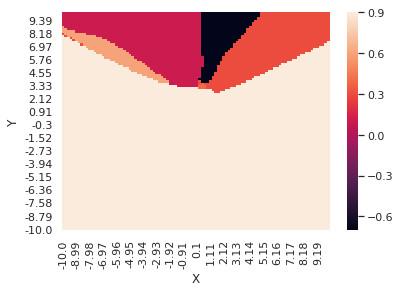

Return recorded for episode 52 :  755.7564447207025
0.3529912522267568


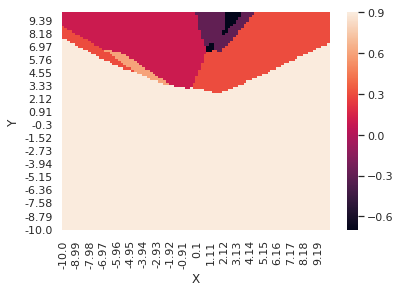

Return recorded for episode 53 :  743.2643650294576
0.34619957038848975


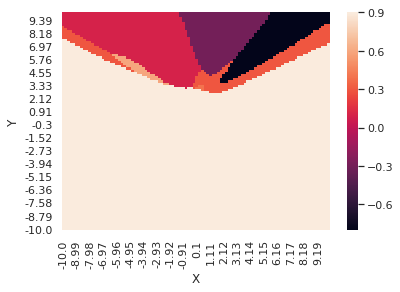

Return recorded for episode 54 :  778.5393692042751
0.3395423728610988


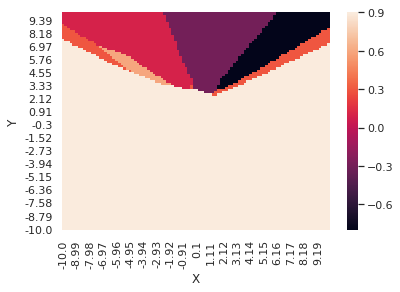

Return recorded for episode 55 :  763.7498325534892
0.33301699667680906


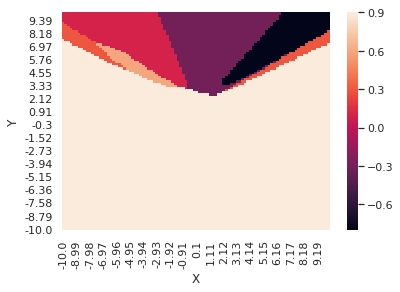

Return recorded for episode 56 :  763.5324210252571
0.3266208315981408


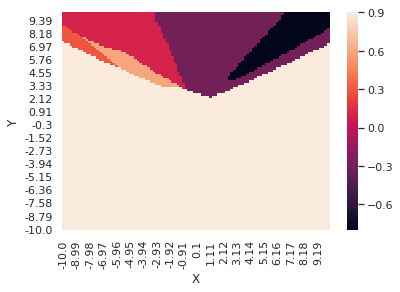

Return recorded for episode 57 :  753.6179850782964
0.3203513190737793


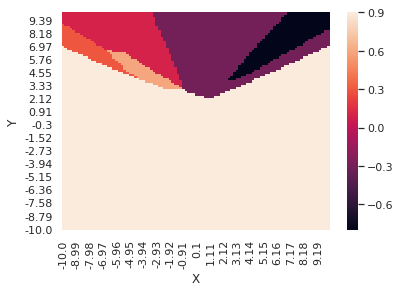

Return recorded for episode 58 :  767.4097104141407
0.31420595121511996


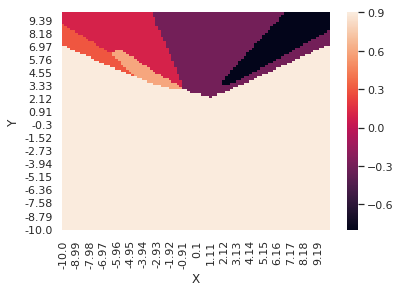

Return recorded for episode 59 :  749.3227459484644
0.3081822697930801


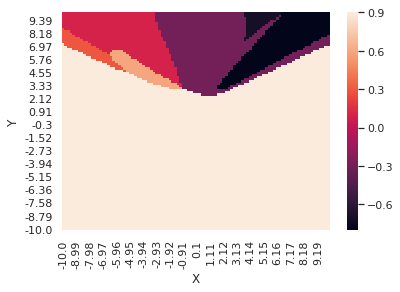

Return recorded for episode 60 :  751.5927906082783
Episode -40 ..60   Avg reward: 757.6833906276831   Epsilon: 0.3082
0.30227786525477407


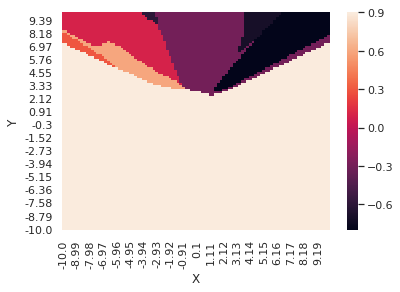

Return recorded for episode 61 :  764.6099496474609
0.29649037575966014


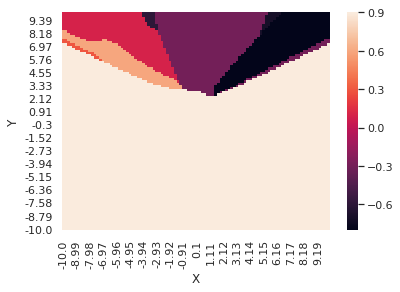

Return recorded for episode 62 :  758.7532068535337
0.2908174862347727


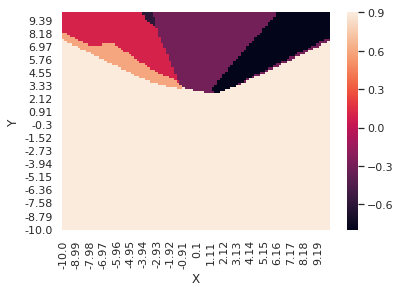

Return recorded for episode 63 :  756.111573873115
0.2852569274486622


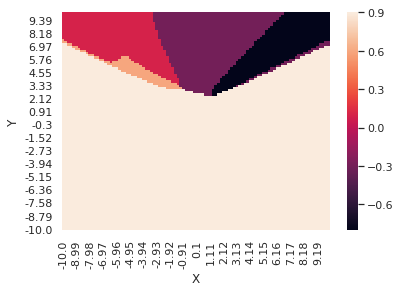

Return recorded for episode 64 :  777.9126679012578
0.27980647510367246


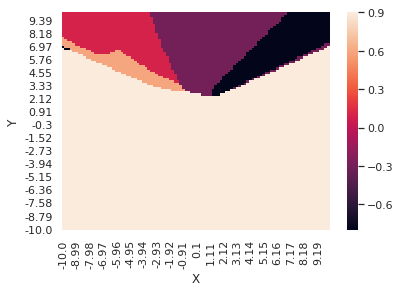

Return recorded for episode 65 :  770.1032387180218
0.27446394894619186


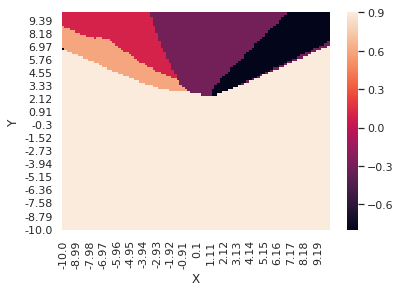

Return recorded for episode 66 :  759.2020897288525
0.26922721189452276


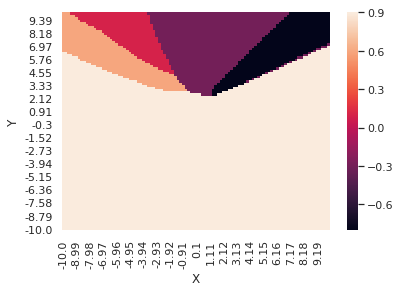

Return recorded for episode 67 :  771.2271210891639
0.26409416918402034


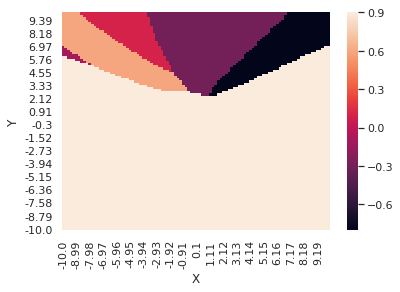

Return recorded for episode 68 :  770.6437296795148
0.2590627675291589


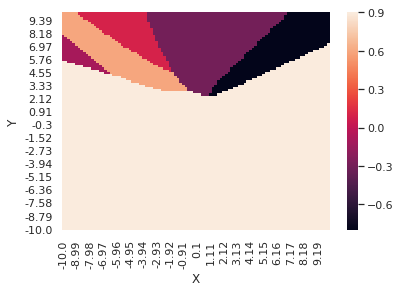

Return recorded for episode 69 :  781.4705742037844
0.2541309943021904


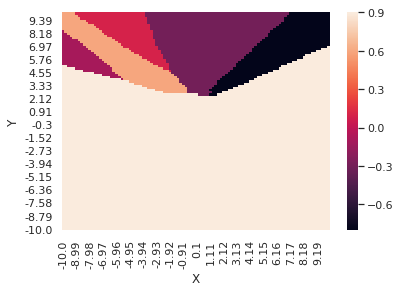

Return recorded for episode 70 :  780.360360928667
Episode -30 ..70   Avg reward: 766.1626942302983   Epsilon: 0.2541
0.24929687672806608


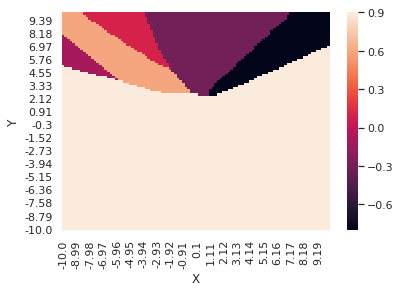

Return recorded for episode 71 :  781.0479196190677
0.24455848109530054


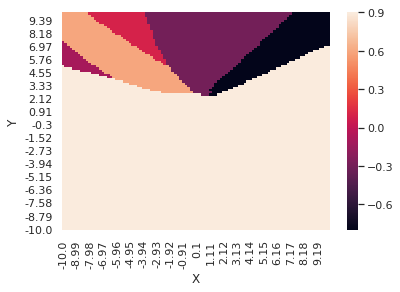

Return recorded for episode 72 :  772.0790272644812
0.23991391198246126


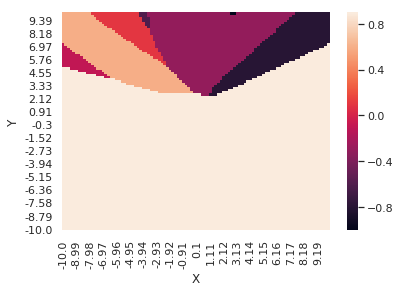

Return recorded for episode 73 :  775.1318652310429
0.2353613114999746


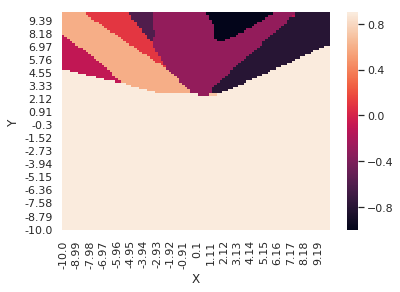

Return recorded for episode 74 :  779.638748166329
0.23089885854694553


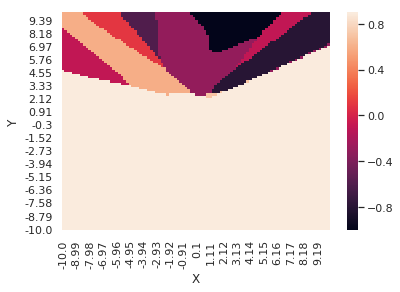

Return recorded for episode 75 :  771.0033551177803
0.22652476808269262


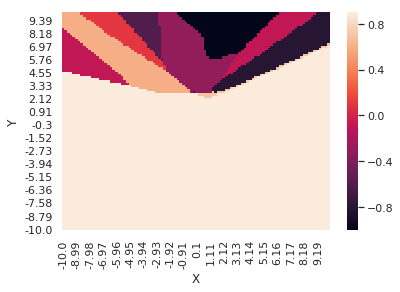

Return recorded for episode 76 :  782.3257830036592
0.22223729041270818


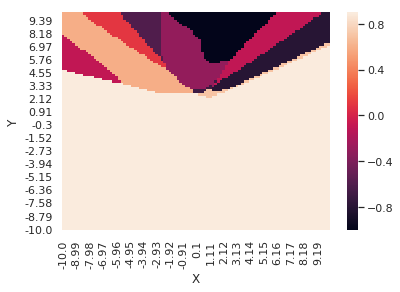

Return recorded for episode 77 :  779.0332005168601
0.21803471048875708


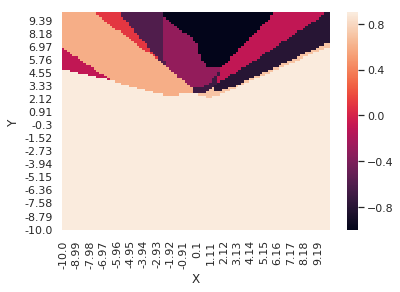

Return recorded for episode 78 :  801.7295014857091
0.21391534722283462


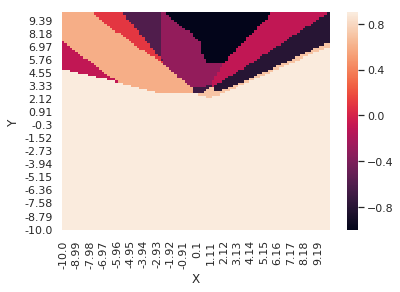

Return recorded for episode 79 :  782.0709863742514
0.20987755281470882


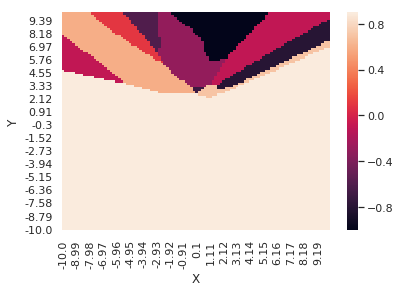

Return recorded for episode 80 :  791.9003320147093
Episode -20 ..80   Avg reward: 780.4420747707848   Epsilon: 0.2099
0.2059197120927785


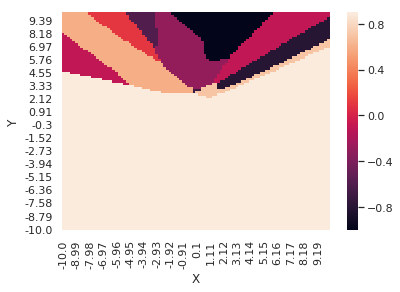

Return recorded for episode 81 :  785.8213950401766
0.20204024186798297


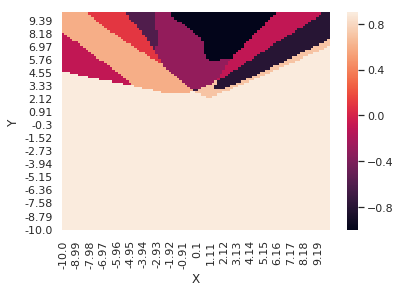

Return recorded for episode 82 :  796.3486698860404
0.1982375903005053


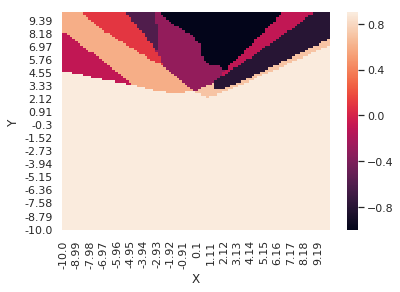

Return recorded for episode 83 :  775.0929563069041
0.19451023627901587


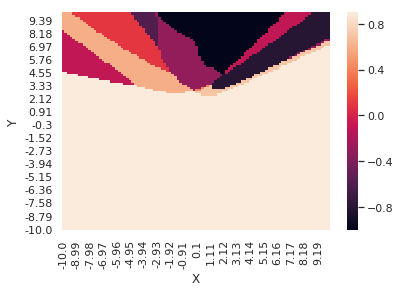

Return recorded for episode 84 :  803.1757470981095
0.19085668881220733


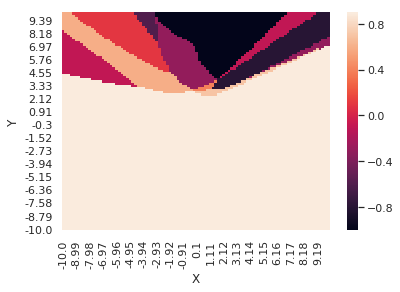

Return recorded for episode 85 :  809.6548230307681
0.1872754864323783


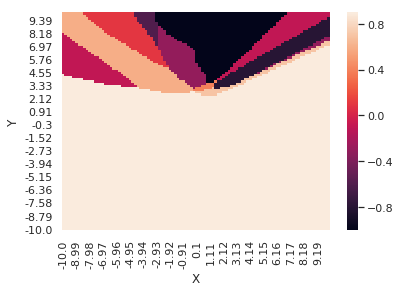

Return recorded for episode 86 :  796.3670649470553
0.1837651966108269


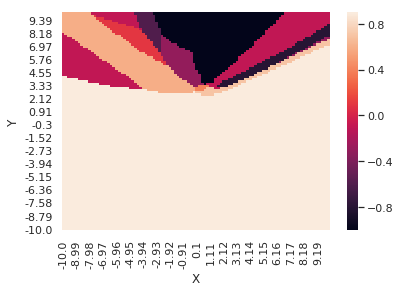

Return recorded for episode 87 :  802.193557617628
0.18032441518482004


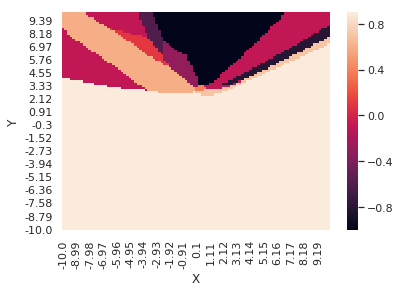

Return recorded for episode 88 :  800.6769815107073
0.17695176579590954


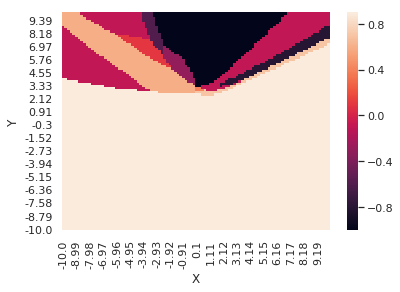

Return recorded for episode 89 :  802.01992035794
0.17364589933937066


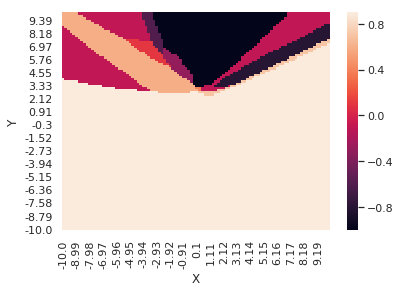

Return recorded for episode 90 :  804.2074005562457
Episode -10 ..90   Avg reward: 796.3251447810038   Epsilon: 0.1736
0.17040549342454195


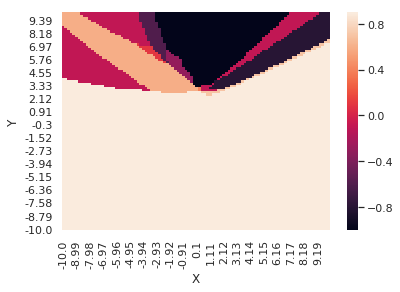

Return recorded for episode 91 :  795.5072292937111
0.16722925184585147


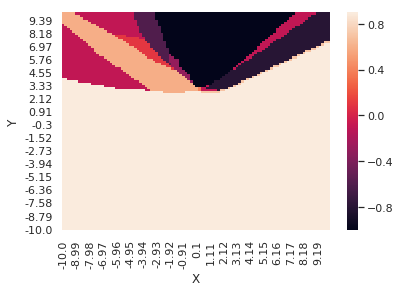

Return recorded for episode 92 :  797.4413483146569
0.16411590406431734


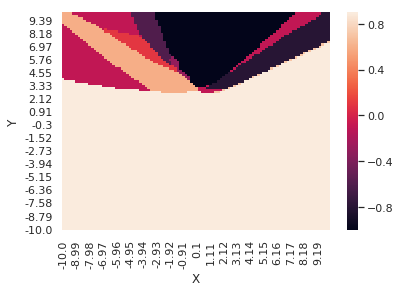

Return recorded for episode 93 :  799.7389975772677
0.16106420469931504


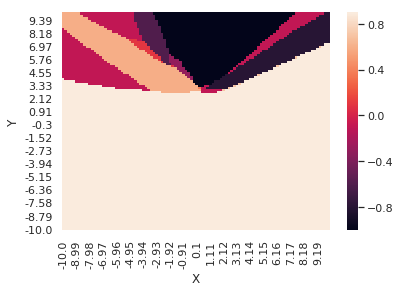

Return recorded for episode 94 :  815.3833214850662
0.1580729330304087


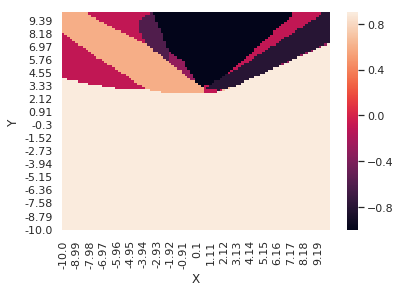

Return recorded for episode 95 :  800.549606292097
0.15514089250904667


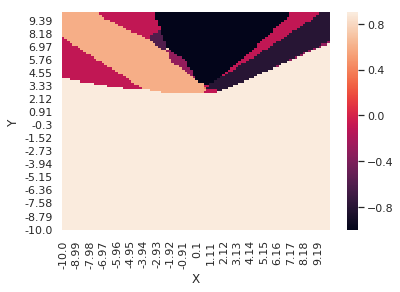

Return recorded for episode 96 :  796.848405931242
0.1522669102799259


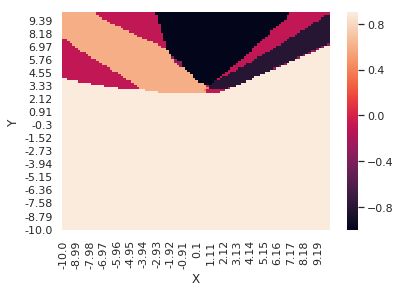

Return recorded for episode 97 :  810.4379846022136
0.14944983671183457


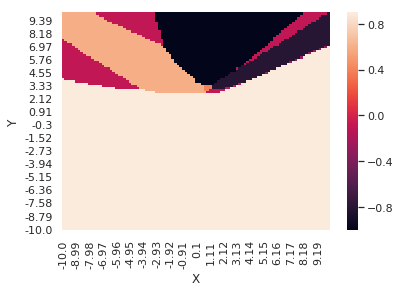

Return recorded for episode 98 :  799.2508638511952
0.1466885449377839


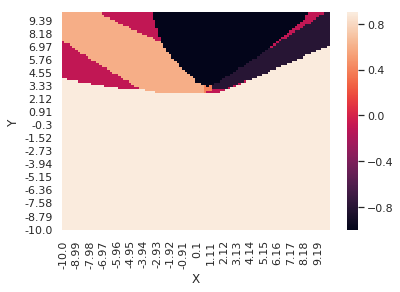

Return recorded for episode 99 :  785.7771481738785
0.1439819304042466


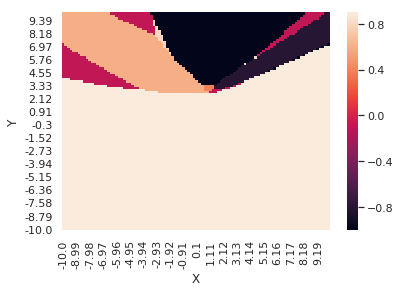

Return recorded for episode 100 :  797.7461350093735
Episode 0 ..100   Avg reward: 800.5142306077574   Epsilon: 0.1440
0.1413289104293205


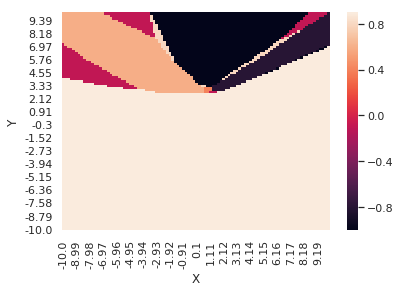

Return recorded for episode 101 :  803.8320301144555
0.13872842376964165


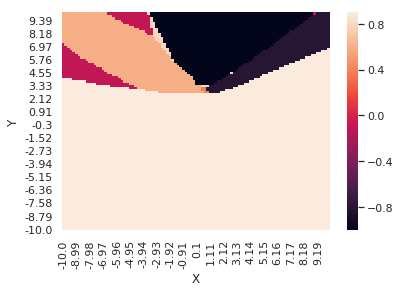

Return recorded for episode 102 :  811.8259139364922
0.13617943019587256


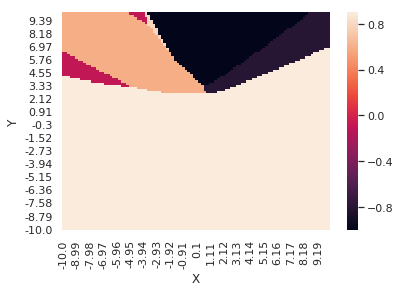

Return recorded for episode 103 :  802.0210928379358
0.13368091007659658


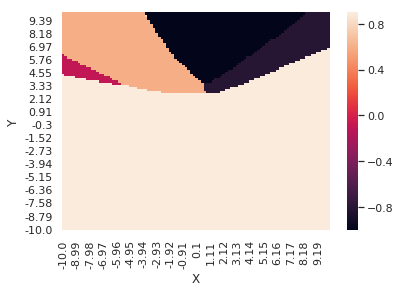

Return recorded for episode 104 :  802.498267089068
0.13123186397045208


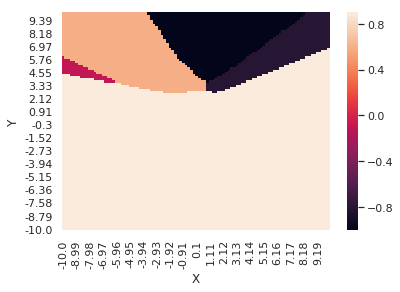

Return recorded for episode 105 :  811.1359170838704
0.12883131222634217


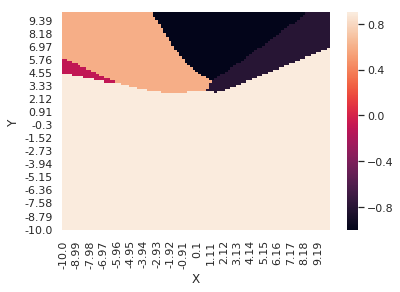

Return recorded for episode 106 :  800.3223023870354
0.1264782945915614


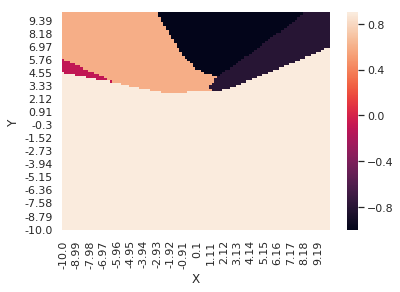

Return recorded for episode 107 :  792.6797502729161
0.12417186982768189


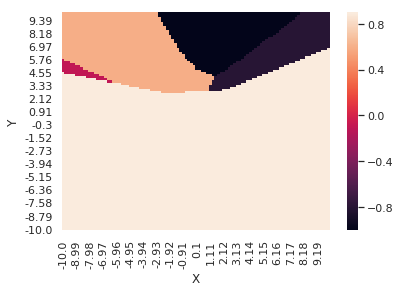

Return recorded for episode 108 :  803.6341311394978
0.12191111533404535


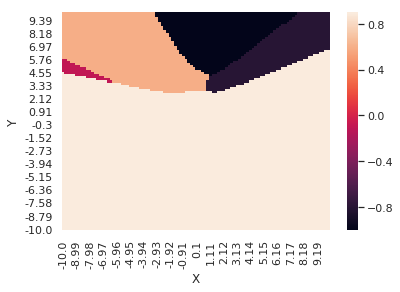

Return recorded for episode 109 :  805.5067818628812
0.11969512677871053


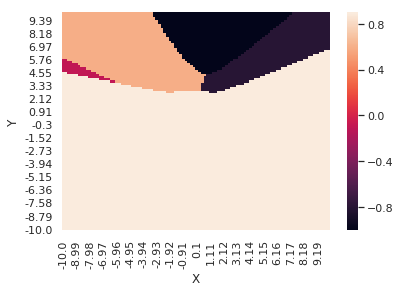

Return recorded for episode 110 :  814.2483597152494
Episode 10 ..110   Avg reward: 803.1202321733525   Epsilon: 0.1197
0.11752301773670837


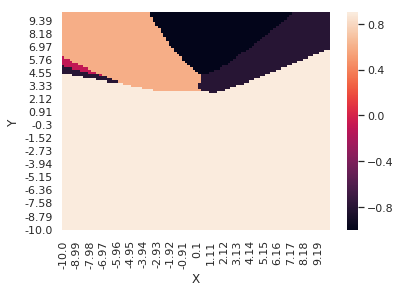

Return recorded for episode 111 :  808.9555327976329
0.11539391933546027


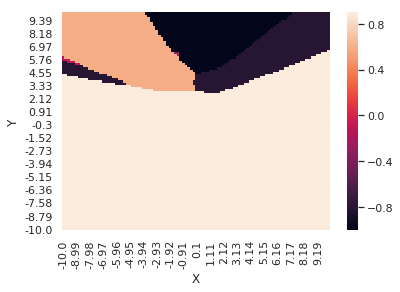

Return recorded for episode 112 :  810.6709207126127
0.11330697990721733


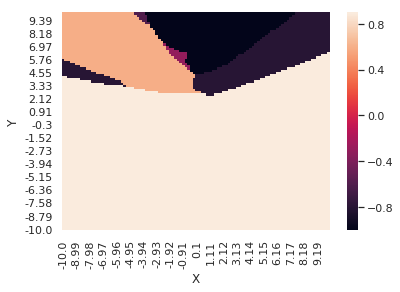

Return recorded for episode 113 :  805.3578589399691
0.11126136464838206


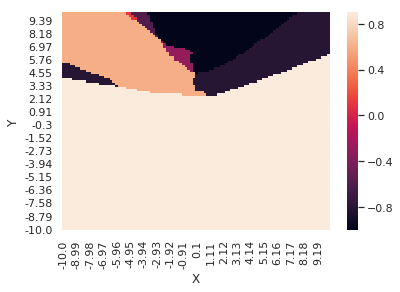

Return recorded for episode 114 :  808.0787602215553
0.10925625528557566


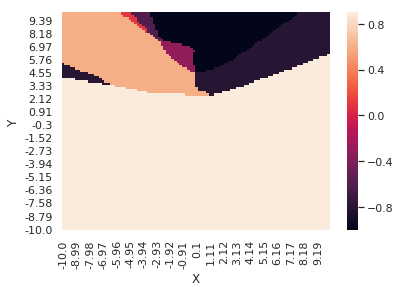

Return recorded for episode 115 :  795.0252702953633
0.10729084974831793


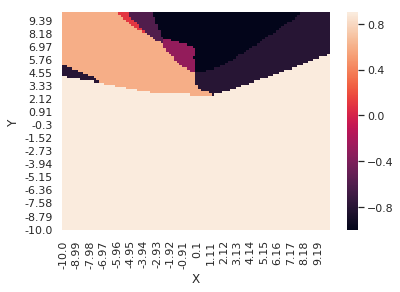

Return recorded for episode 116 :  793.1320621298307
0.10536436184818809


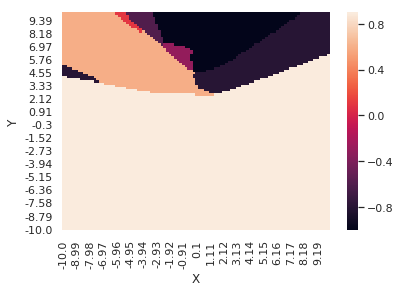

Return recorded for episode 117 :  813.7623513480991
0.10347602096433932


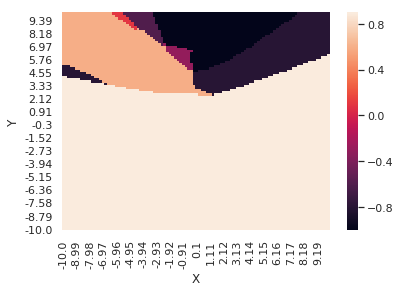

Return recorded for episode 118 :  805.2695322305415
0.10162507173523985


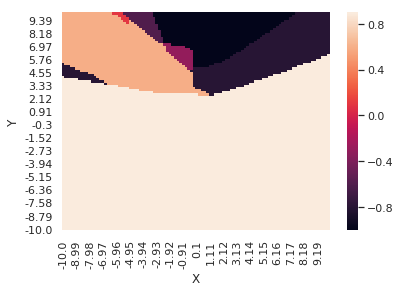

Return recorded for episode 119 :  797.80138786183
0.09981077375651838


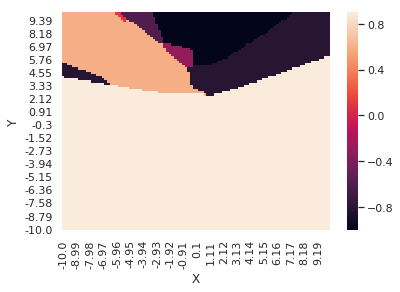

Return recorded for episode 120 :  814.1172354015915
Episode 20 ..120   Avg reward: 805.2302036252685   Epsilon: 0.0998
0.09803240128479247


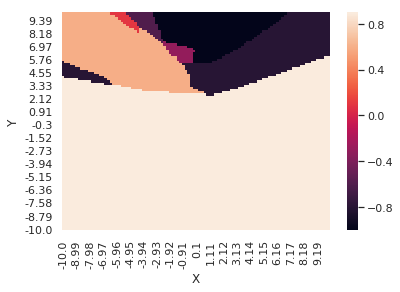

Return recorded for episode 121 :  808.4320920978394
0.09628924294736148


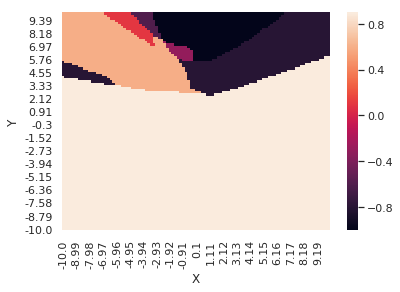

Return recorded for episode 122 :  802.4271357476775
0.09458060145764802


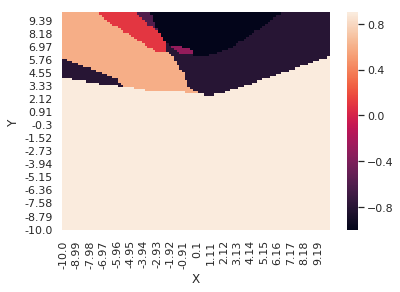

Return recorded for episode 123 :  811.7171453365838
0.092905793336274


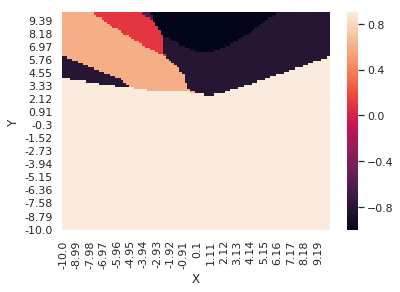

Return recorded for episode 124 :  794.6087768206091
0.0912641486376598


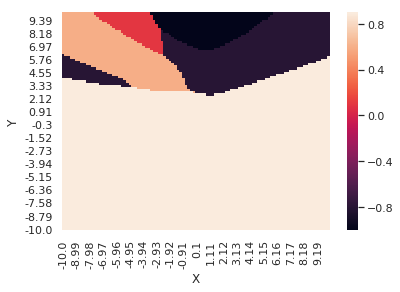

Return recorded for episode 125 :  801.6373154130283
0.08965501068203711


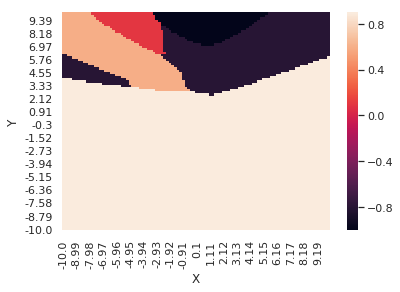

Return recorded for episode 126 :  807.8224438679808
0.08807773579276819


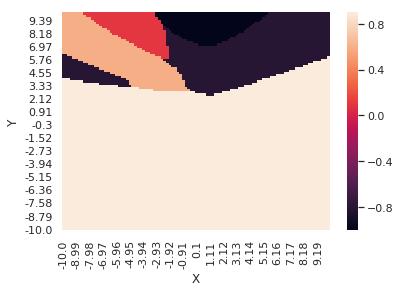

Return recorded for episode 127 :  813.4428454341586
0.08653169303886674


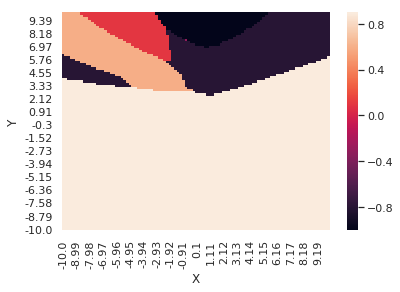

Return recorded for episode 128 :  803.196998807194
0.08501626398261702


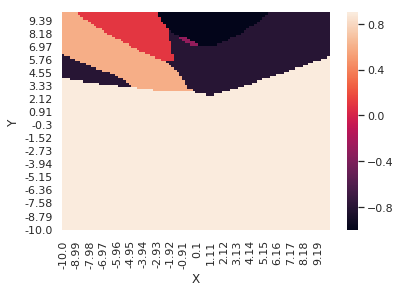

Return recorded for episode 129 :  807.9248584282577
0.08353084243219053


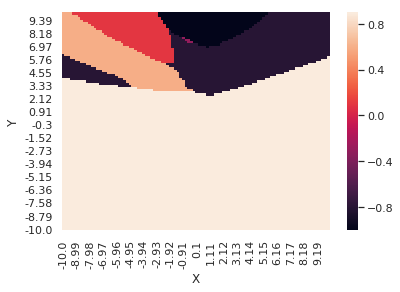

Return recorded for episode 130 :  803.7820315360826
Episode 30 ..130   Avg reward: 806.532684735492   Epsilon: 0.0835
0.08207483419916123


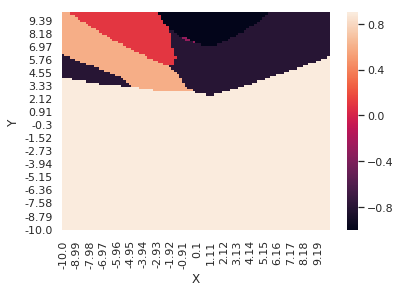

Return recorded for episode 131 :  799.3058427383302
0.08064765686082219


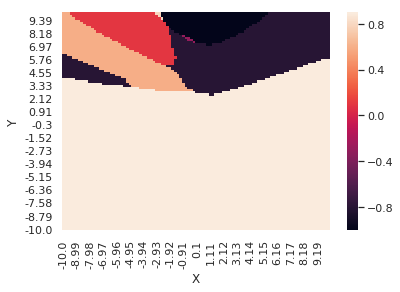

Return recorded for episode 132 :  805.6916222497207
0.0792487395272088


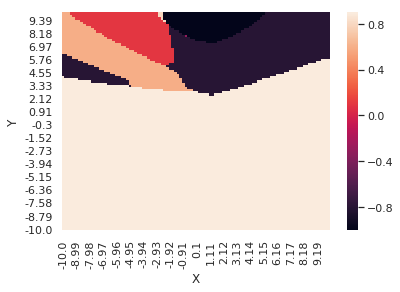

Return recorded for episode 133 :  800.4818556827365
0.07787752261273513


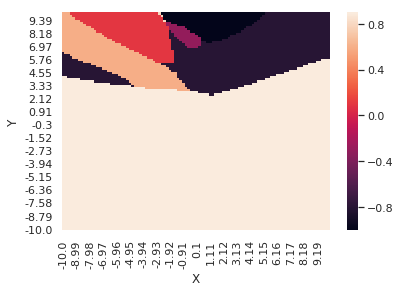

Return recorded for episode 134 :  806.7387253273599
0.07653345761235225


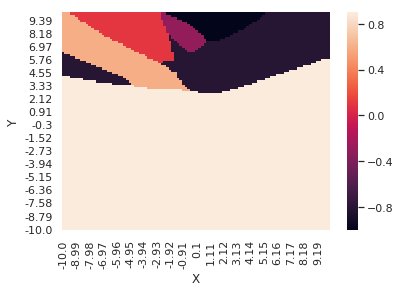

Return recorded for episode 135 :  808.776560795014
0.07521600688213892


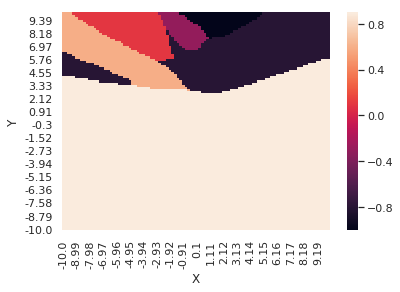

Return recorded for episode 136 :  821.1873531128498
0.07392464342423678


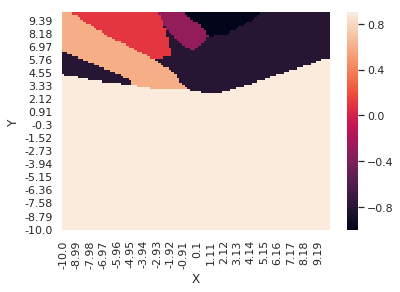

Return recorded for episode 137 :  802.2294127401439
0.07265885067604429


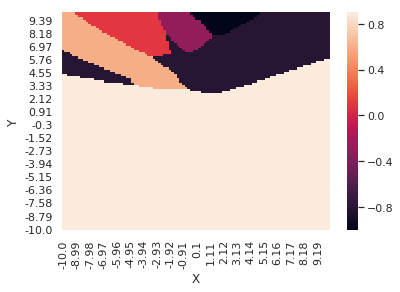

Return recorded for episode 138 :  810.2185941623799
0.0714181223035847


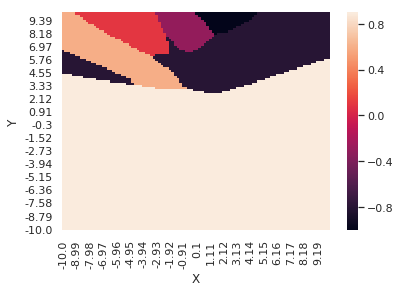

Return recorded for episode 139 :  813.0213654996517
0.07020196199896576


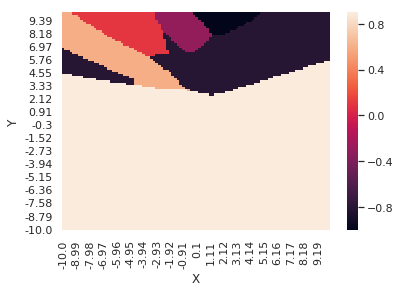

Return recorded for episode 140 :  798.0474320523823
Episode 40 ..140   Avg reward: 807.1433363844269   Epsilon: 0.0702
0.06900988328184997


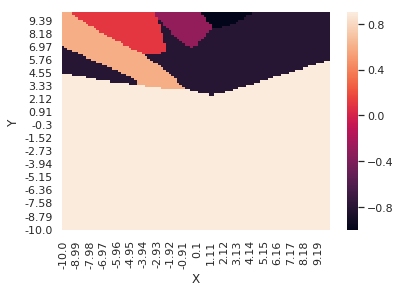

Return recorded for episode 141 :  800.4272530504851
0.06784140930485581


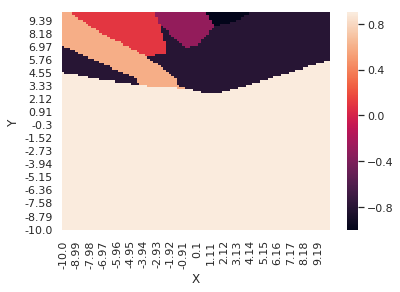

Return recorded for episode 142 :  809.0103919097926
0.06669607266281269


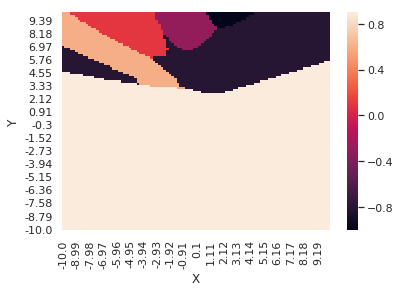

Return recorded for episode 143 :  807.9300246097482
0.06557341520579238


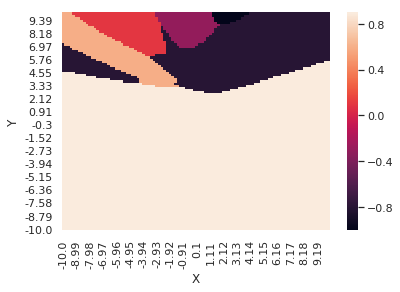

Return recorded for episode 144 :  805.7524353984637
0.06447298785584316


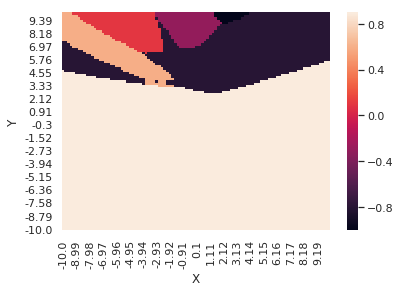

Return recorded for episode 145 :  809.1632861696244
0.06339435042735246


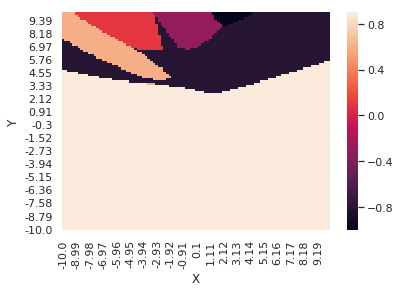

Return recorded for episode 146 :  818.4253795897857
0.06233707145096687


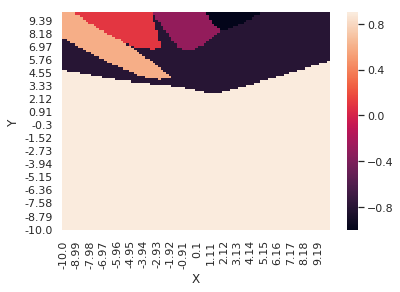

Return recorded for episode 147 :  803.4918903712554
0.061300728000998575


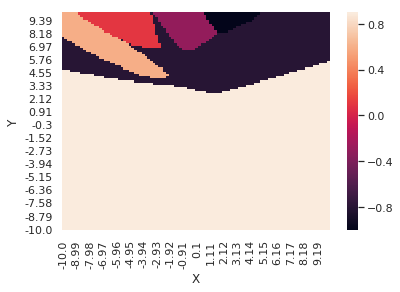

Return recorded for episode 148 :  804.2686590980661
0.060284905526249516


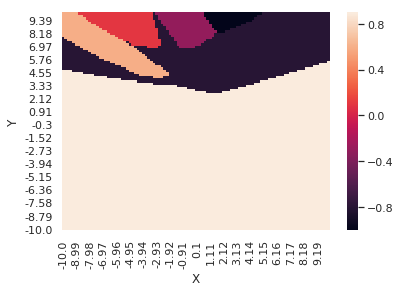

Return recorded for episode 149 :  805.2690490291375
0.05928919768418531


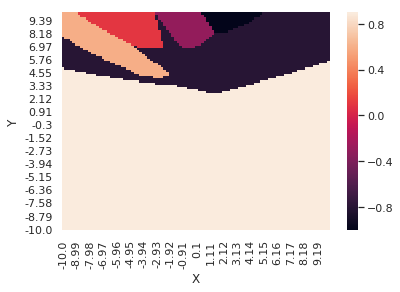

Return recorded for episode 150 :  811.3262419248589
Episode 50 ..150   Avg reward: 806.178580127874   Epsilon: 0.0593
0.058313206178392835


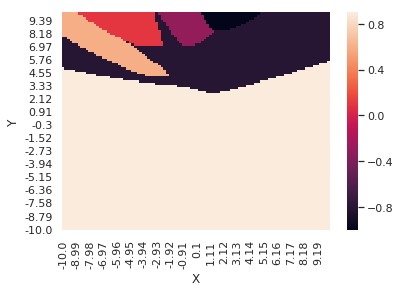

Return recorded for episode 151 :  810.7872513758834
0.057356540599256385


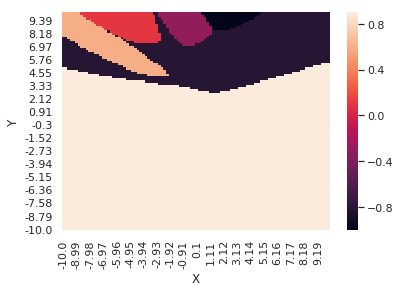

Return recorded for episode 152 :  810.1381549626543
0.0564188182677886


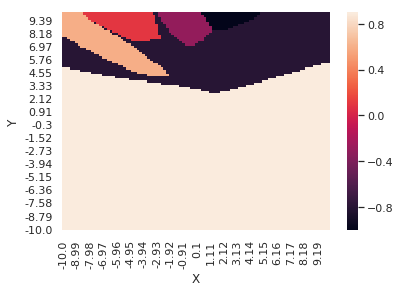

Return recorded for episode 153 :  822.7234125397222
0.05549966408255377


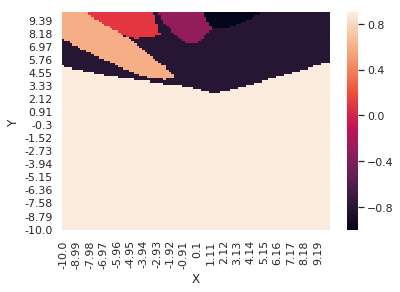

Return recorded for episode 154 :  813.2339484847574
0.05459871036962222


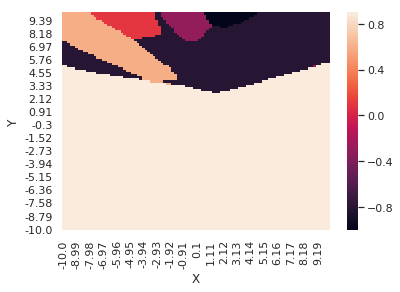

Return recorded for episode 155 :  813.1007372793857
0.05371559673549593


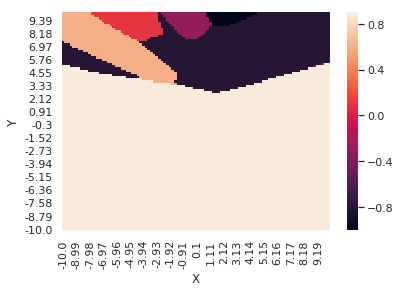

Return recorded for episode 156 :  808.3535625209037
0.05284996992294624


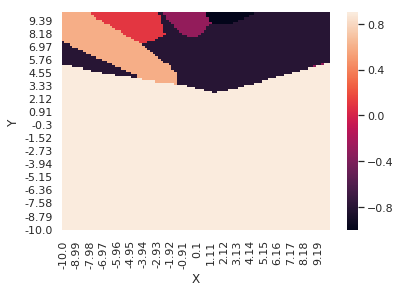

Return recorded for episode 157 :  810.7295523009211
0.05200148366970627


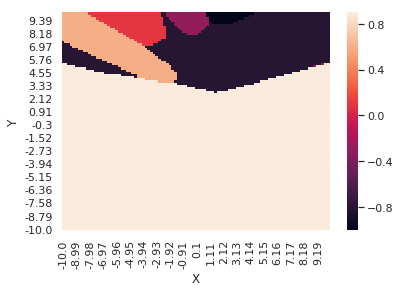

Return recorded for episode 158 :  812.2497430481278
0.05116979856996143


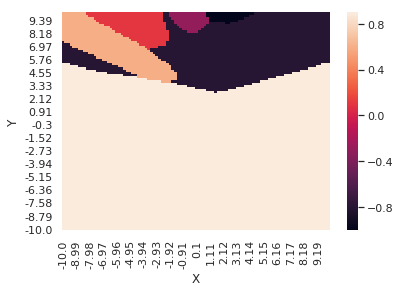

Return recorded for episode 159 :  820.6232302932082
0.05035458193858255


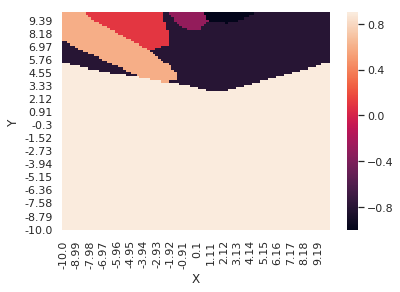

Return recorded for episode 160 :  820.0244474250081
Episode 60 ..160   Avg reward: 813.3265834730424   Epsilon: 0.0504
0.04955550767804736


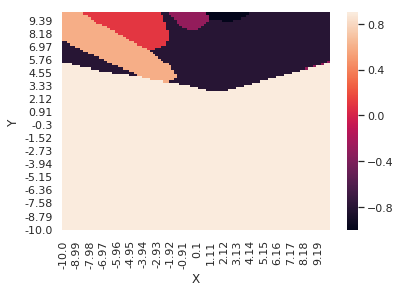

Return recorded for episode 161 :  805.8913234181153
0.0487722561479972


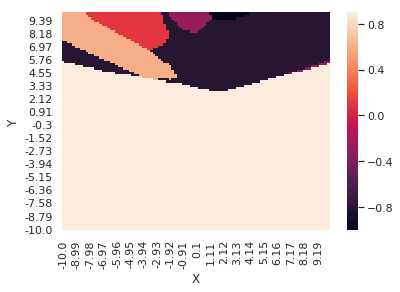

Return recorded for episode 162 :  803.1410342816558
0.04800451403737654


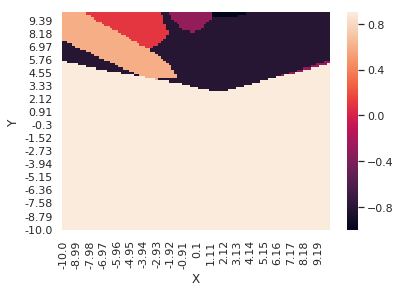

Return recorded for episode 163 :  808.545654338849
0.04725197423910444


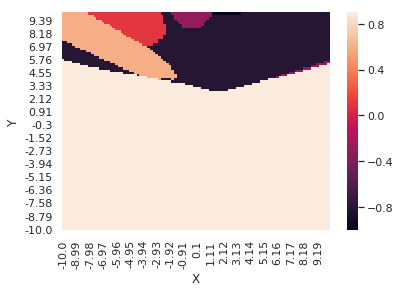

Return recorded for episode 164 :  823.3466977233801
0.046514335727227595


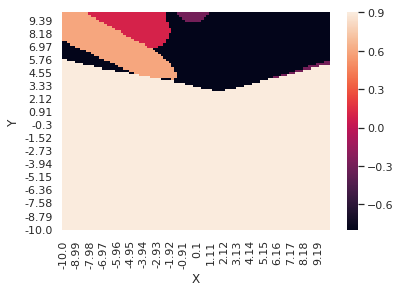

Return recorded for episode 165 :  806.9346378152708
0.04579130343650595


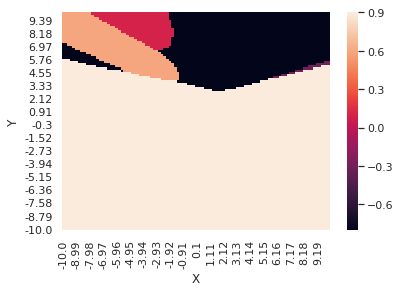

Return recorded for episode 166 :  818.3093439222723
0.04508258814438266


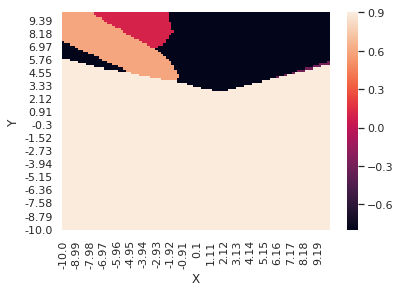

Return recorded for episode 167 :  808.8898035108057
0.044387906355291176


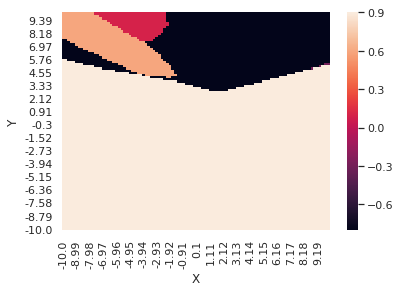

Return recorded for episode 168 :  811.8453479957419
0.04370698018725335


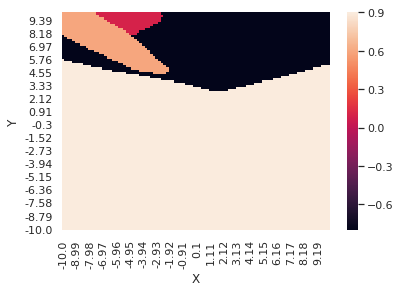

Return recorded for episode 169 :  809.7420529459112
0.04303953726072282


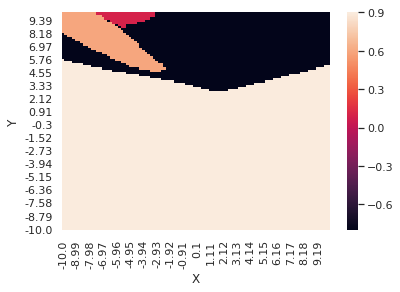

Return recorded for episode 170 :  803.9728261930517
Episode 70 ..170   Avg reward: 811.667034337701   Epsilon: 0.0430
0.042385310589629625


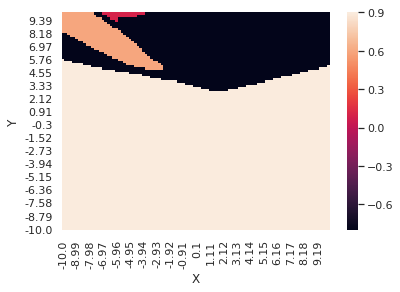

Return recorded for episode 171 :  809.3259928304917
0.04174403847458216


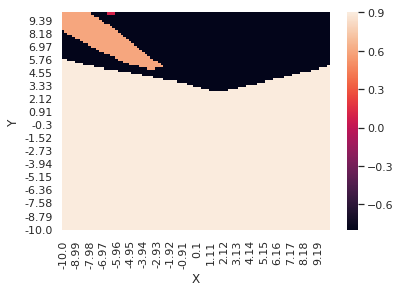

Return recorded for episode 172 :  812.5005610660993
0.04111546439818403


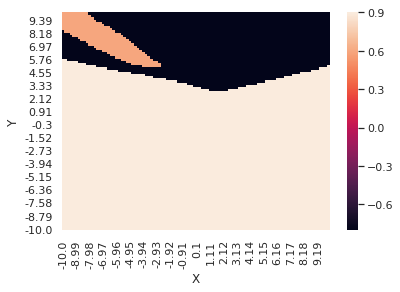

Return recorded for episode 173 :  826.167545746025
0.040499336922423565


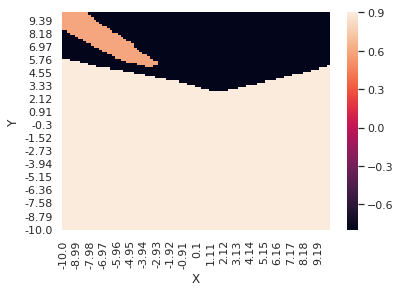

Return recorded for episode 174 :  812.9226466795731
0.039895409588095315


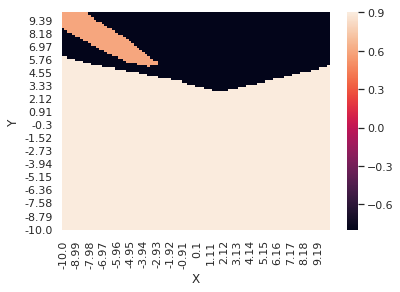

Return recorded for episode 175 :  817.6138875630753
0.03930344081621308


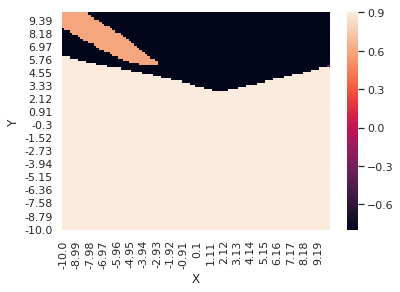

Return recorded for episode 176 :  808.2632791596709
0.03872319381137508


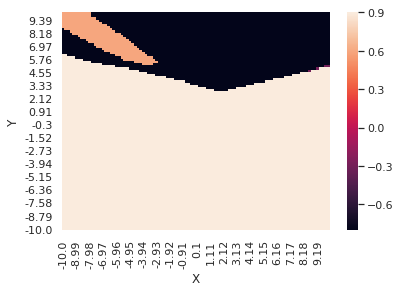

Return recorded for episode 177 :  806.8534766699062
0.03815443646704266


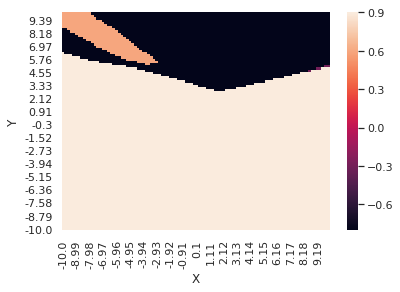

Return recorded for episode 178 :  813.3771100470115
0.03759694127269454


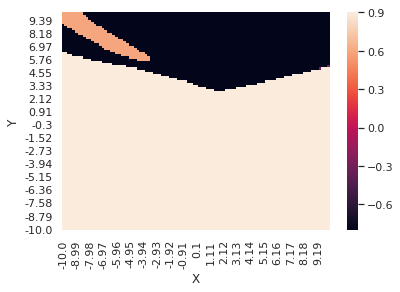

Return recorded for episode 179 :  810.9965420744305
0.03705048522281963


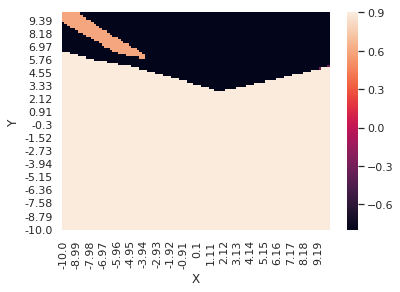

Return recorded for episode 180 :  816.20624650494
Episode 80 ..180   Avg reward: 812.1993868029333   Epsilon: 0.0371
0.036514849727711796


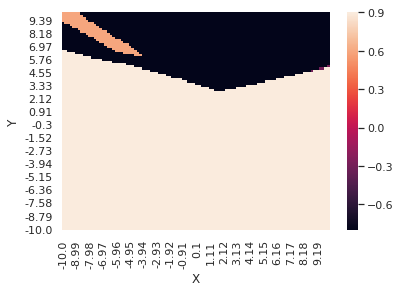

Return recorded for episode 181 :  822.4765716689197
0.03598982052603108


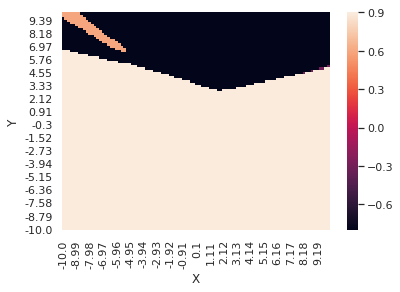

Return recorded for episode 182 :  820.4543121899653
0.03547518759909634


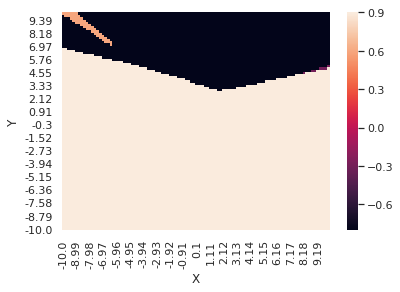

Return recorded for episode 183 :  819.870483589115
0.03497074508687494


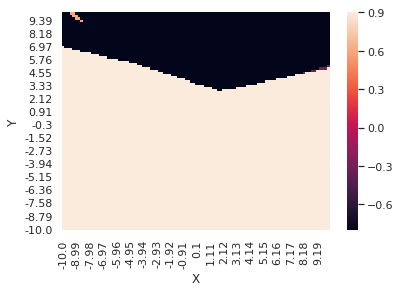

Return recorded for episode 184 :  821.4250649502119
0.034476291205635994


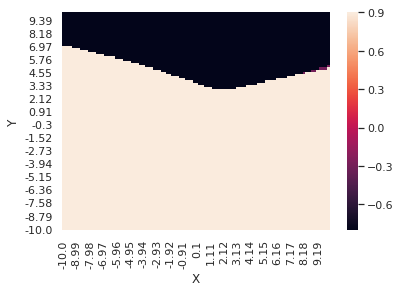

Return recorded for episode 185 :  815.7075147089201
0.0339916281672342


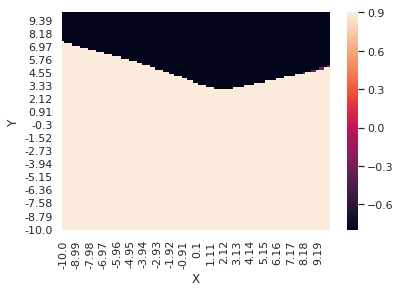

Return recorded for episode 186 :  820.4055950711254
0.033516562099991945


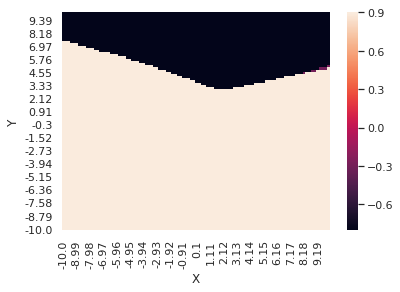

Return recorded for episode 187 :  886.7854598325403
0.03305090297114803


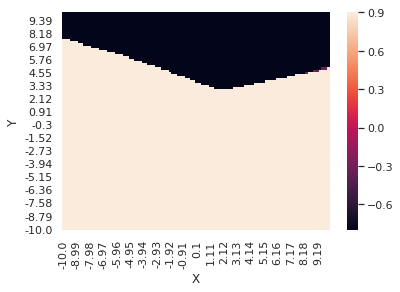

Return recorded for episode 188 :  892.8378749337048
0.03259446451084204


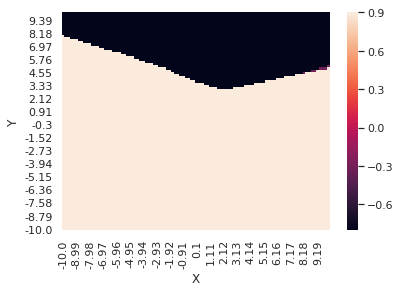

Return recorded for episode 189 :  825.8795548744764
0.03214706413760394


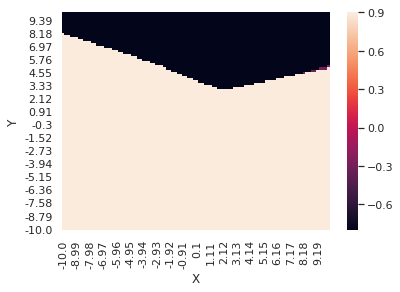

Return recorded for episode 190 :  820.3279954357586
Episode 90 ..190   Avg reward: 834.204867832392   Epsilon: 0.0321
0.031708522885318995


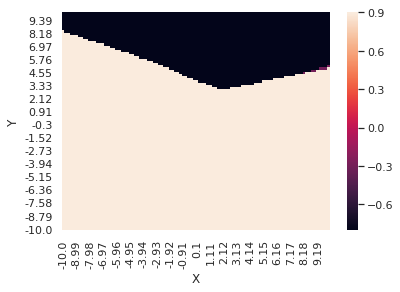

Return recorded for episode 191 :  824.4626468743116
0.031278665331639026


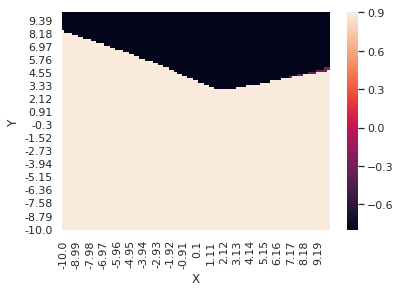

Return recorded for episode 192 :  817.7799968892832
0.030857319527811018


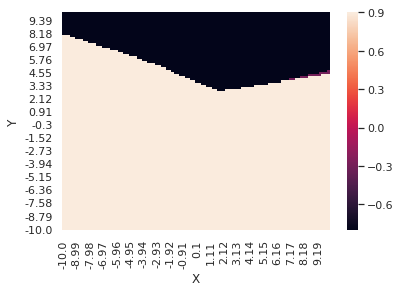

Return recorded for episode 193 :  761.6852895042736
0.030444316929895437


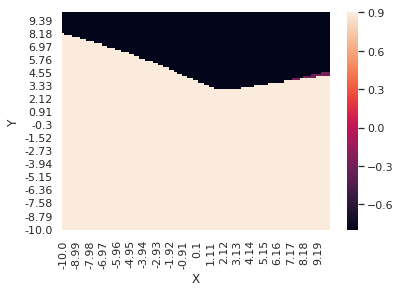

Return recorded for episode 194 :  821.3779116731736
0.030039492331346347


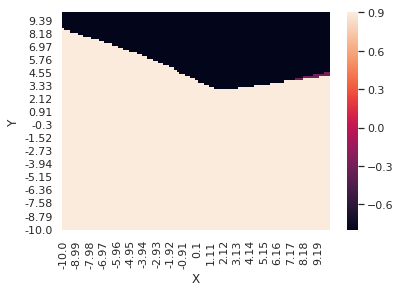

Return recorded for episode 195 :  816.7705888579912
0.029642683796926583


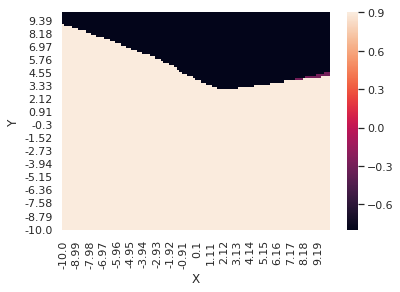

Return recorded for episode 196 :  825.6729612336645
0.029253732597931535


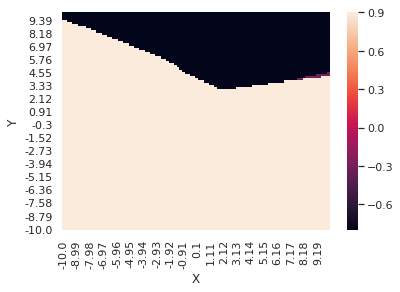

Return recorded for episode 197 :  819.3502695470025
0.02887248314869552


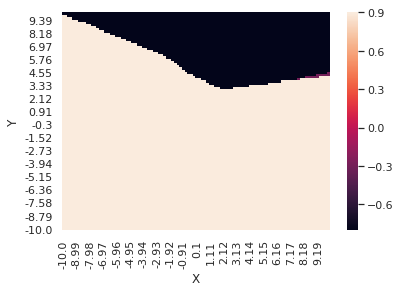

Return recorded for episode 198 :  821.2519178276377
0.02849878294435545


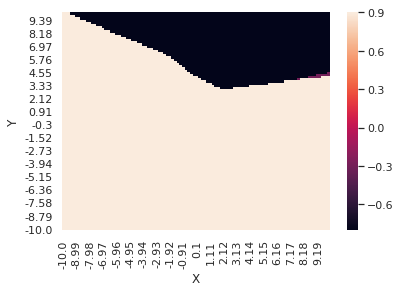

Return recorded for episode 199 :  818.2498347988139
0.028132482499846838


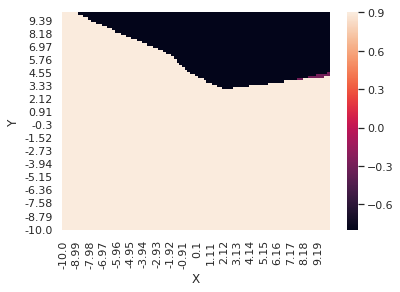

Return recorded for episode 200 :  821.8194482822432
Episode 100 ..200   Avg reward: 814.6929412641911   Epsilon: 0.0281
0.02777343529010782


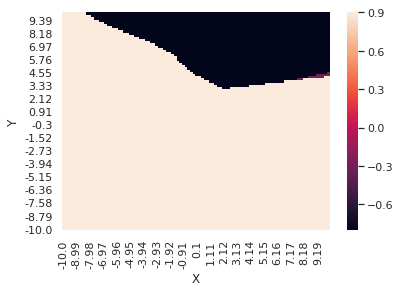

Return recorded for episode 201 :  845.8857770737505
0.027421497691467157


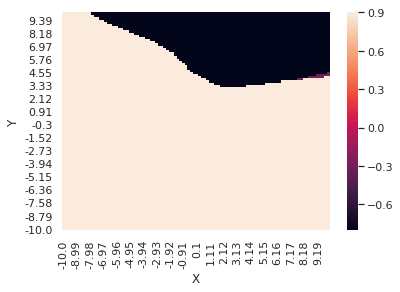

Return recorded for episode 202 :  813.1041895285001
0.0270765289241928


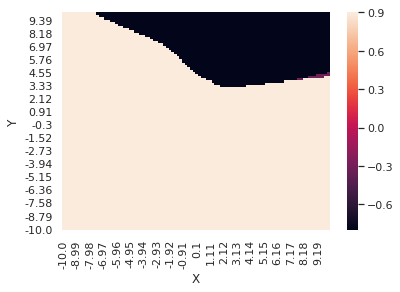

Return recorded for episode 203 :  821.3756723555838
0.026738390996178224


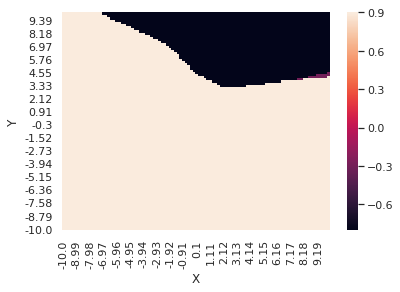

Return recorded for episode 204 :  834.9998366966712
0.026406948647743643


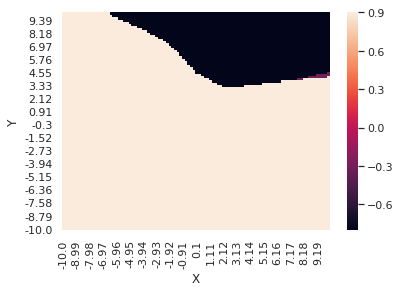

Return recorded for episode 205 :  829.5739394203608
0.026082069297530375


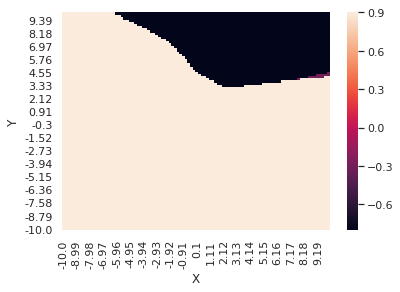

Return recorded for episode 206 :  841.2502843269706
0.025763622989466578


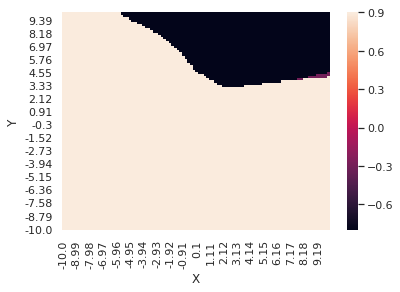

Return recorded for episode 207 :  827.7400819405973
0.025451482340783003


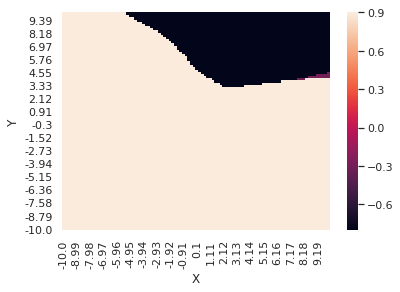

Return recorded for episode 208 :  817.9936310659496
0.025145522491058264


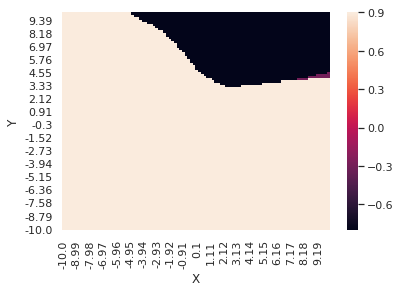

Return recorded for episode 209 :  818.5032985027842
0.024845621052272927


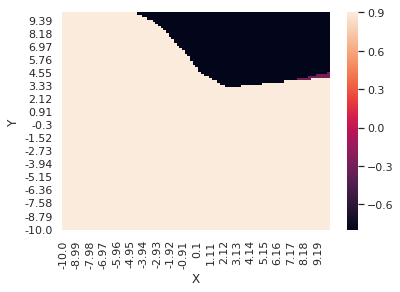

Return recorded for episode 210 :  831.362520856836
Episode 110 ..210   Avg reward: 827.2246159193412   Epsilon: 0.0248
0.024551658059852766


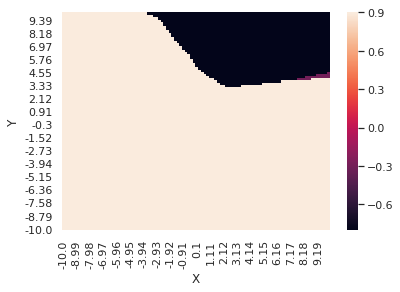

Return recorded for episode 211 :  824.7541820343757
0.024263515924681227


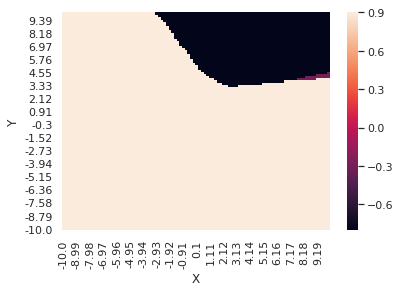

Return recorded for episode 212 :  838.2868363753478
0.023981079386062323


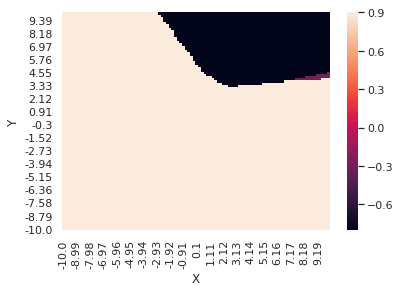

Return recorded for episode 213 :  838.8651601402302
0.023704235465614704


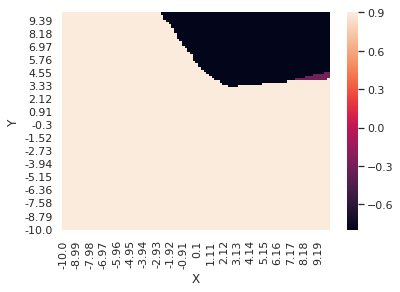

Return recorded for episode 214 :  826.4636824523926
0.023432873422078924


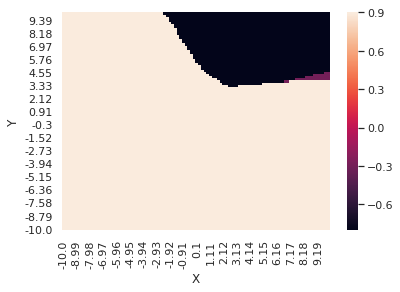

Return recorded for episode 215 :  808.0668592882672
0.02316688470701933


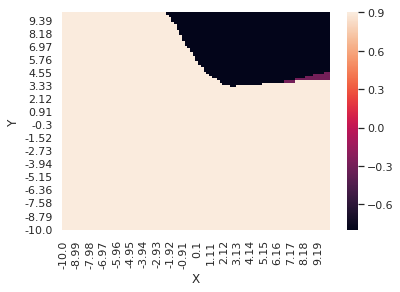

Return recorded for episode 216 :  835.9009702288529
0.022906162921403357


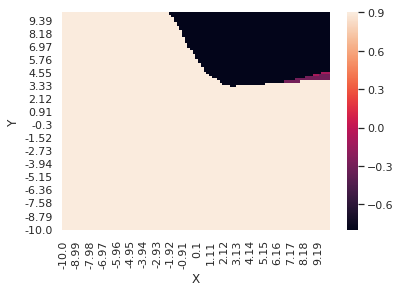

Return recorded for episode 217 :  837.6815915179025
0.0226506037730404


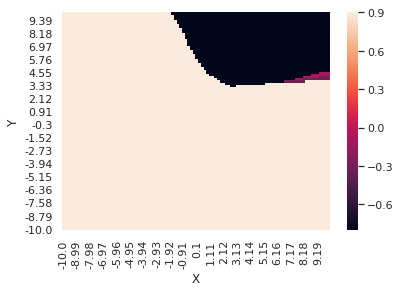

Return recorded for episode 218 :  827.3189052838205
0.022400105034863643


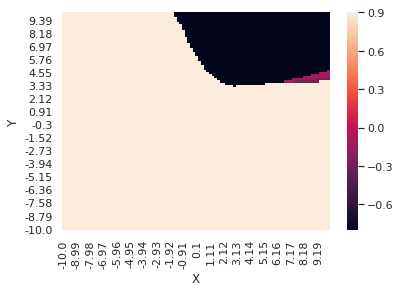

Return recorded for episode 219 :  837.5057404685584
0.02215456650403775


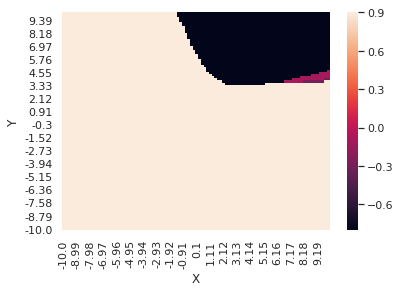

Return recorded for episode 220 :  845.9093877643077
Episode 120 ..220   Avg reward: 830.6206448646584   Epsilon: 0.0222
0.021913889961876536


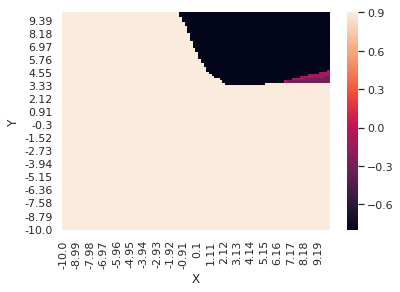

Return recorded for episode 221 :  837.8197111620948
0.02167797913455405


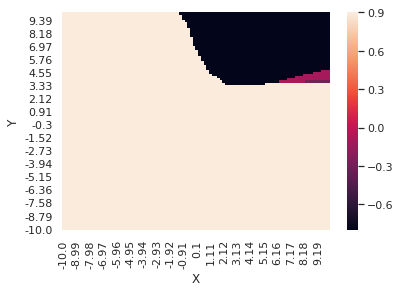

Return recorded for episode 222 :  829.9831006544341
0.02144673965459385


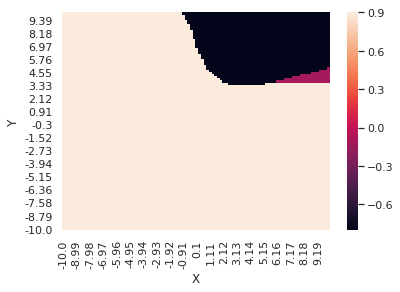

Return recorded for episode 223 :  838.3414790553469
0.021220079023120713


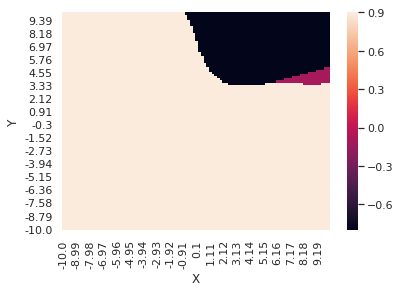

Return recorded for episode 224 :  846.3612751945104
0.02099790657285988


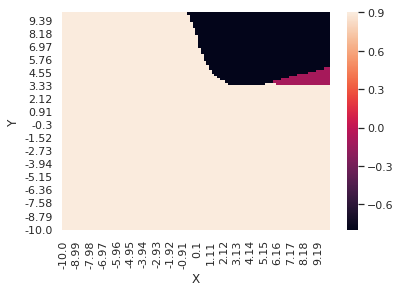

Return recorded for episode 225 :  840.5008133915508
0.020780133431868894


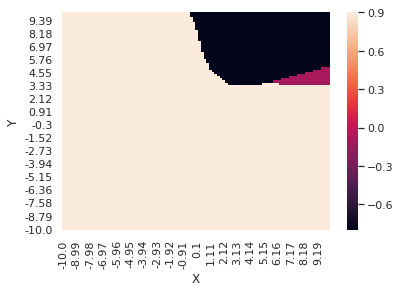

Return recorded for episode 226 :  842.4610897468249
0.020566672487987697


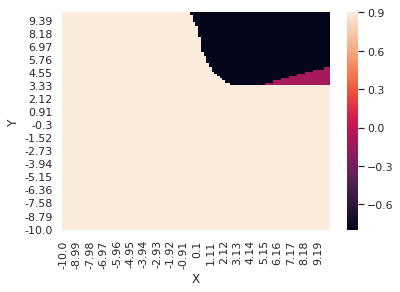

Return recorded for episode 227 :  836.3366752353201
0.02035743835399253


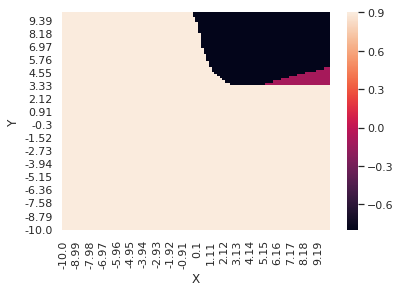

Return recorded for episode 228 :  845.1935679668527
0.02015234733343998


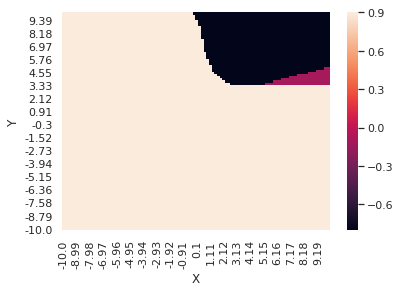

Return recorded for episode 229 :  842.8729689767723
0.01995131738718724


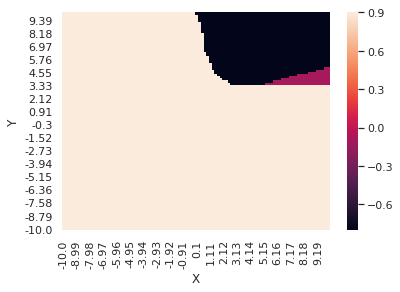

Return recorded for episode 230 :  839.2455347389712
Episode 130 ..230   Avg reward: 840.5780069148013   Epsilon: 0.0200
0.019754268100575387


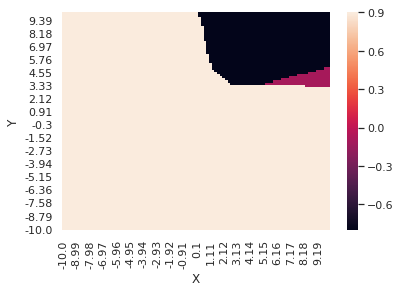

Return recorded for episode 231 :  845.2486847696381
0.0195611206512624


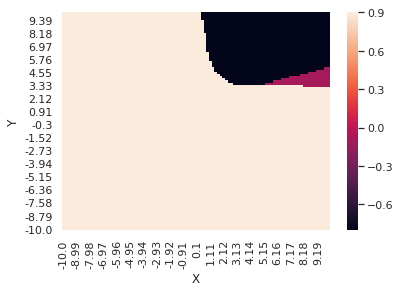

Return recorded for episode 232 :  849.8284333434924
0.01937179777769322


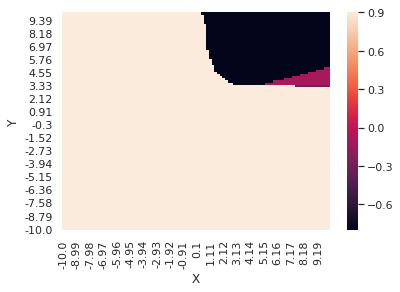

Return recorded for episode 233 :  864.2291289667635
0.019186223748194096


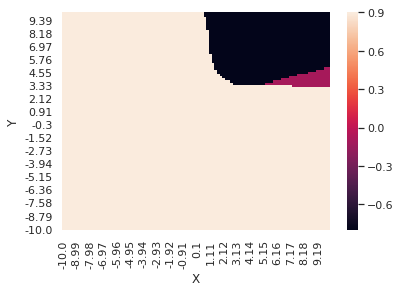

Return recorded for episode 234 :  874.7126782695882
0.019004324330678855


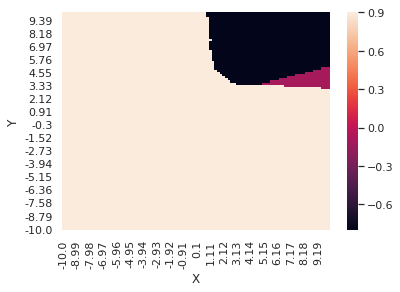

Return recorded for episode 235 :  857.6990117022635
0.01882602676295516


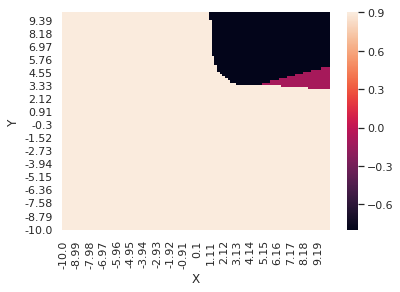

Return recorded for episode 236 :  1111.4427531804624
0.018651259723618557


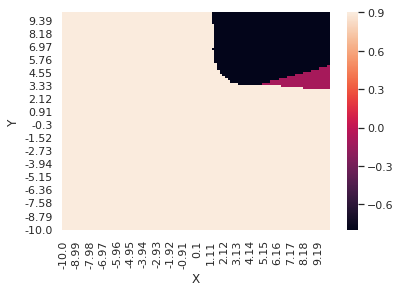

Return recorded for episode 237 :  5072.407332016769
0.018479953303523082


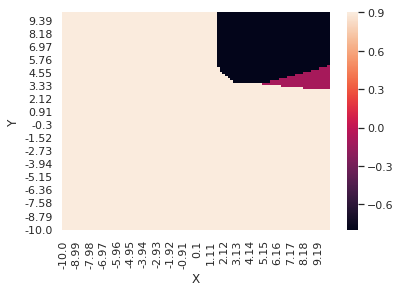

Return recorded for episode 238 :  5005.579931444357
0.018312038977816556


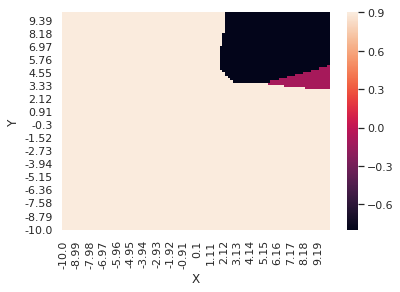

Return recorded for episode 239 :  4975.526492960225
0.01814744957852983


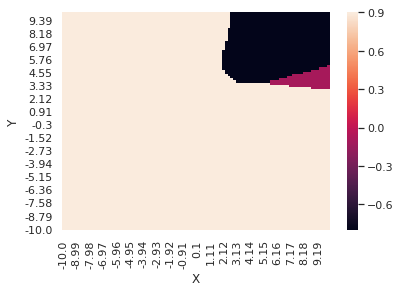

Return recorded for episode 240 :  5009.253824257999
Episode 140 ..240   Avg reward: 2129.591998139253   Epsilon: 0.0181
0.01798611926770862


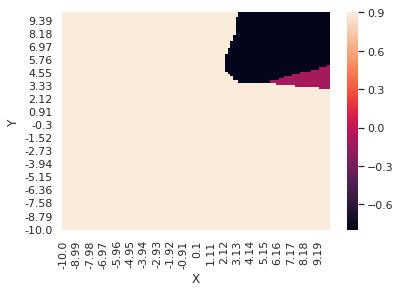

Return recorded for episode 241 :  5011.0456942144765
0.017827983511077505


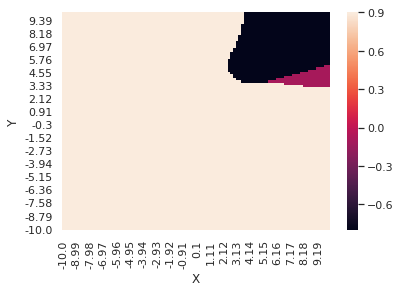

Return recorded for episode 242 :  4948.977220552546
0.017672979052225327


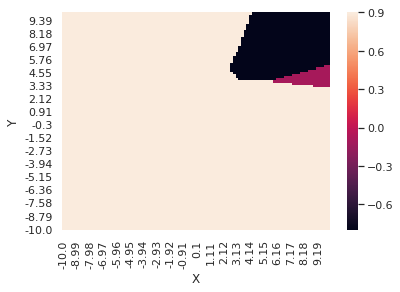

Return recorded for episode 243 :  5040.121348004559
0.01752104388730179


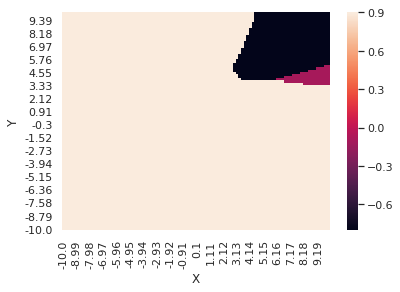

Return recorded for episode 244 :  5006.746551184295
0.017372117240215094


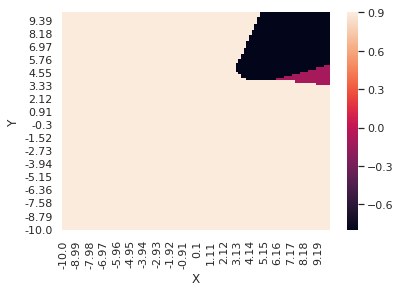

Return recorded for episode 245 :  4994.609588150628
0.0172261395383207


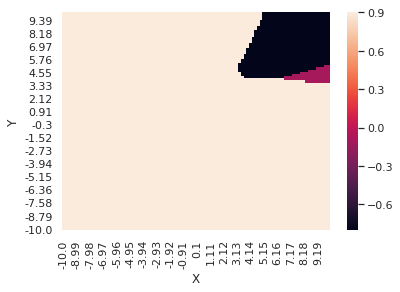

Return recorded for episode 246 :  4945.332007056575
0.017083052388591435


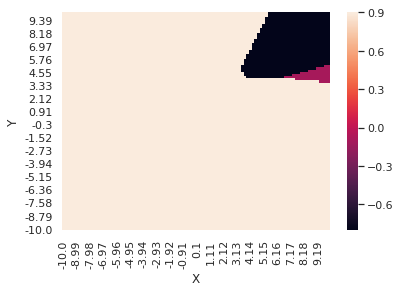

Return recorded for episode 247 :  5003.649509166945
0.01694279855425957


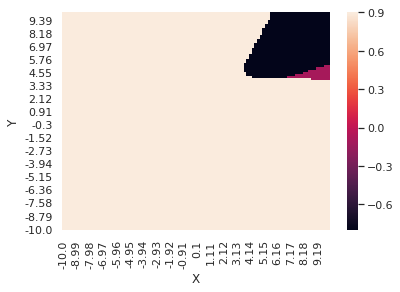

Return recorded for episode 248 :  5036.44404266659
0.016805321931921285


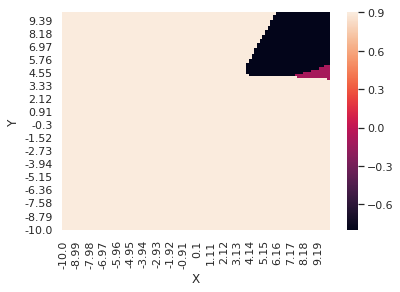

Return recorded for episode 249 :  5002.478634335569
0.016670567529094613


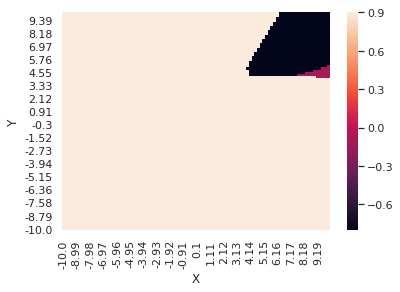

Return recorded for episode 250 :  5002.217133972435
Episode 150 ..250   Avg reward: 4999.865841959017   Epsilon: 0.0167
0.016538481442221656


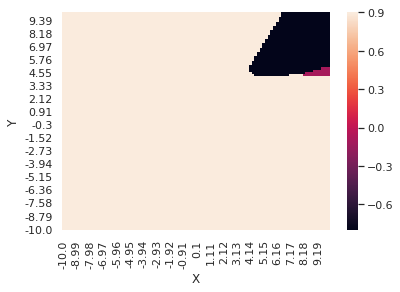

Return recorded for episode 251 :  4911.800633852732
0.01640901083510651


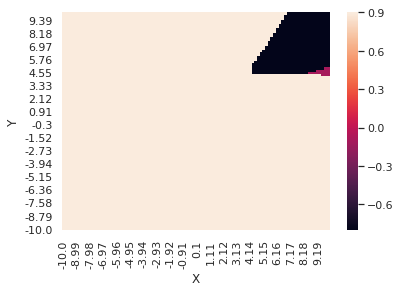

Return recorded for episode 252 :  5041.161319715531
0.016282103917780018


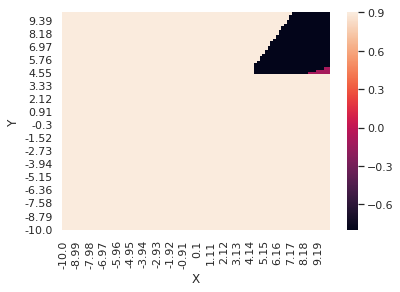

Return recorded for episode 253 :  4984.380755562529
0.016157709925783147


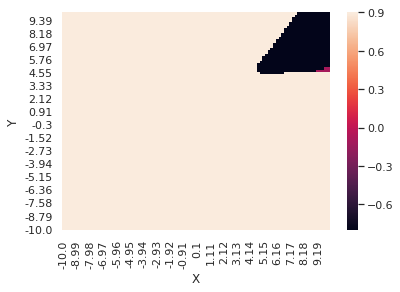

Return recorded for episode 254 :  5012.216761511819
0.016035779099860478


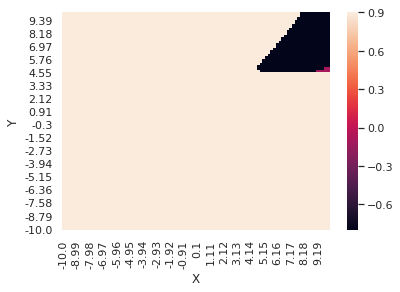

Return recorded for episode 255 :  4937.313511741901
0.015916262666055885


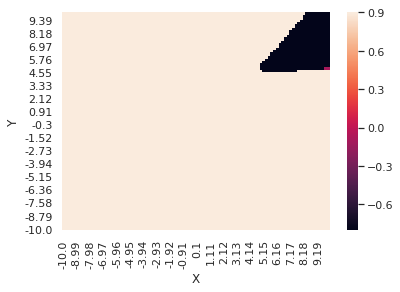

Return recorded for episode 256 :  4958.728890114069
0.015799112816202266


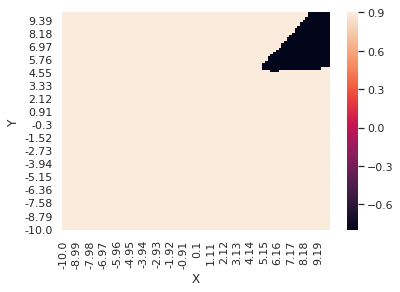

Return recorded for episode 257 :  4971.85018909947
0.01568428268879766


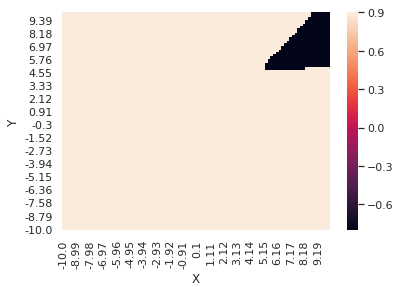

Return recorded for episode 258 :  4917.745411835067
0.015571726350260025


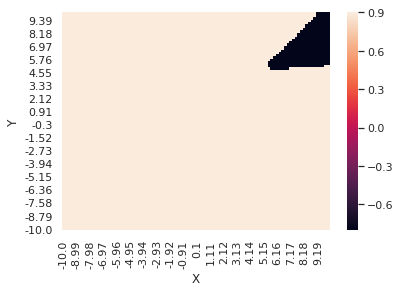

Return recorded for episode 259 :  5063.869073867321
0.015461398776553163


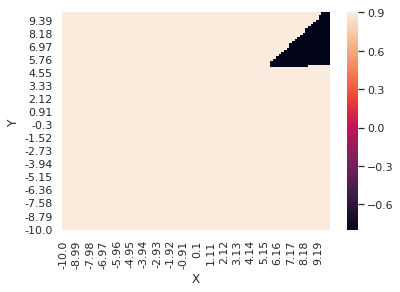

Return recorded for episode 260 :  5013.6412762898935
Episode 160 ..260   Avg reward: 4980.128368127288   Epsilon: 0.0155
0.01535325583517655


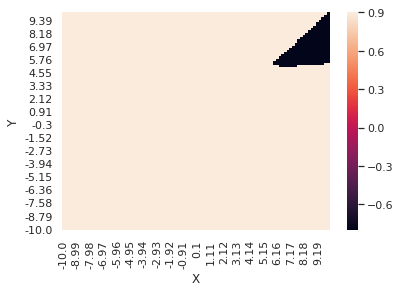

Return recorded for episode 261 :  4958.9253229302385
0.015247254267511699


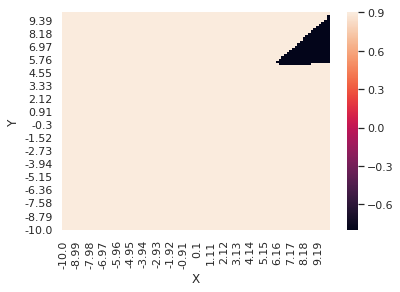

Return recorded for episode 262 :  4971.211413524001
0.015143351671518179


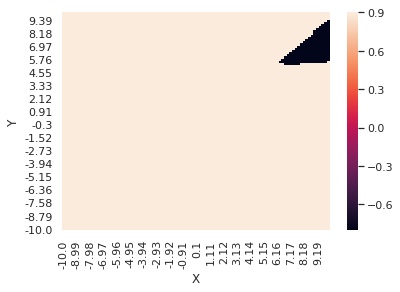

Return recorded for episode 263 :  5050.574529651076
0.015041506484772198


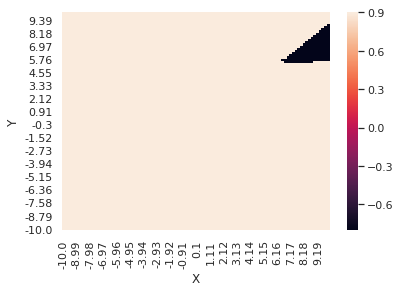

Return recorded for episode 264 :  5035.06630114334
0.014941677967841115


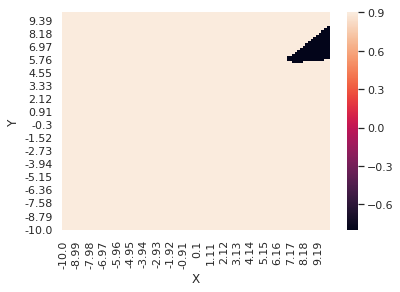

Return recorded for episode 265 :  5003.289562410646
0.014843826187987082


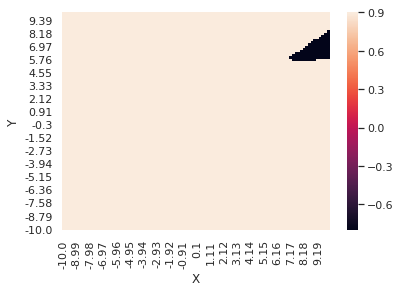

Return recorded for episode 266 :  4998.924201584769
0.014747912003193458


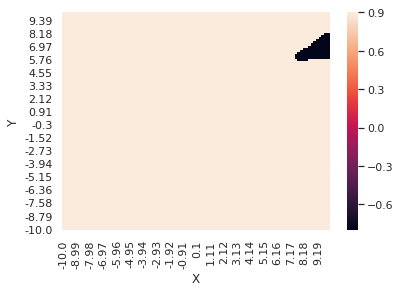

Return recorded for episode 267 :  4993.790657629178
0.014653897046507443


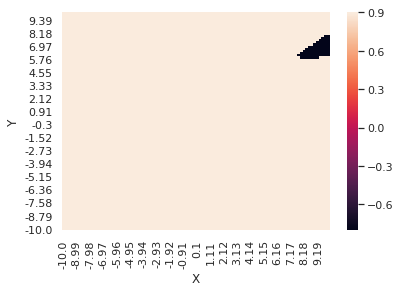

Return recorded for episode 268 :  5016.294043698666
0.014561743710692824


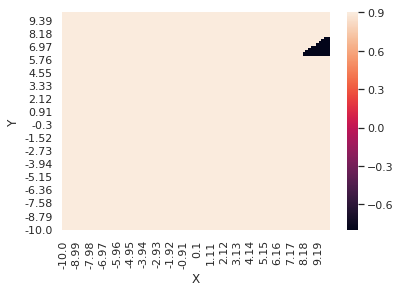

Return recorded for episode 269 :  4991.014175387633
0.01447141513318654


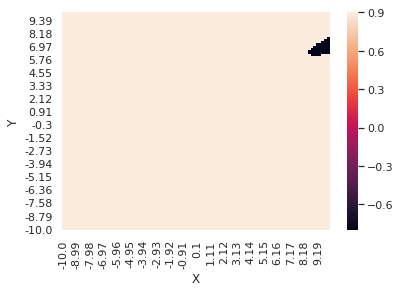

Return recorded for episode 270 :  4987.863239540099
Episode 170 ..270   Avg reward: 5003.273148424943   Epsilon: 0.0145
0.014382875181353196


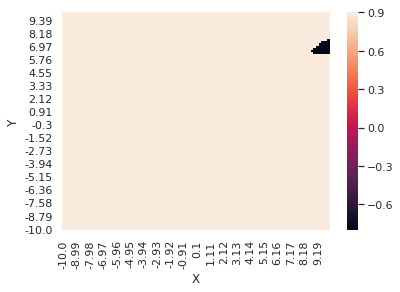

Return recorded for episode 271 :  4963.804354685167
0.014296088438031505


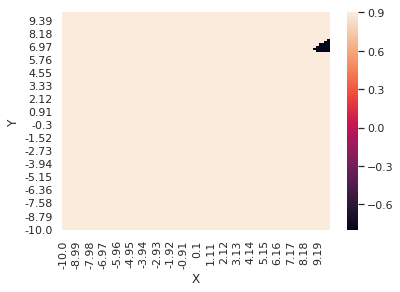

Return recorded for episode 272 :  4939.726764756736
0.014211020187366974


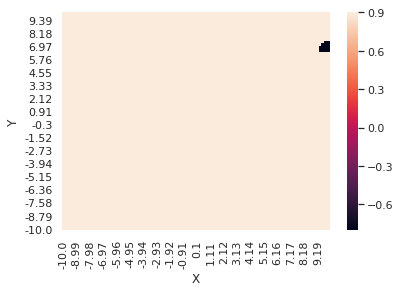

Return recorded for episode 273 :  5064.945449678253
0.01412763640092507


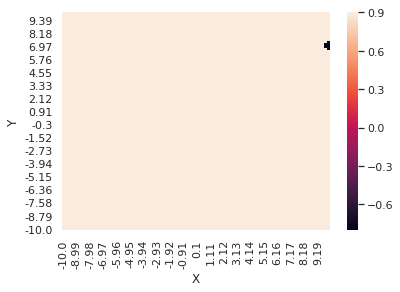

Return recorded for episode 274 :  4959.268664961461
0.014045903724079427


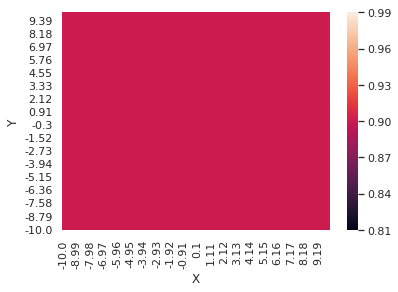

Return recorded for episode 275 :  5011.961663310056
0.013965789462669513


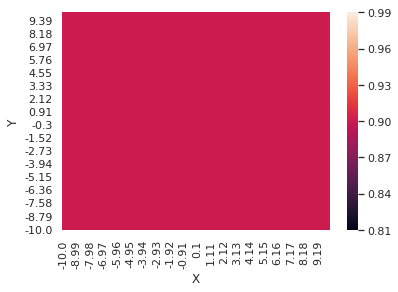

Return recorded for episode 276 :  5023.421312031492
0.013887261569922569


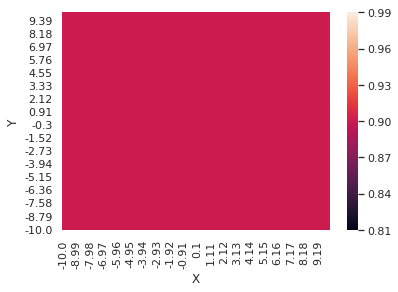

Return recorded for episode 277 :  5020.004811411423
0.013810288633634434


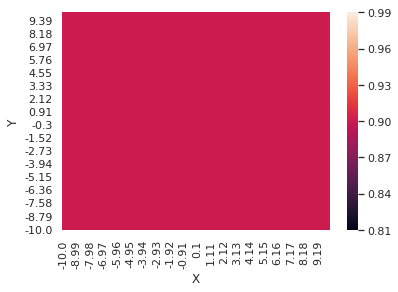

Return recorded for episode 278 :  5021.083407512798
0.013734839863604284


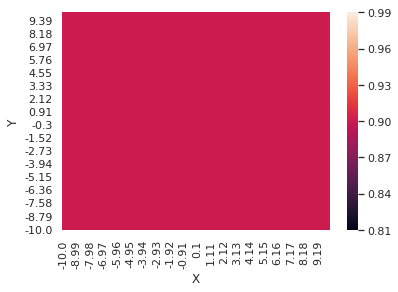

Return recorded for episode 279 :  5042.208603440895
0.0136608850793181


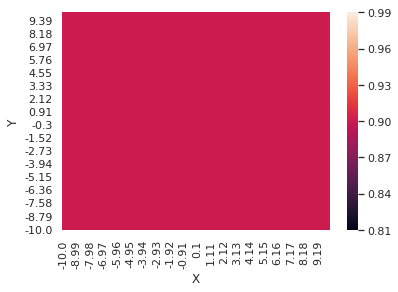

Return recorded for episode 280 :  5006.382734681951
Episode 180 ..280   Avg reward: 5003.428827132839   Epsilon: 0.0137
0.013588394697876097


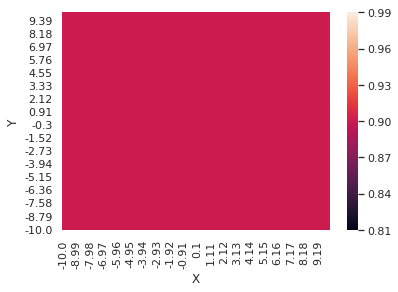

Return recorded for episode 281 :  5012.7367987060015
0.013517339722159148


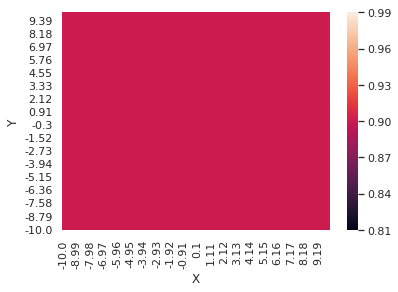

Return recorded for episode 282 :  5047.952761257163
0.013447691729229546


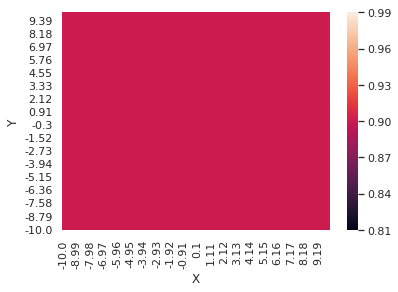

Return recorded for episode 283 :  5017.79499674539
0.013379422858961477


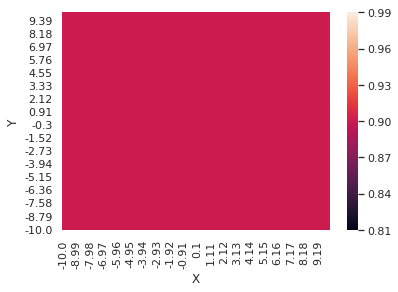

Return recorded for episode 284 :  5048.056452960056
0.01331250580289656


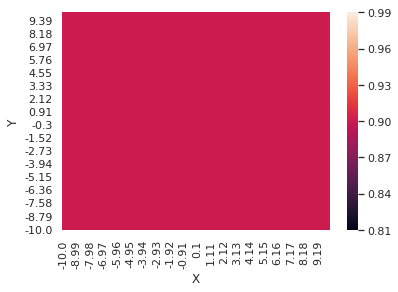

Return recorded for episode 285 :  5011.987997036012
0.013246913793320138


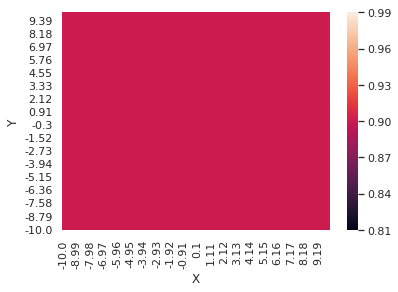

Return recorded for episode 286 :  5042.480810055366
0.013182620592553802


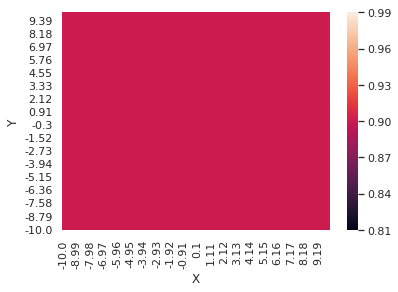

Return recorded for episode 287 :  4998.181147695105
0.013119600482459998


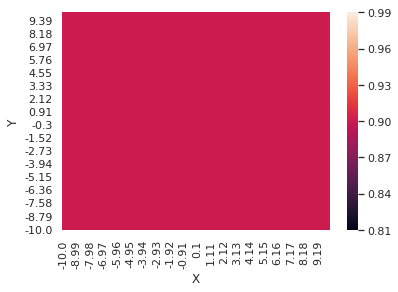

Return recorded for episode 288 :  5012.5852949376795
0.013057828254154401


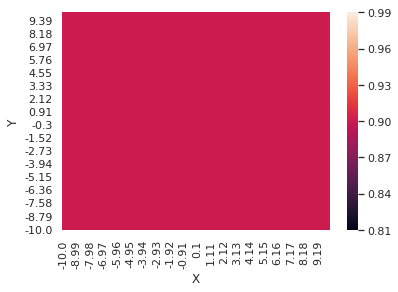

Return recorded for episode 289 :  4953.581426622934
0.012997279197922058


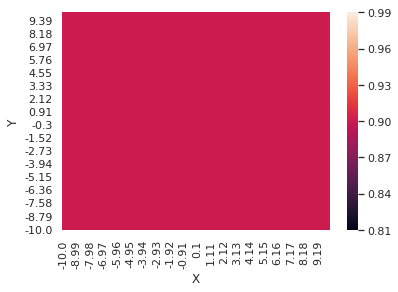

Return recorded for episode 290 :  4989.774676128477
Episode 190 ..290   Avg reward: 5015.174042069766   Epsilon: 0.0130
0.012937929093333135


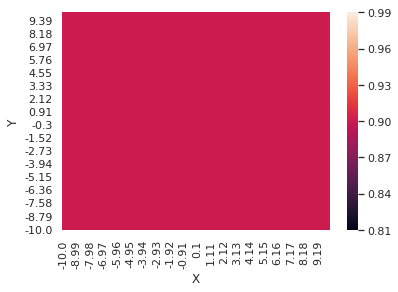

Return recorded for episode 291 :  4977.9884326106385
0.012879754199554458


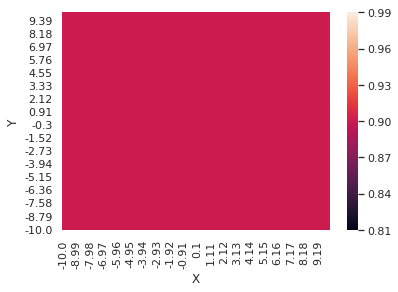

Return recorded for episode 292 :  4954.158045841925
0.012822731245852837


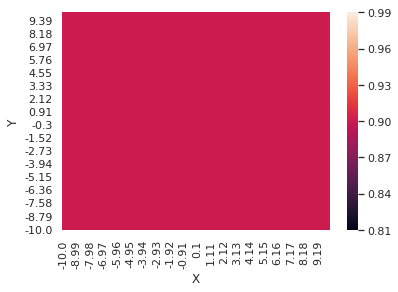

Return recorded for episode 293 :  5008.63452943988
0.012766837422286476


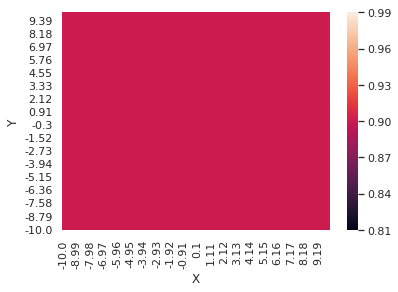

Return recorded for episode 294 :  5004.564284140466
0.012712050370580685


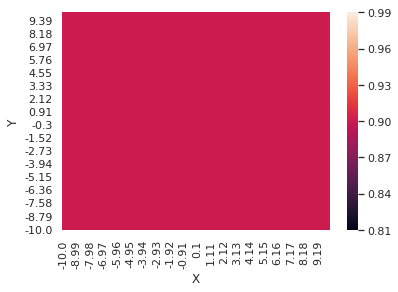

Return recorded for episode 295 :  5015.872173718995
0.012658348175184284


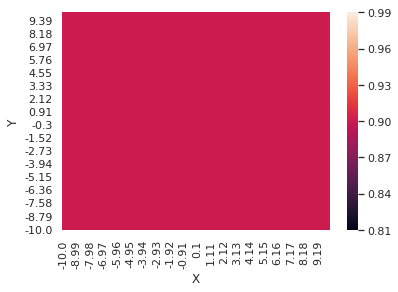

Return recorded for episode 296 :  5027.885531616098
0.012605709354503067


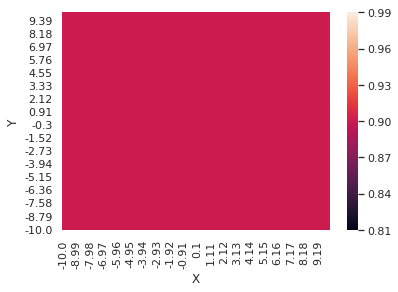

Return recorded for episode 297 :  4965.281506126711
0.012554112852306908


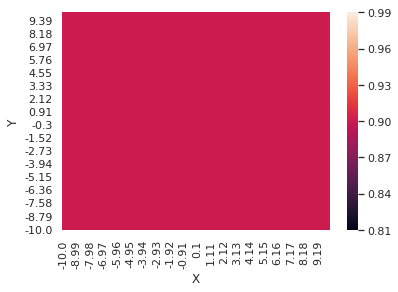

Return recorded for episode 298 :  4979.794076804856
0.012503538029306963


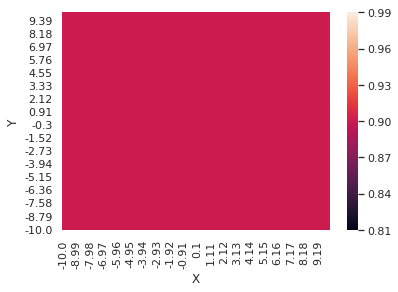

Return recorded for episode 299 :  5011.243954850102
0.012453964654899695


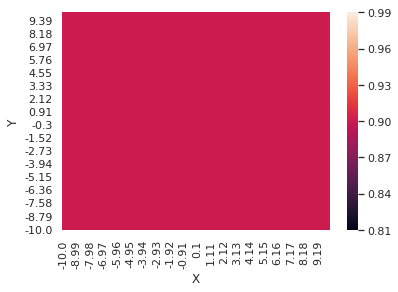

Return recorded for episode 300 :  4970.55289308758
Episode 200 ..300   Avg reward: 4993.5197211278155   Epsilon: 0.0125
0.01240537289907435


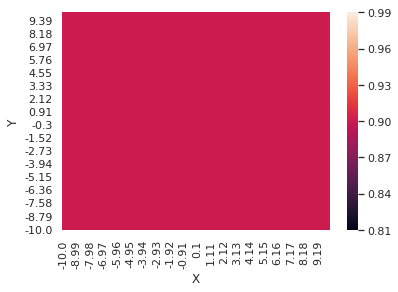

Return recorded for episode 301 :  5063.115143824253
0.012357743324480702


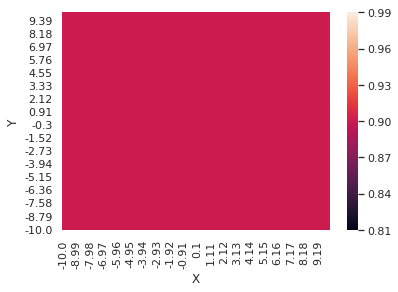

Return recorded for episode 302 :  4966.174192935165
0.012311056878653841


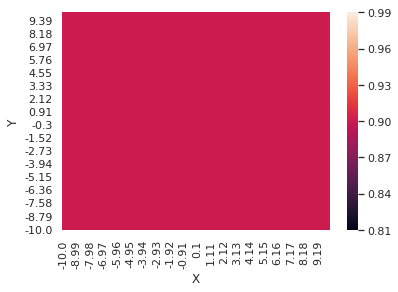

Return recorded for episode 303 :  5017.115230963271
0.012265294886392948


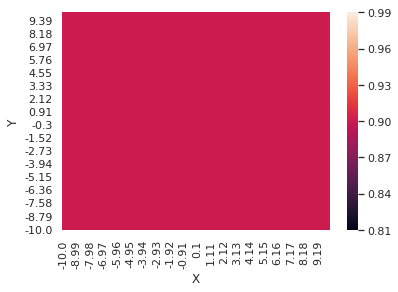

Return recorded for episode 304 :  5044.782225071672
0.012220439042290943


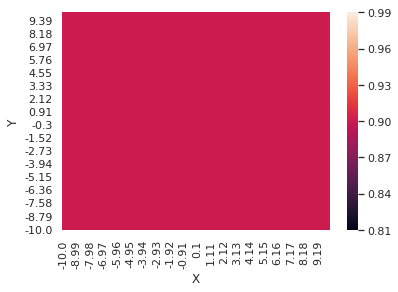

Return recorded for episode 305 :  5046.055427694983
0.012176471403412107


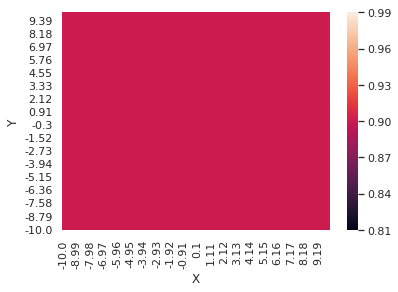

Return recorded for episode 306 :  5000.598067783018
0.012133374382114637


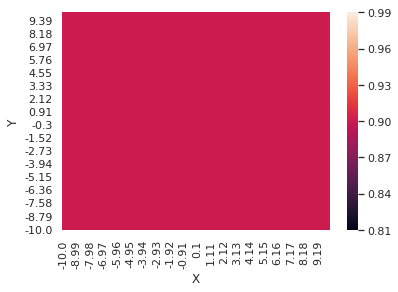

Return recorded for episode 307 :  4974.84429655011
0.012091130739015387


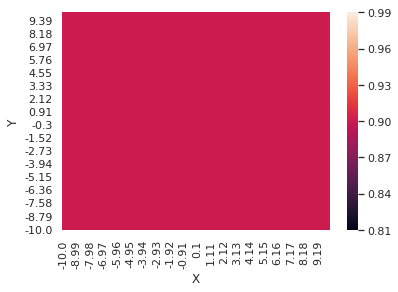

Return recorded for episode 308 :  5067.695265767126
0.012049723576093858


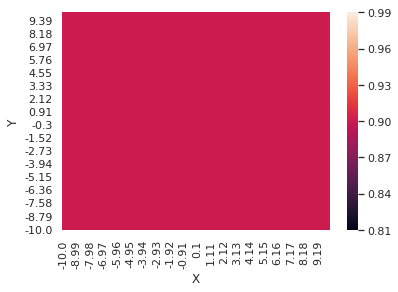

Return recorded for episode 309 :  4880.3121787488635
0.012009136329932777


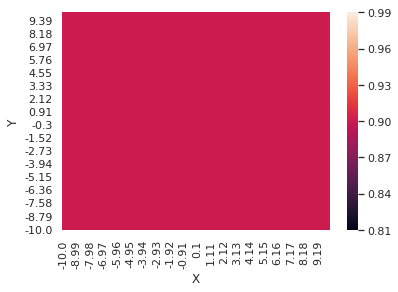

Return recorded for episode 310 :  4998.245448258931
Episode 210 ..310   Avg reward: 5003.124492242604   Epsilon: 0.0120
0.011969352765092513


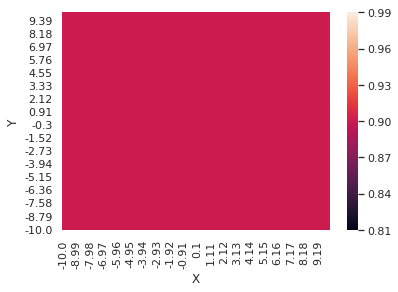

Return recorded for episode 311 :  5014.126202092189
0.01193035696761667


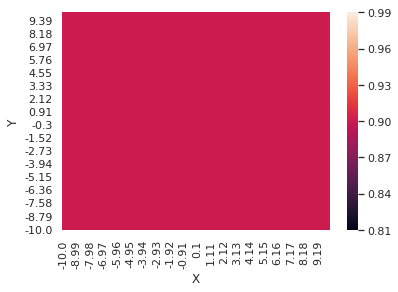

Return recorded for episode 312 :  4997.46117608358
0.011892133338666311


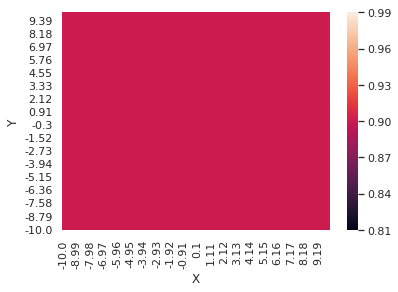

Return recorded for episode 313 :  5035.485610613944
0.011854666588280199


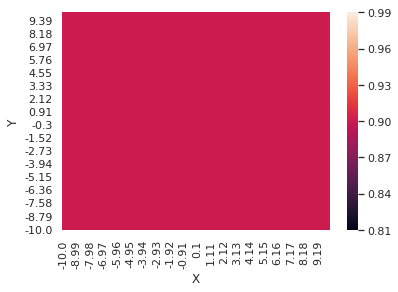

Return recorded for episode 314 :  4997.076748553883
0.011817941729258619


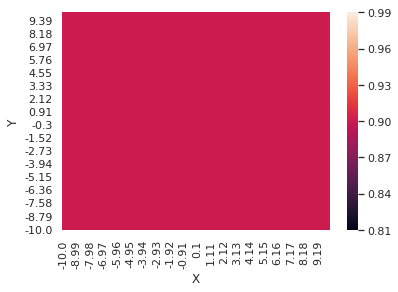

Return recorded for episode 315 :  4990.1251418347465
0.011781944071168286


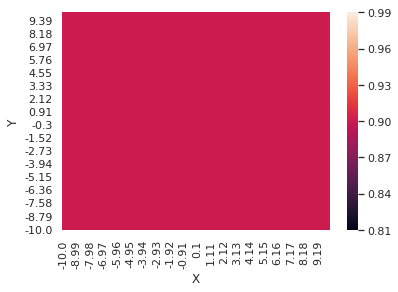

Return recorded for episode 316 :  5045.028878260416
0.011746659214465993


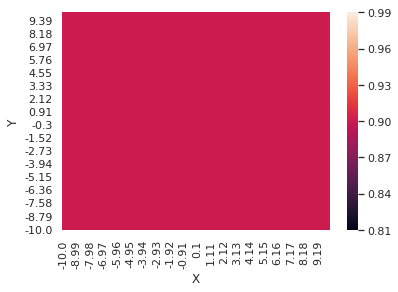

Return recorded for episode 317 :  5019.76025573083
0.011712073044738584


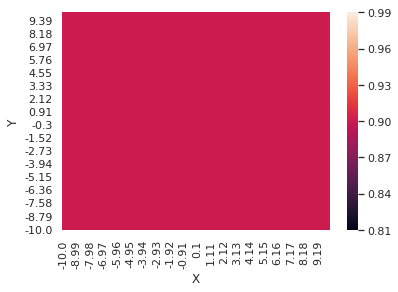

Return recorded for episode 318 :  4996.5598744795225
0.011678171727057018


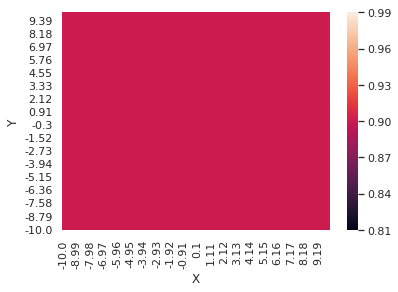

Return recorded for episode 319 :  4966.12131656536
0.011644941700442194


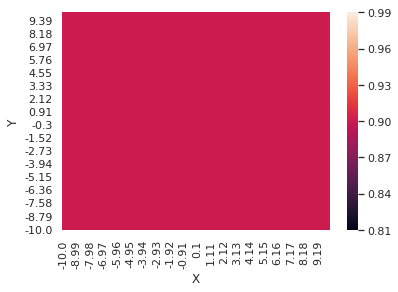

Return recorded for episode 320 :  5058.7744781326965
Episode 220 ..320   Avg reward: 5005.99906524734   Epsilon: 0.0116
0.011612369672440398


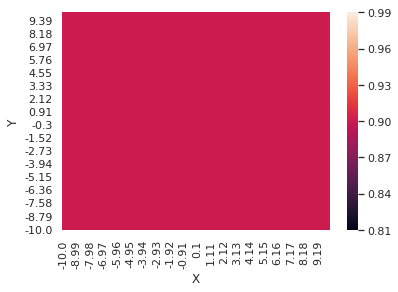

Return recorded for episode 321 :  5006.713258247682
0.011580442613806126


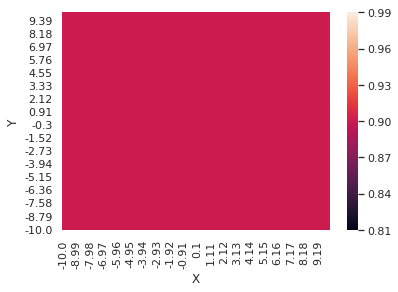

Return recorded for episode 322 :  4995.371879940829
0.011549147753290225


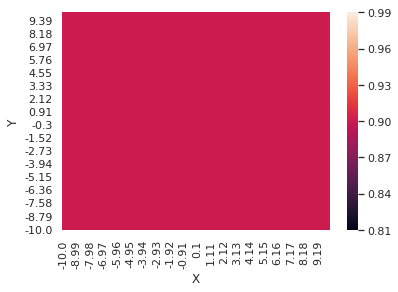

Return recorded for episode 323 :  5025.8189184048
0.011518472572531219


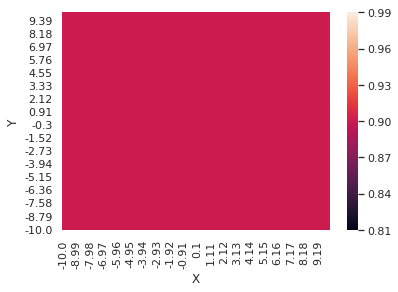

Return recorded for episode 324 :  4977.069400633428
0.011488404801047796


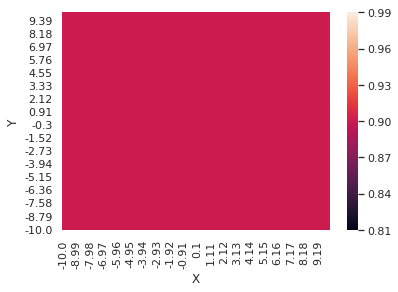

Return recorded for episode 325 :  5065.06888488081
0.011458932411330456


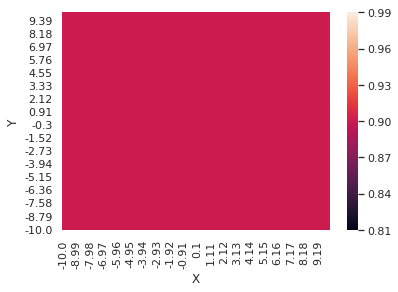

Return recorded for episode 326 :  4965.48641047579
0.011430043614030338


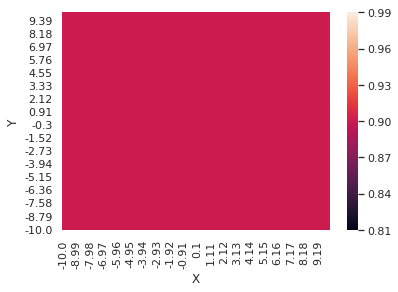

Return recorded for episode 327 :  5010.766779900075
0.011401726853243335


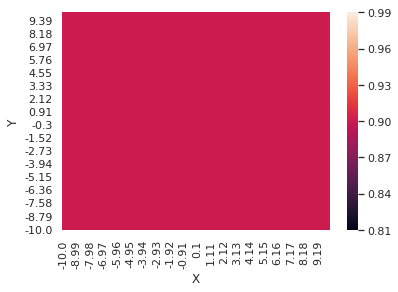

Return recorded for episode 328 :  5068.24505747963
0.011373970801887569


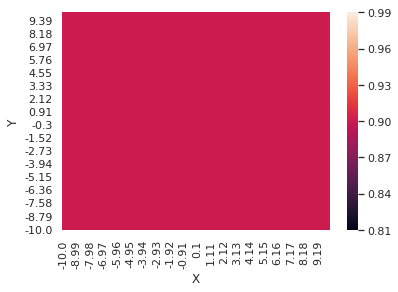

Return recorded for episode 329 :  4988.865718814795
0.011346764357172414


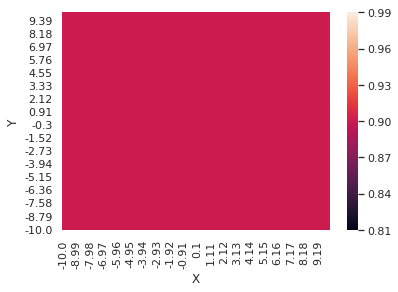

Return recorded for episode 330 :  5037.495644922232
Episode 230 ..330   Avg reward: 5016.218078691054   Epsilon: 0.0113
0.011320096636157226


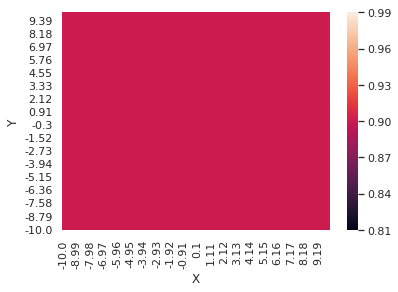

Return recorded for episode 331 :  4973.34043054265
0.011293956971398022


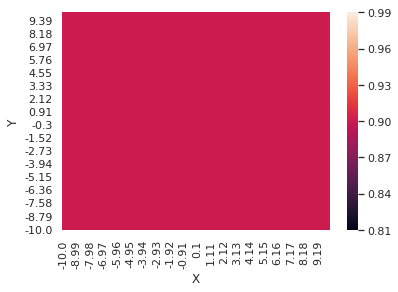

Return recorded for episode 332 :  5005.558128155571
0.01126833490668037


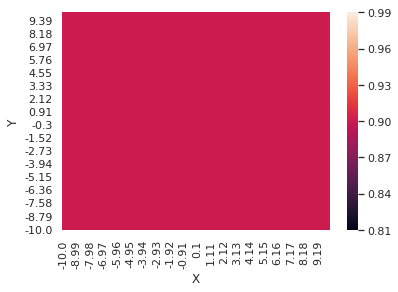

Return recorded for episode 333 :  5031.404633767582
0.011243220192836747


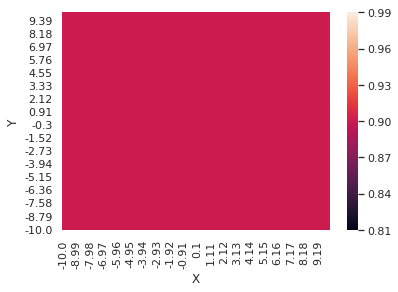

Return recorded for episode 334 :  5025.146119146445
0.011218602783646746


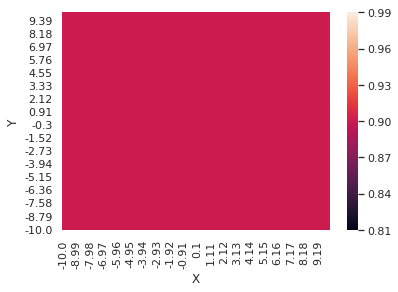

Return recorded for episode 335 :  5033.921246994535
0.01119447283181846


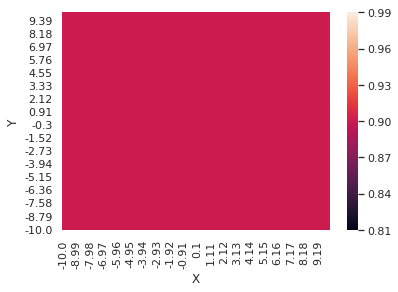

Return recorded for episode 336 :  5022.768328543131
0.011170820685049418


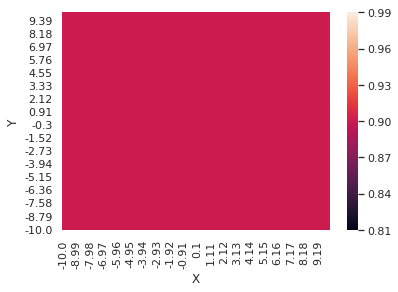

Return recorded for episode 337 :  5032.984974904931
0.011147636882165546


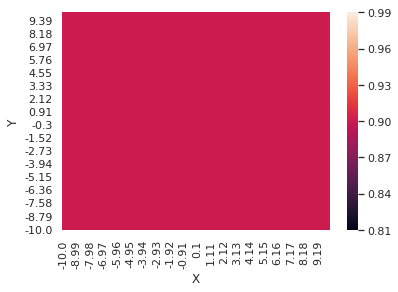

Return recorded for episode 338 :  5012.705602563869
0.011124912149336568


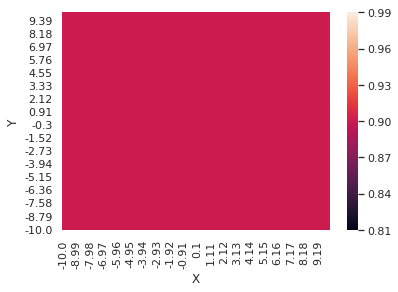

Return recorded for episode 339 :  5006.736839049708
0.011102637396366355


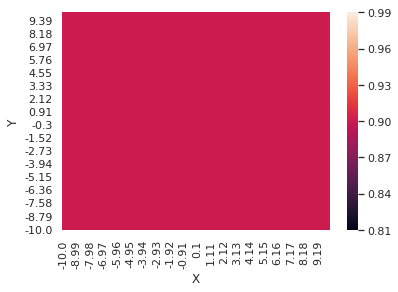

Return recorded for episode 340 :  5019.832189103307
Episode 240 ..340   Avg reward: 5018.206194859065   Epsilon: 0.0111
0.011080803713056716


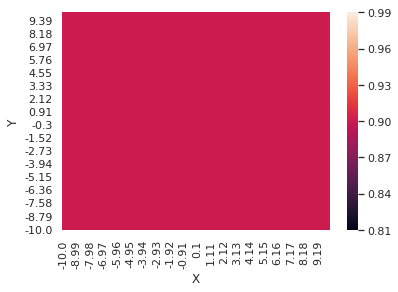

Return recorded for episode 341 :  4959.647541953658
0.011059402365643208


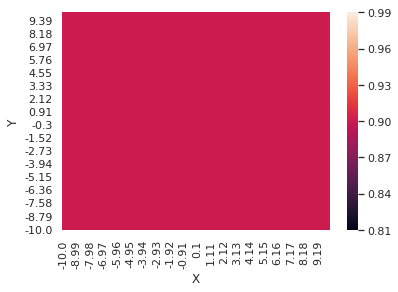

Return recorded for episode 342 :  4990.888980607435
0.011038424793301511


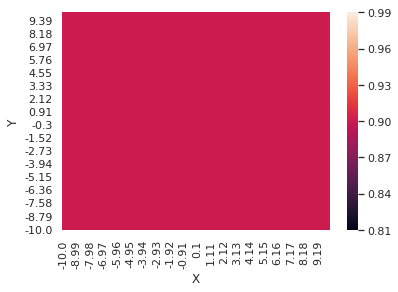

Return recorded for episode 343 :  5057.7931016553075
0.011017862604722983


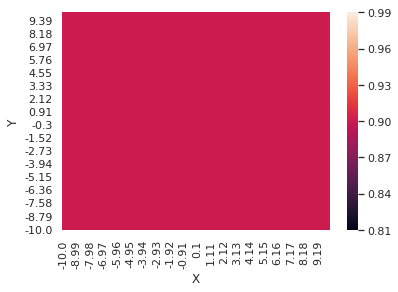

Return recorded for episode 344 :  5028.323519501666
0.010997707574758025


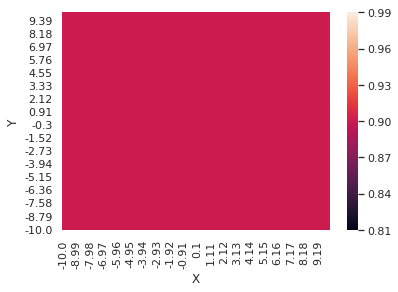

Return recorded for episode 345 :  5049.472568087191
0.010977951641125918


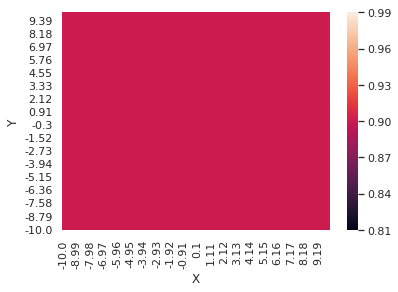

Return recorded for episode 346 :  4991.10839297465
0.010958586901189789


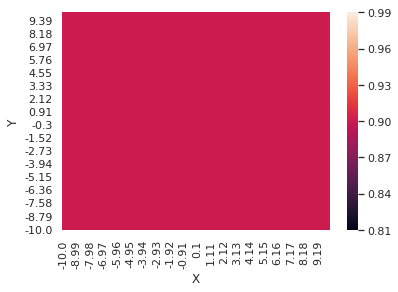

Return recorded for episode 347 :  4961.367028647311
0.010939605608795464


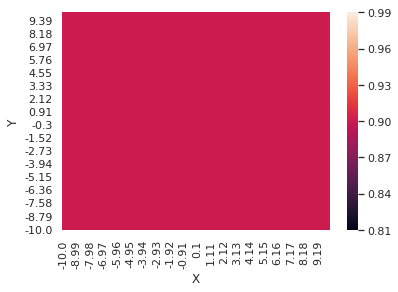

Return recorded for episode 348 :  4999.40128283372
0.010921000171172899


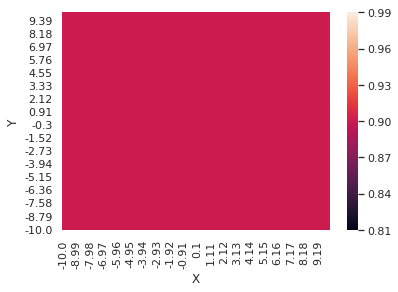

Return recorded for episode 349 :  5061.131354264662
0.010902763145898971


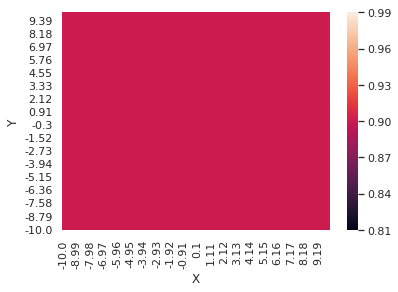

Return recorded for episode 350 :  4995.429394932723
Episode 250 ..350   Avg reward: 5011.896595962891   Epsilon: 0.0109
0.010884887237920403


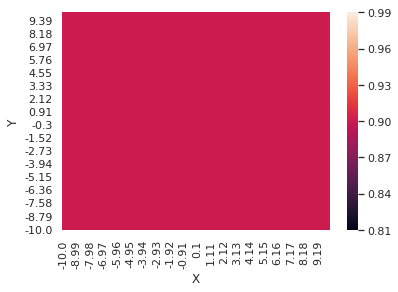

Return recorded for episode 351 :  4966.6096306512145
0.010867365296635659


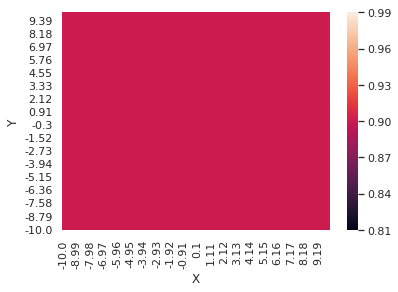

Return recorded for episode 352 :  5021.874762475847
0.010850190313034594


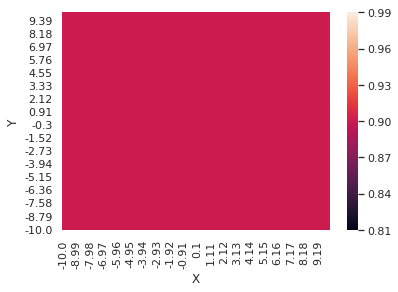

Return recorded for episode 353 :  5027.536529763835
0.010833355416894765


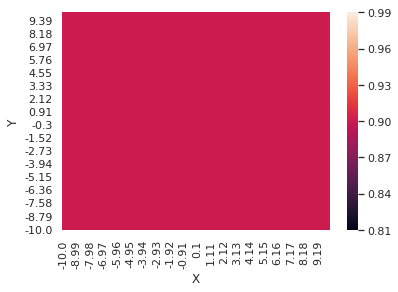

Return recorded for episode 354 :  5055.746101407302
0.010816853874033245


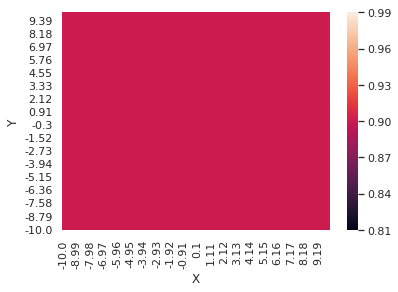

Return recorded for episode 355 :  5016.152733578696
0.01080067908361287


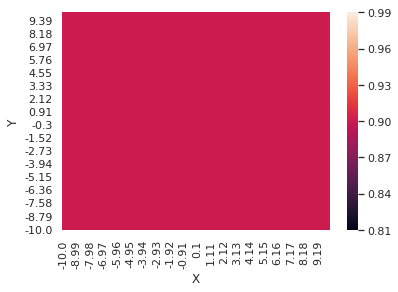

Return recorded for episode 356 :  5073.971112229657
0.010784824575501804


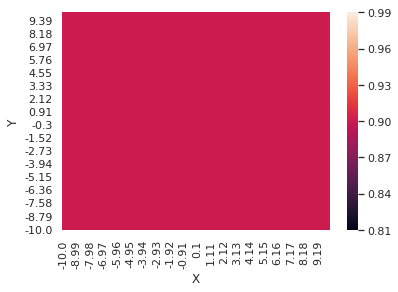

Return recorded for episode 357 :  5002.132598326359
0.010769284007685407


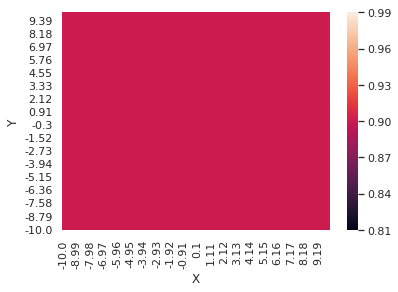

Return recorded for episode 358 :  5040.234368000062
0.01075405116372934


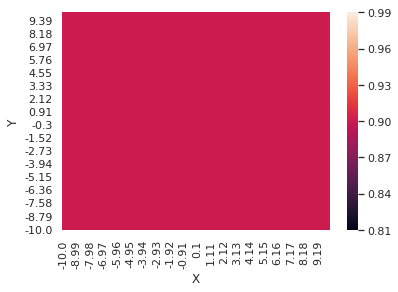

Return recorded for episode 359 :  5052.3430136152
0.010739119950292912


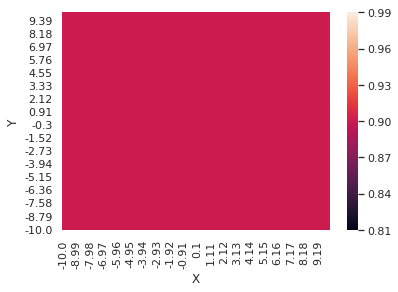

Return recorded for episode 360 :  5062.5396049299625
Episode 260 ..360   Avg reward: 5025.20302449809   Epsilon: 0.0107
0.010724484394691668


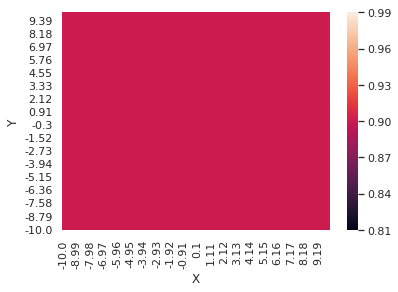

Return recorded for episode 361 :  4988.160391846518
0.010710138642508221


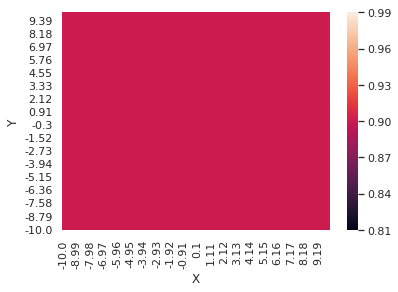

Return recorded for episode 362 :  5013.674820286682
0.010696076955250418


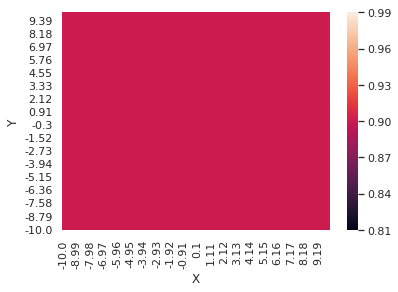

Return recorded for episode 363 :  5003.08042418957
0.010682293708055865


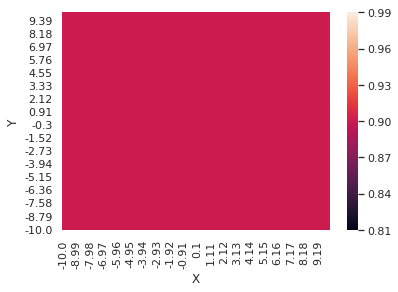

Return recorded for episode 364 :  4982.842634047456
0.010668783387441906


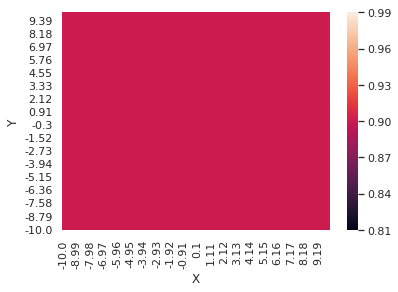

Return recorded for episode 365 :  4990.9679139248
0.010655540589100154


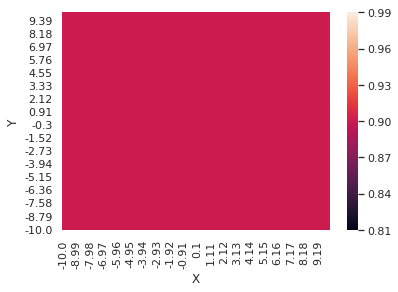

Return recorded for episode 366 :  5019.047349506491
0.0106425600157347


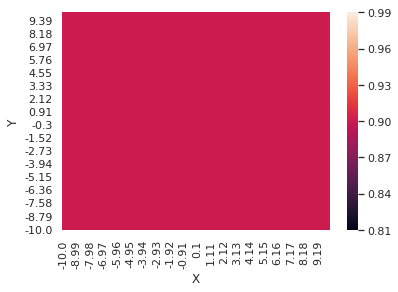

Return recorded for episode 367 :  5034.917145525238
0.01062983647494312


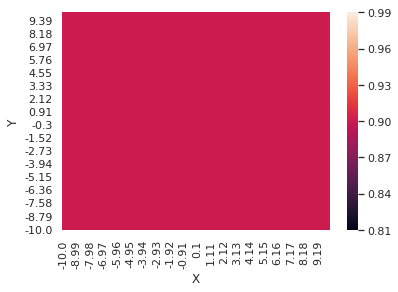

Return recorded for episode 368 :  5070.543585417576
0.01061736487713945


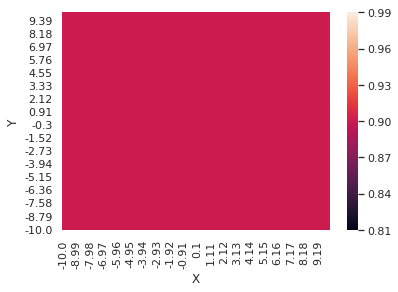

Return recorded for episode 369 :  5020.247586721425
0.010605140233518277


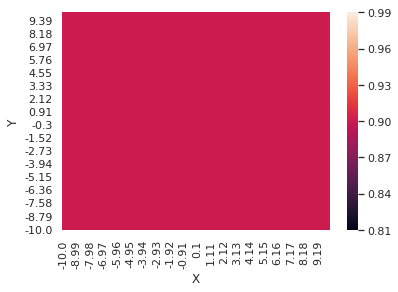

Return recorded for episode 370 :  5041.846334346562
Episode 270 ..370   Avg reward: 5018.602145639571   Epsilon: 0.0106
0.010593157654059155


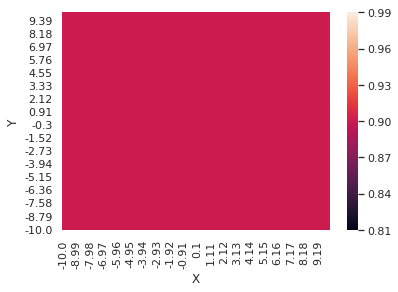

Return recorded for episode 371 :  4972.709128871005
0.01058141234557053


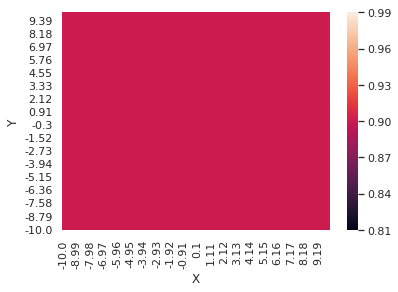

Return recorded for episode 372 :  5018.561947821679
0.010569899609772403


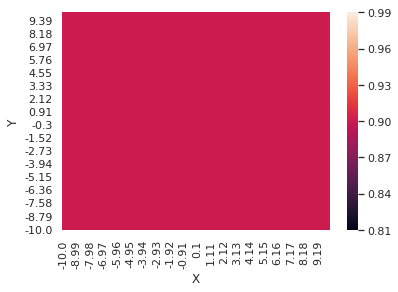

Return recorded for episode 373 :  5012.1699901080965
0.010558614841416947


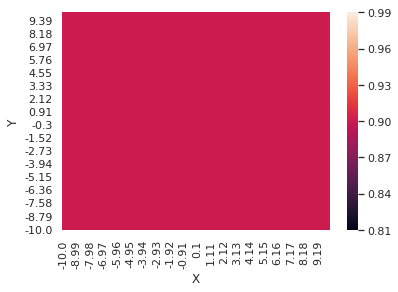

Return recorded for episode 374 :  5030.732884647062
0.010547553526446355


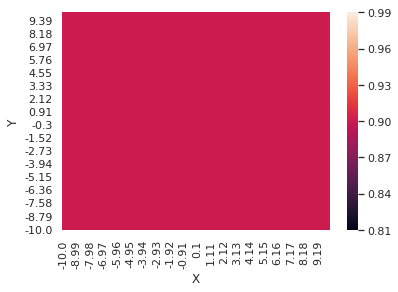

Return recorded for episode 375 :  4952.256309642143
0.010536711240187152


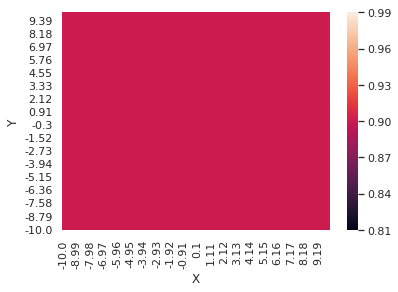

Return recorded for episode 376 :  5023.524892750925
0.01052608364558027


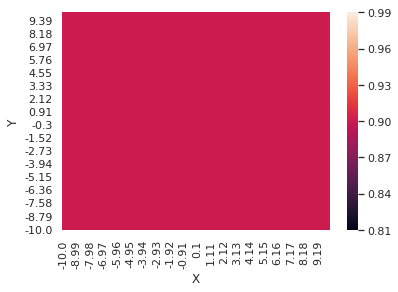

Return recorded for episode 377 :  5021.8649416675125
0.010515666491446161


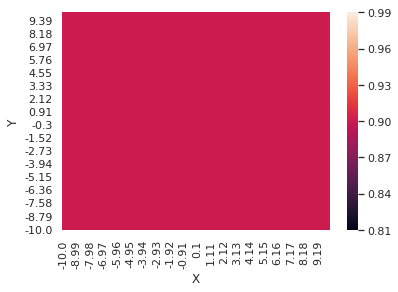

Return recorded for episode 378 :  5032.069878854499
0.010505455610784278


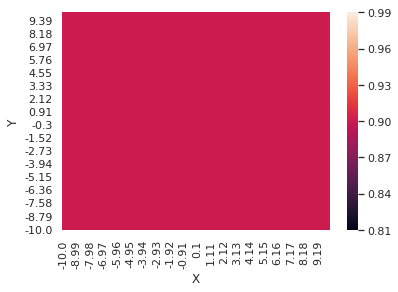

Return recorded for episode 379 :  5034.257802934244
0.010495446919106205


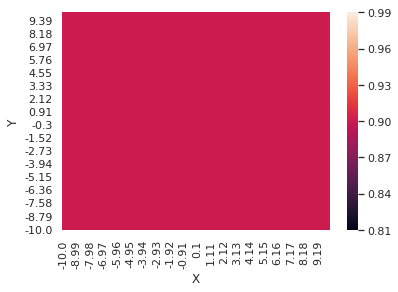

Return recorded for episode 380 :  5011.492466942945
Episode 280 ..380   Avg reward: 5013.999411164373   Epsilon: 0.0105
0.010485636412801822


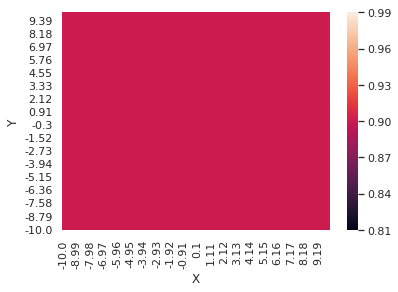

Return recorded for episode 381 :  5068.24061917194
0.010476020167537797


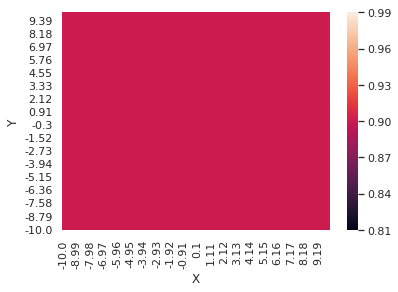

Return recorded for episode 382 :  5008.871439237518
0.010466594336687809


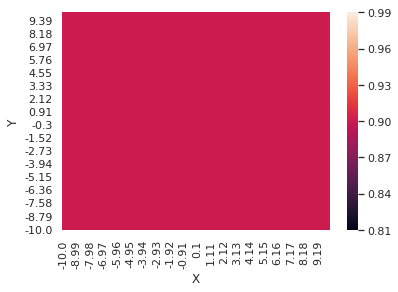

Return recorded for episode 383 :  5013.103461535108
0.010457355149793835


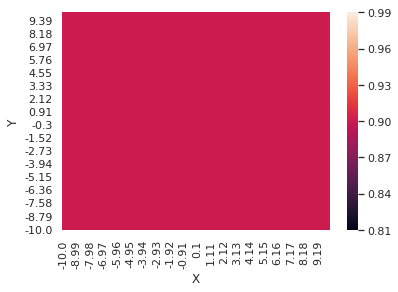

Return recorded for episode 384 :  5026.524110444596
0.010448298911057929


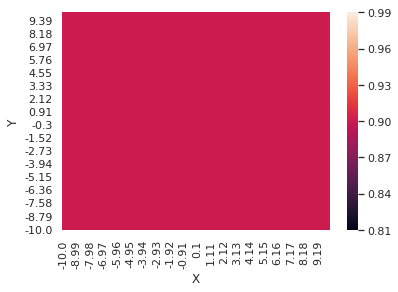

Return recorded for episode 385 :  5031.275880869652
0.010439421997863846


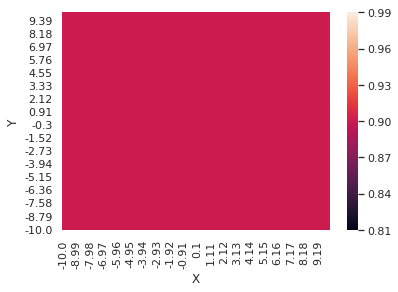

Return recorded for episode 386 :  5018.8619252747985
0.010430720859327945


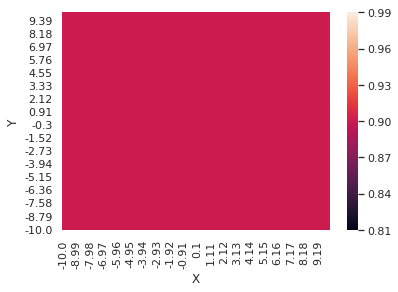

Return recorded for episode 387 :  5040.642436884144
0.010422192014878798


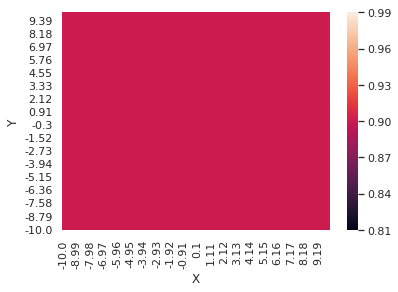

Return recorded for episode 388 :  4992.38989811288
0.010413832052864903


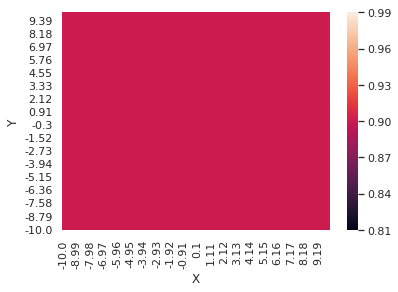

Return recorded for episode 389 :  5046.817411553721
0.010405637629189989


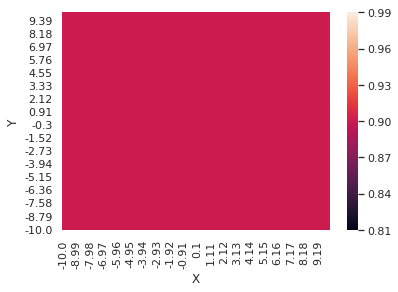

Return recorded for episode 390 :  5014.502579369269
Episode 290 ..390   Avg reward: 5025.82196500273   Epsilon: 0.0104
0.010397605465975325


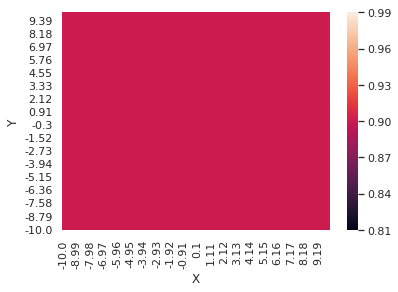

Return recorded for episode 391 :  5020.117831458812
0.010389732350248527


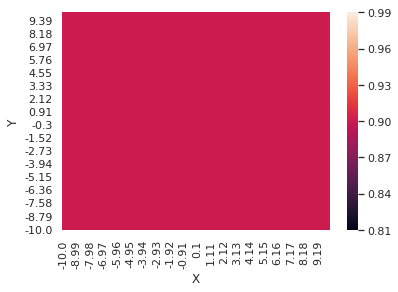

Return recorded for episode 392 :  5018.373479319286
0.01038201513265833


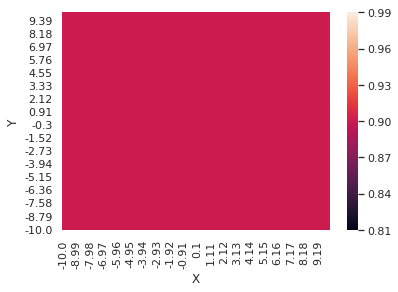

Return recorded for episode 393 :  4926.007579813596
0.0103744507262148


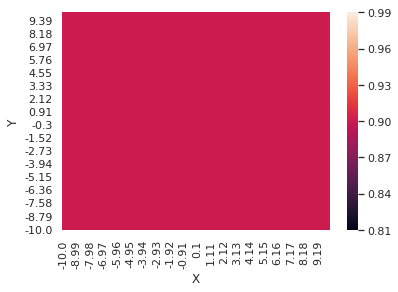

Return recorded for episode 394 :  5047.926710731033
0.010367036105054498


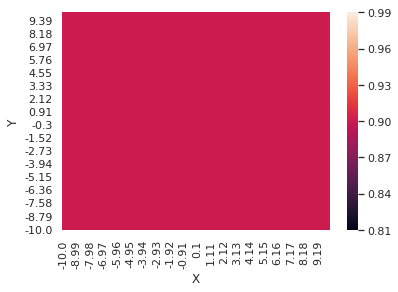

Return recorded for episode 395 :  5015.743024724974
0.010359768303230097


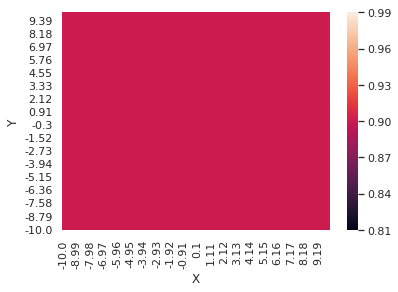

Return recorded for episode 396 :  5023.085410983453
0.010352644413523964


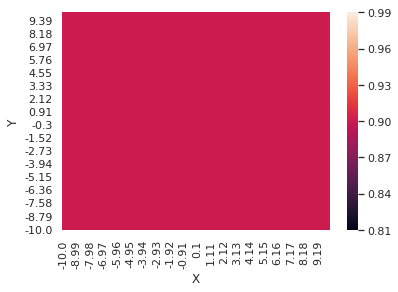

Return recorded for episode 397 :  5009.215343317068
0.010345661586285228


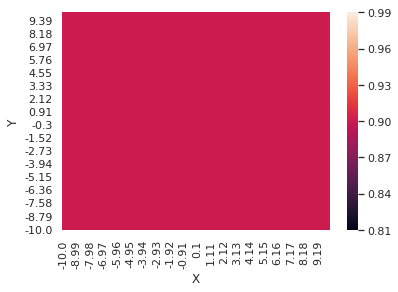

Return recorded for episode 398 :  5015.115310182335
0.01033881702828989


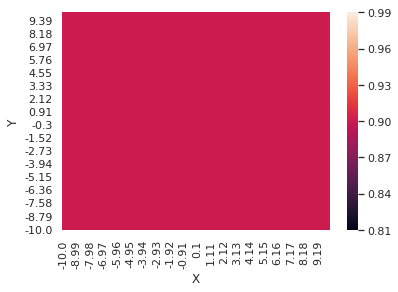

Return recorded for episode 399 :  5000.962921671009
0.010332108001623487


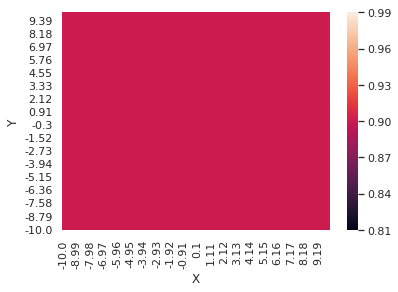

Return recorded for episode 400 :  4978.292601123917
Episode 300 ..400   Avg reward: 5009.105019157084   Epsilon: 0.0103
0.0103255318225859


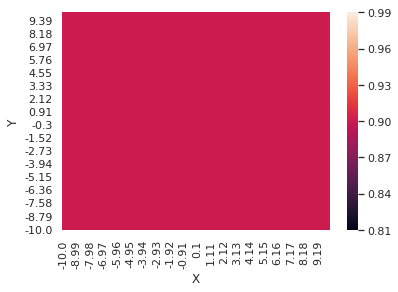

Return recorded for episode 401 :  5027.482169651437
0.01031908586061783


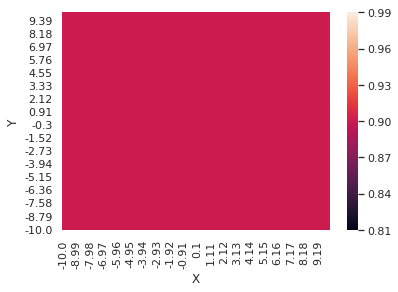

Return recorded for episode 402 :  5000.882307444053
0.01031276753724854


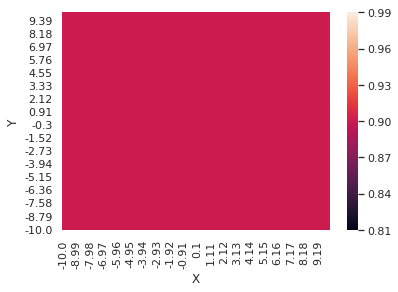

Return recorded for episode 403 :  5037.293117477169
0.01030657432506444


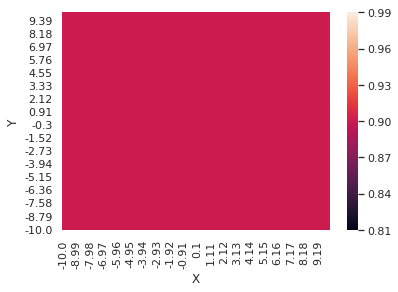

Return recorded for episode 404 :  4984.018041893079
0.01030050374669808


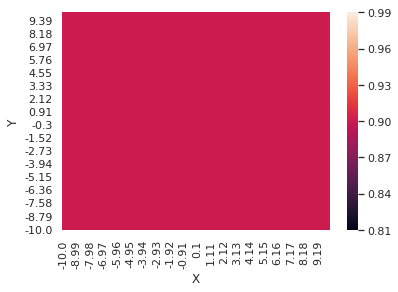

Return recorded for episode 405 :  5053.825834873671
0.010294553373837166


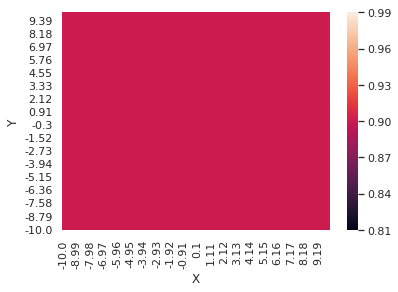

Return recorded for episode 406 :  4998.852323712151
0.010288720826253218


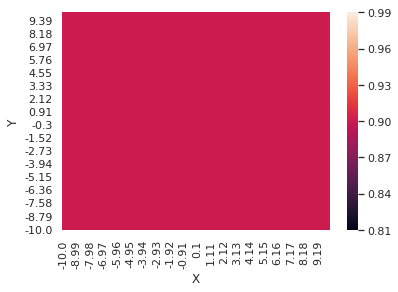

Return recorded for episode 407 :  5023.249189204231
0.010283003770849435


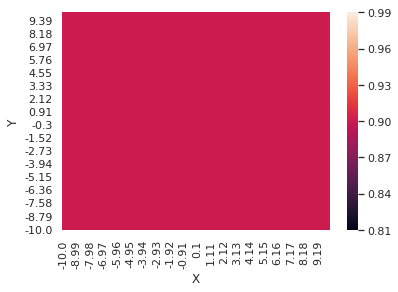

Return recorded for episode 408 :  4989.414424573422
0.010277399920727424


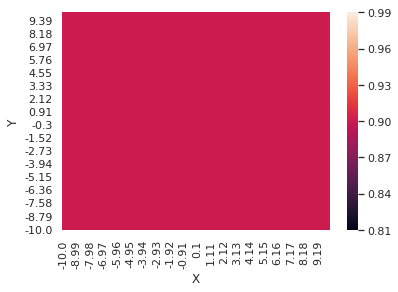

Return recorded for episode 409 :  5002.087607443154
0.010271907034272422


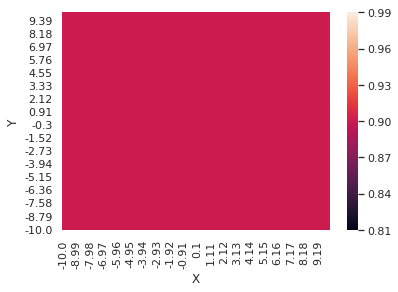

Return recorded for episode 410 :  4995.279140749754
Episode 310 ..410   Avg reward: 5009.539761739628   Epsilon: 0.0103
0.010266522914256601


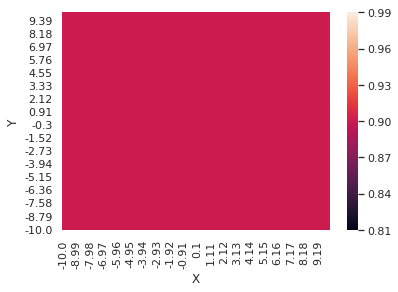

Return recorded for episode 411 :  5013.297875215688
0.01026124540696017


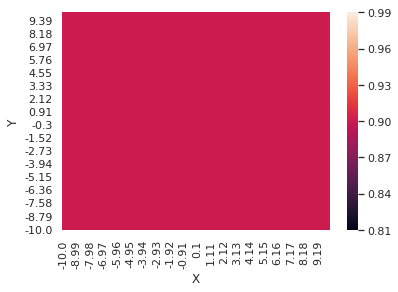

Return recorded for episode 412 :  5013.200878544203
0.010256072401309843


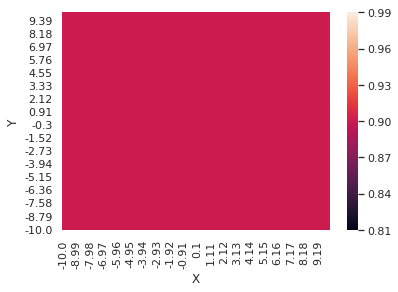

Return recorded for episode 413 :  5015.5098910847155
0.010251001828034383


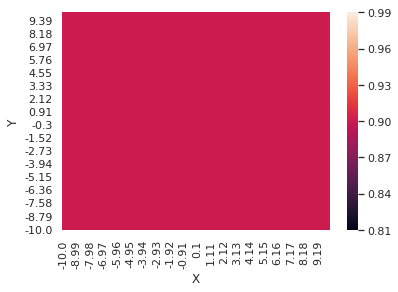

Return recorded for episode 414 :  5022.713545905432
0.010246031658836873


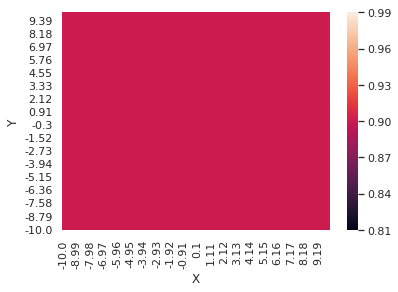

Return recorded for episode 415 :  5019.138212142894
0.010241159905583363


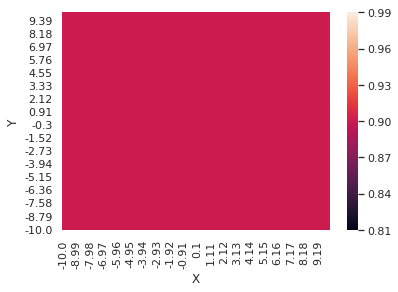

Return recorded for episode 416 :  5021.857569412842
0.010236384619507594


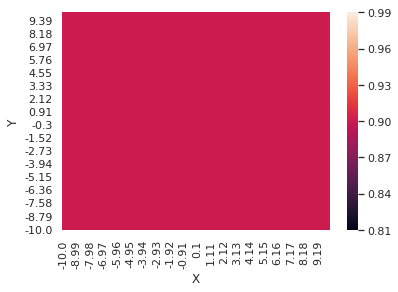

Return recorded for episode 417 :  4998.40913588879
0.010231703890431466


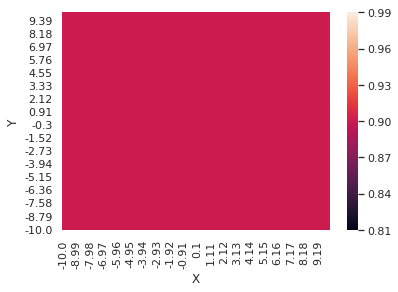

Return recorded for episode 418 :  5009.884160795161
0.010227115846000938


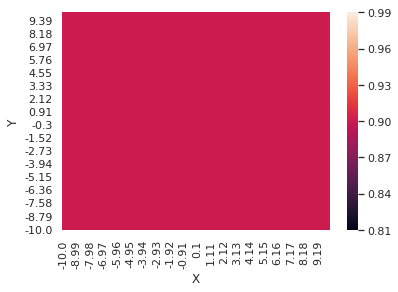

Return recorded for episode 419 :  5011.440477092437
0.01022261865093706


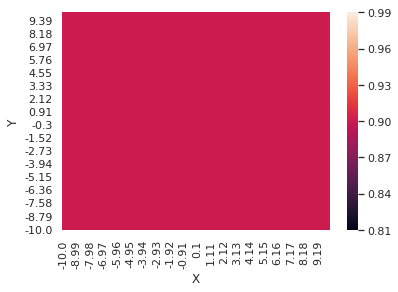

Return recorded for episode 420 :  5002.154771158333
Episode 320 ..420   Avg reward: 5012.073088683192   Epsilon: 0.0102
0.010218210506301846


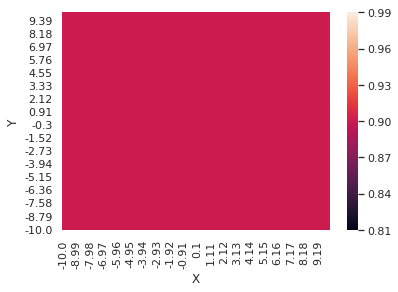

Return recorded for episode 421 :  5052.156948051346
0.010213889648778665


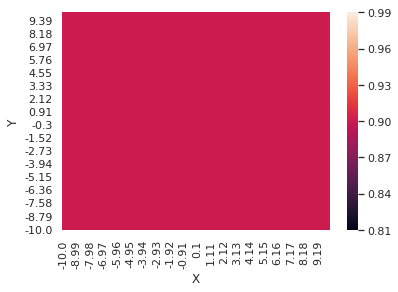

Return recorded for episode 422 :  4948.736404496617
0.010209654349966894


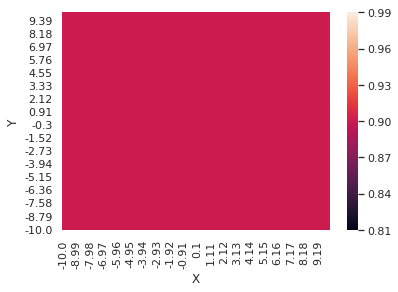

Return recorded for episode 423 :  5080.023254242822
0.01020550291569054


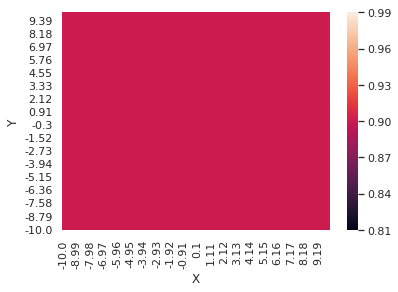

Return recorded for episode 424 :  5008.495118525298
0.010201433685320538


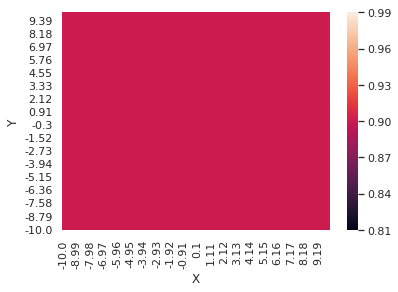

Return recorded for episode 425 :  4976.574633189213
0.010197445031110482


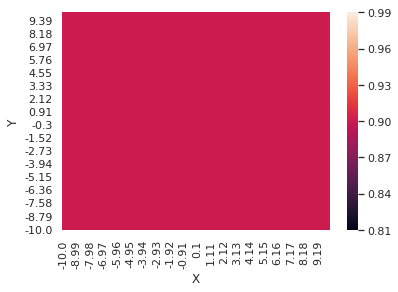

Return recorded for episode 426 :  4964.936027086427
0.010193535357545505


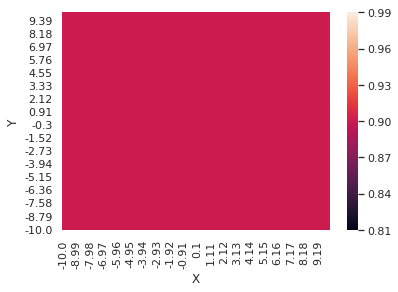

Return recorded for episode 427 :  4979.927560552854
0.010189703100704052


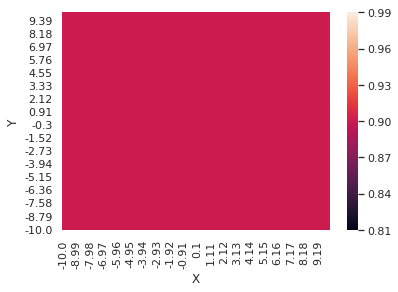

Return recorded for episode 428 :  4977.149430314971
0.01018594672763229


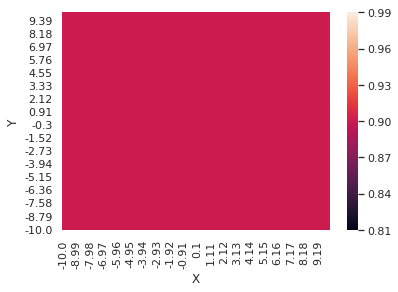

Return recorded for episode 429 :  5033.000967320024
0.010182264735730903


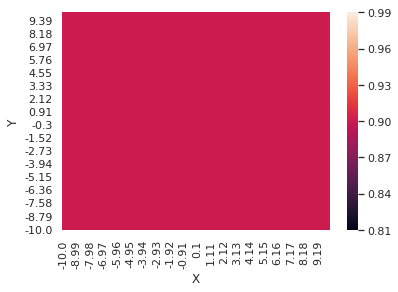

Return recorded for episode 430 :  4997.125117361601
Episode 330 ..430   Avg reward: 5002.315511493791   Epsilon: 0.0102
0.010178655652154037


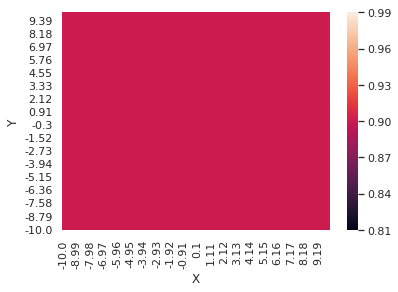

Return recorded for episode 431 :  4973.908859508165
0.01017511803322014


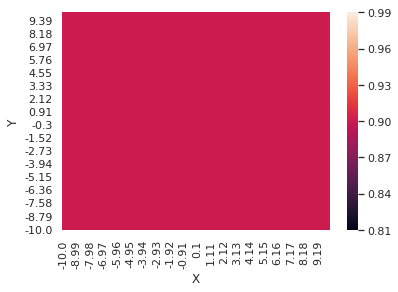

Return recorded for episode 432 :  5032.530203109693
0.01017165046383447


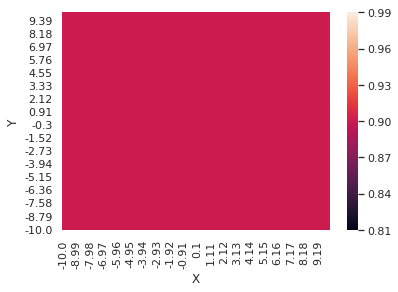

Return recorded for episode 433 :  5058.878866490757
0.010168251556923037


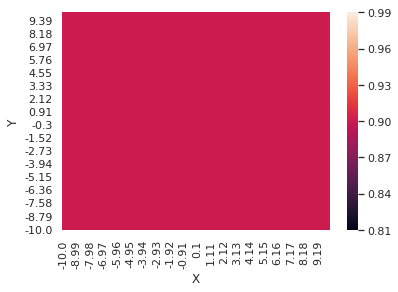

Return recorded for episode 434 :  4973.202213393265
0.010164919952877757


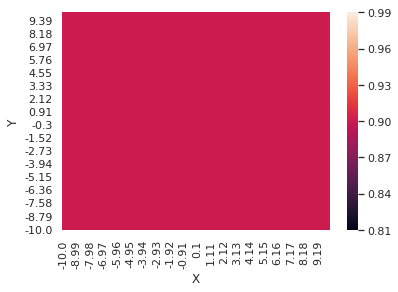

Return recorded for episode 435 :  5013.896461206917
0.01016165431901259


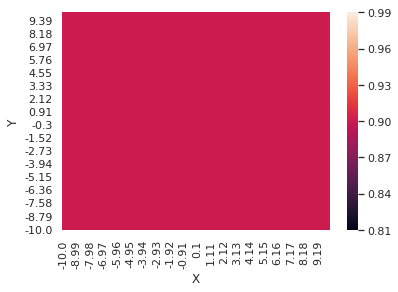

Return recorded for episode 436 :  4965.01240134154
0.010158453349030448


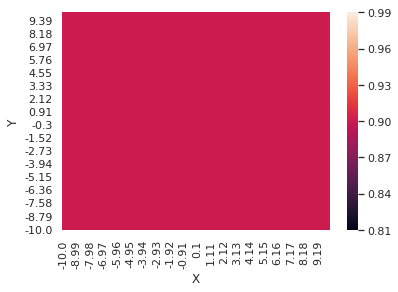

Return recorded for episode 437 :  5018.791874753379
0.010155315762500658


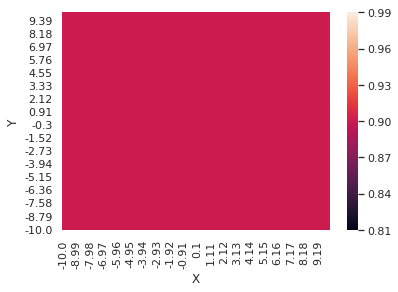

Return recorded for episode 438 :  4985.912925342561
0.010152240304346772


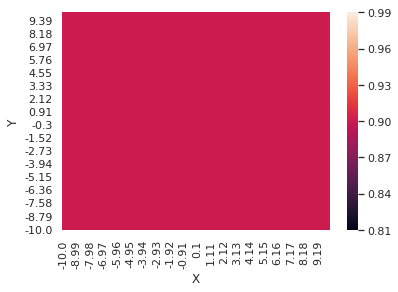

Return recorded for episode 439 :  4990.517507733406
0.010149225744344521


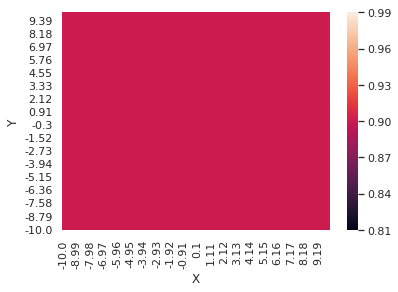

Return recorded for episode 440 :  5035.864800124866
Episode 340 ..440   Avg reward: 5000.977643024128   Epsilon: 0.0101
0.010146270876629714


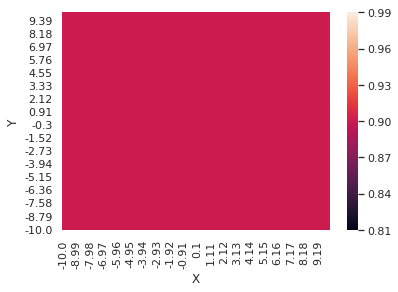

Return recorded for episode 441 :  4994.92043298488
0.010143374519215861


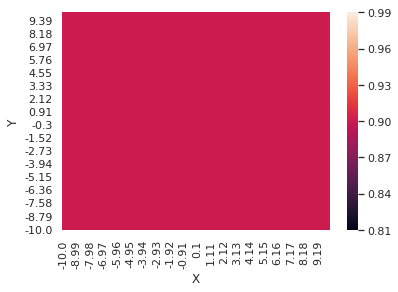

Return recorded for episode 442 :  5003.368814034536
0.01014053551352138


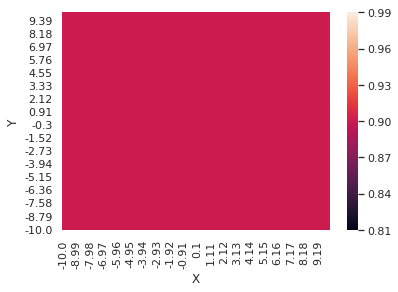

Return recorded for episode 443 :  4988.321944092158
0.010137752723906142


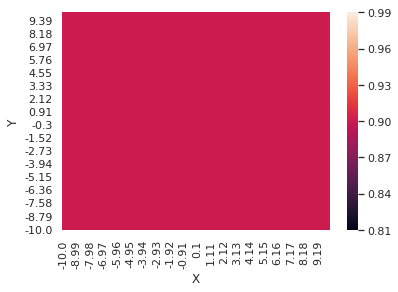

Return recorded for episode 444 :  4976.70423331223
0.010135025037217192


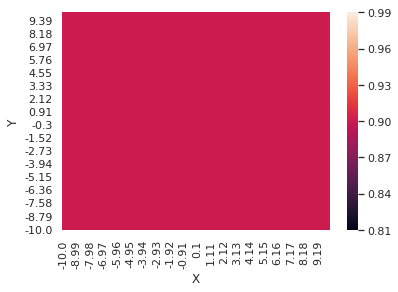

Return recorded for episode 445 :  4993.0252886778
0.010132351362343486


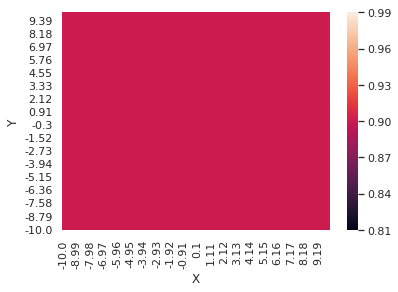

Return recorded for episode 446 :  5024.999876235111
0.010129730629779427


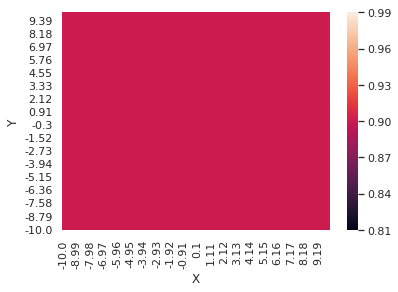

Return recorded for episode 447 :  5013.020565526389
0.010127161791197044


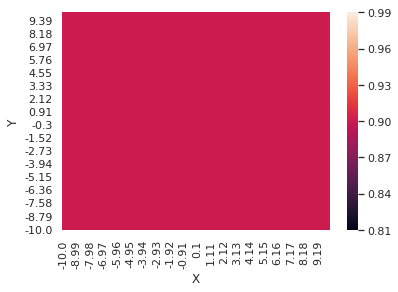

Return recorded for episode 448 :  4980.311751967634
0.010124643819026653


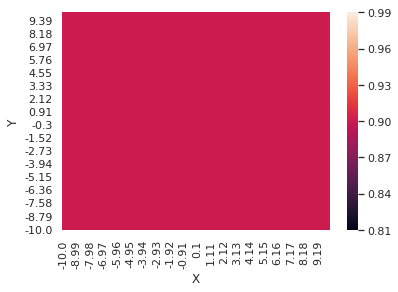

Return recorded for episode 449 :  5028.322640267069
0.010122175706045813


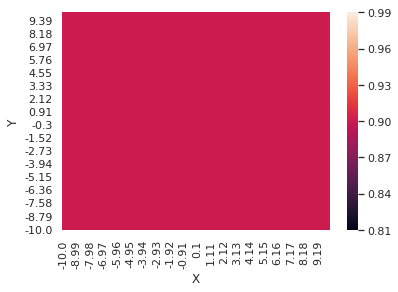

Return recorded for episode 450 :  5020.496574912707
Episode 350 ..450   Avg reward: 5003.886034722267   Epsilon: 0.0101
0.010119756464976423


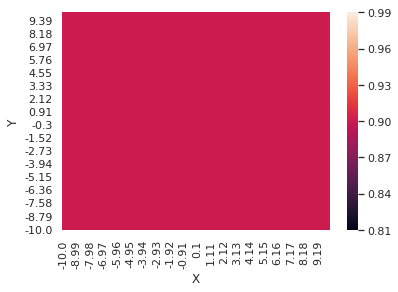

Return recorded for episode 451 :  4976.733697935665
0.010117385128089795


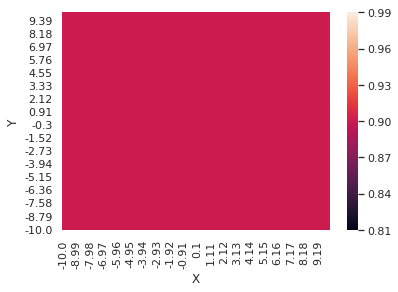

Return recorded for episode 452 :  5027.242086250403
0.010115060746819561


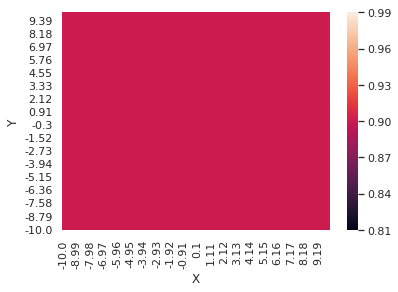

Return recorded for episode 453 :  4998.169639811653
0.010112782391382219


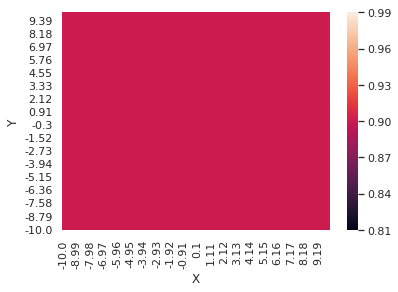

Return recorded for episode 454 :  5028.421773032926
0.010110549150405214


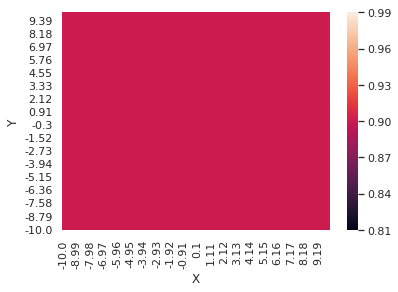

Return recorded for episode 455 :  4983.656938165501
0.010108360130562379


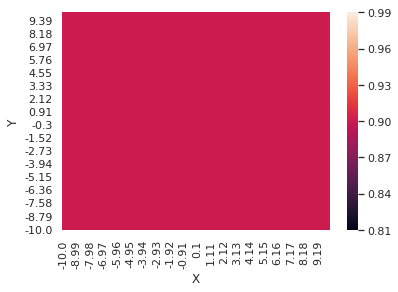

Return recorded for episode 456 :  4999.191508362974
0.010106214456216591


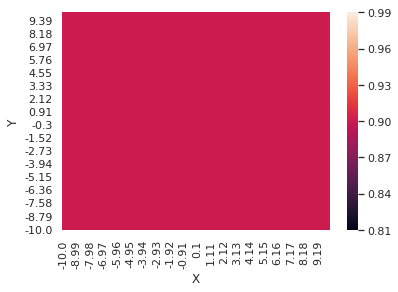

Return recorded for episode 457 :  5062.627334945504
0.010104111269069502


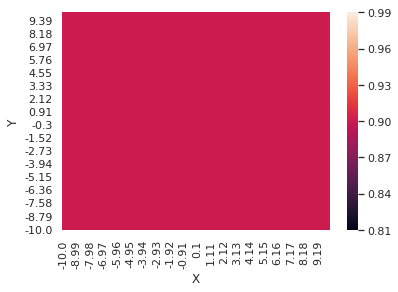

Return recorded for episode 458 :  5035.3606141501
0.010102049727818207


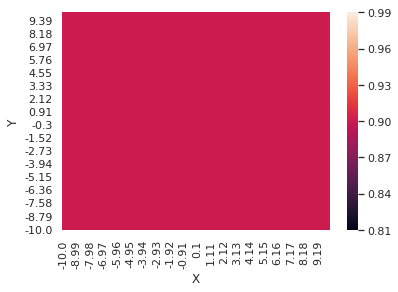

Return recorded for episode 459 :  4960.910163774754
0.010100029007818723


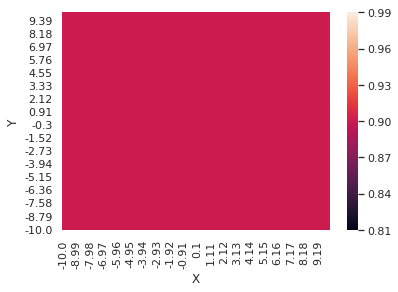

Return recorded for episode 460 :  4953.947881530721
Episode 360 ..460   Avg reward: 5009.281033134218   Epsilon: 0.0101
0.010098048300756102


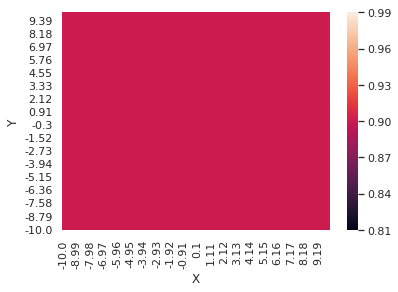

Return recorded for episode 461 :  4971.976189934219
0.010096106814321115


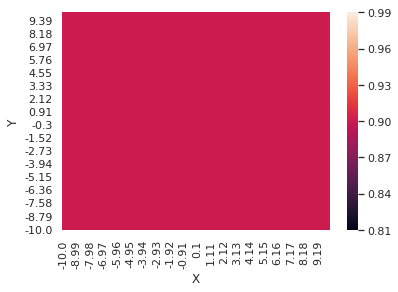

Return recorded for episode 462 :  5000.294598024396
0.010094203771893295


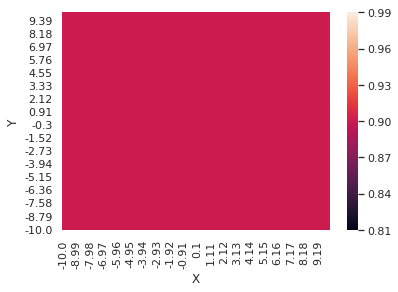

Return recorded for episode 463 :  5008.058647320427
0.0100923384122303


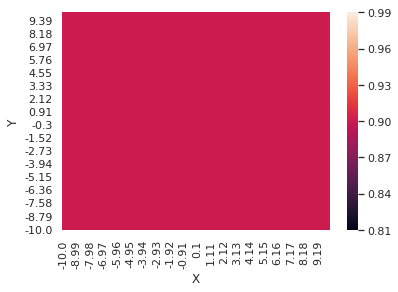

Return recorded for episode 464 :  5034.96281808812
0.010090509989163391


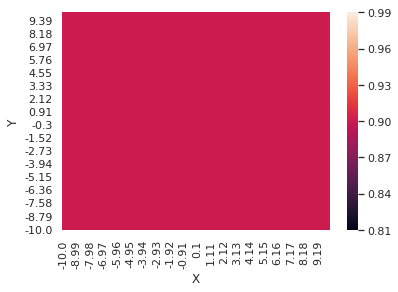

Return recorded for episode 465 :  5006.0719723494185
0.010088717771298966


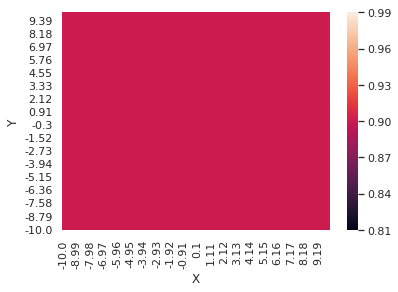

Return recorded for episode 466 :  5026.542233280475
0.010086961041725979


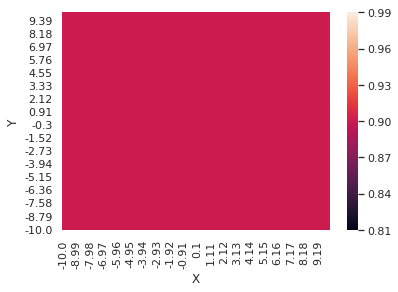

Return recorded for episode 467 :  5002.794368578845
0.010085239097729176


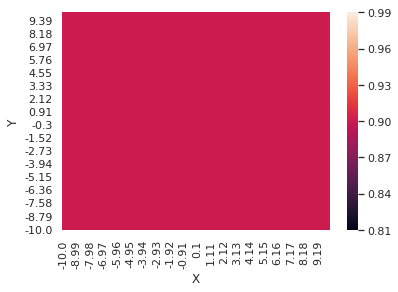

Return recorded for episode 468 :  4980.801933906911
0.010083551250508005


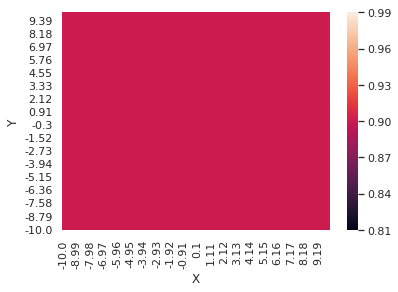

Return recorded for episode 469 :  4984.731225069137
0.010081896824901066


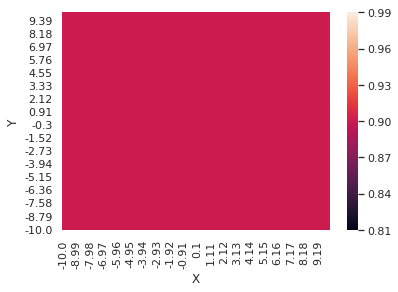

Return recorded for episode 470 :  5038.185123072865
Episode 370 ..470   Avg reward: 4997.018186808267   Epsilon: 0.0101
0.01008027515911606


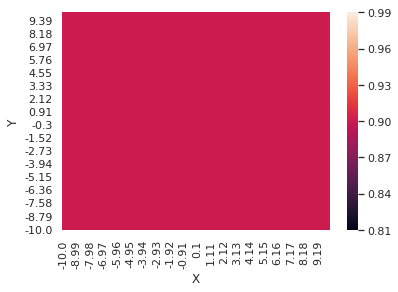

Return recorded for episode 471 :  4976.0571309753905
0.010078685604465051


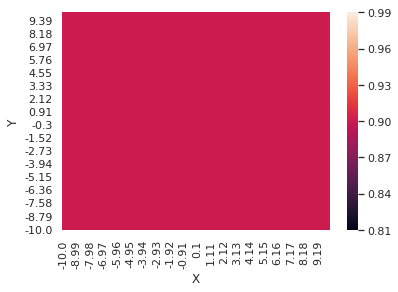

Return recorded for episode 472 :  5014.530532094792
0.010077127525104984


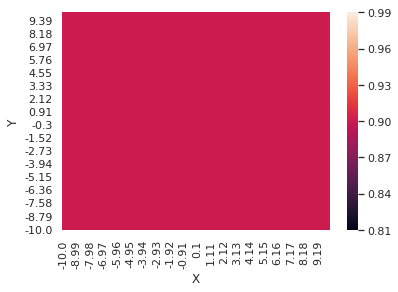

Return recorded for episode 473 :  4984.232703411591
0.010075600297783338


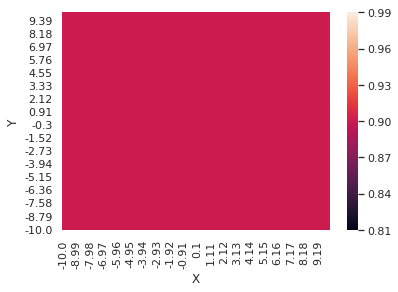

Return recorded for episode 474 :  4978.625028771202
0.010074103311588823


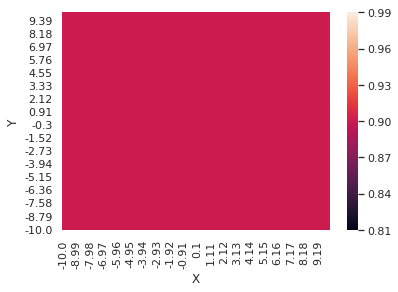

Return recorded for episode 475 :  4985.294315892911
0.010072635967707003


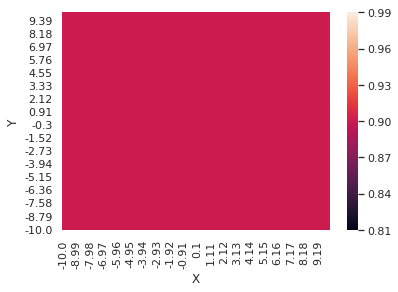

Return recorded for episode 476 :  5059.36509092658
0.010071197679180756


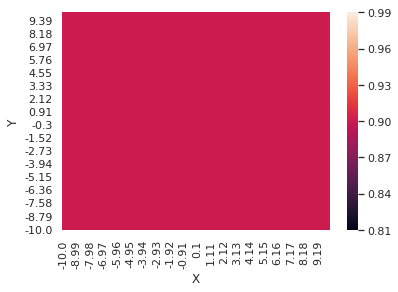

Return recorded for episode 477 :  5050.736890983908
0.010069787870675497


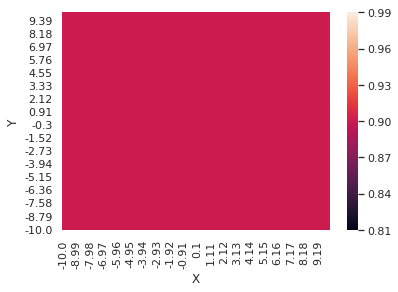

Return recorded for episode 478 :  4992.669458816307
0.010068405978249026


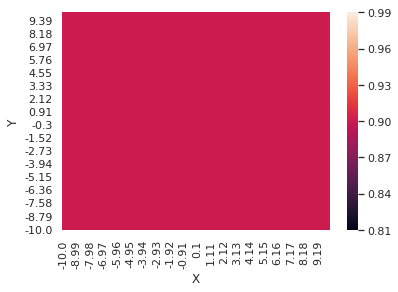

Return recorded for episode 479 :  4985.555957129665
0.010067051449125945


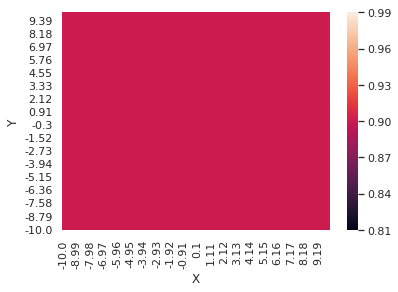

Return recorded for episode 480 :  4952.524537839736
Episode 380 ..480   Avg reward: 5006.525223207522   Epsilon: 0.0101
0.010065723741476547


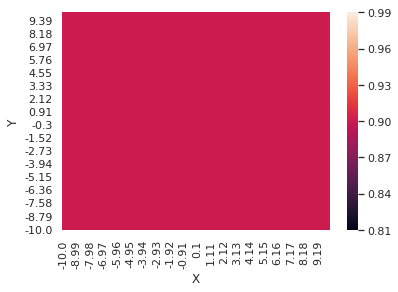

Return recorded for episode 481 :  5001.071707367927
0.010064422324200068


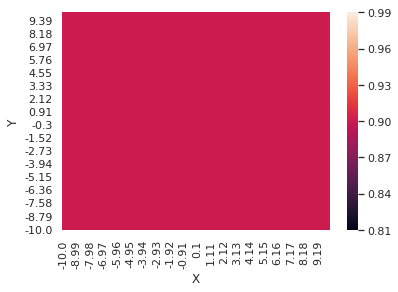

Return recorded for episode 482 :  5012.885533863716
0.010063146676712244


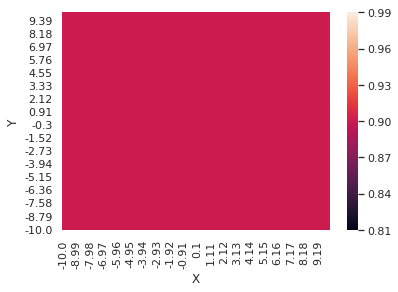

Return recorded for episode 483 :  5008.094247767364
0.010061896288737071


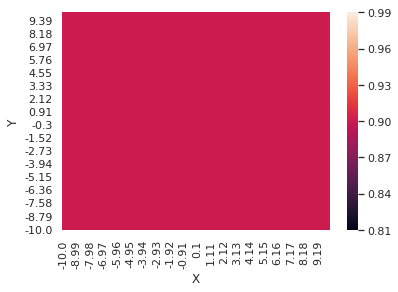

Return recorded for episode 484 :  5048.085543139811
0.01006067066010269


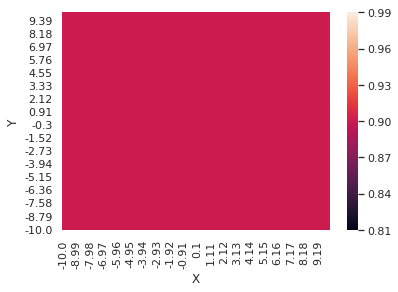

Return recorded for episode 485 :  4992.103759935659
0.010059469300541302


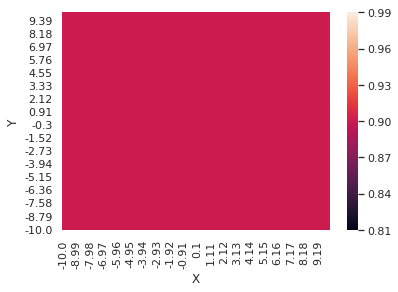

Return recorded for episode 486 :  4989.896600137353
0.010058291729493065


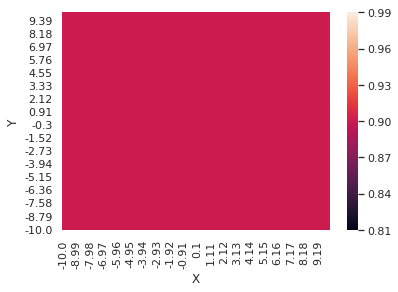

Return recorded for episode 487 :  4993.849014336822
0.010057137475913858


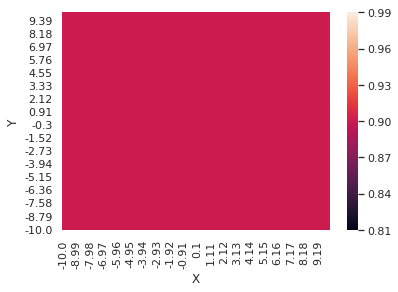

Return recorded for episode 488 :  5058.438566870497
0.010056006078086861


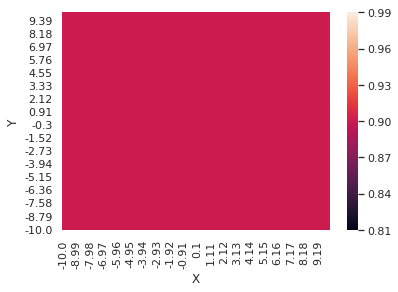

Return recorded for episode 489 :  4981.622588592209
0.010054897083437856


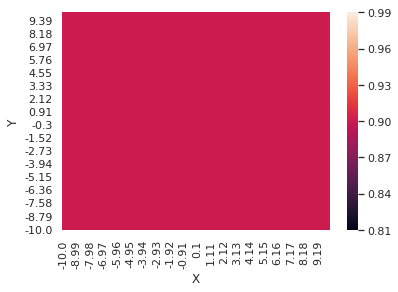

Return recorded for episode 490 :  4992.024001663054
Episode 390 ..490   Avg reward: 5003.85720998511   Epsilon: 0.0101
0.010053810048354195


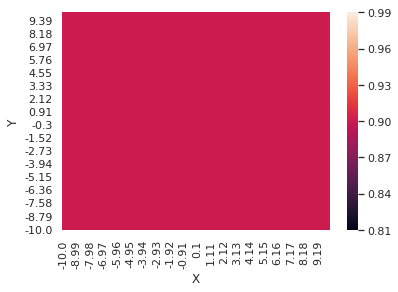

Return recorded for episode 491 :  5013.897225746044
0.010052744538007355


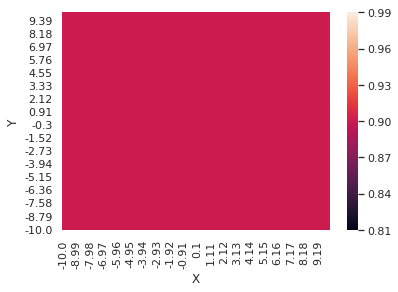

Return recorded for episode 492 :  4984.462747771703
0.010051700126178988


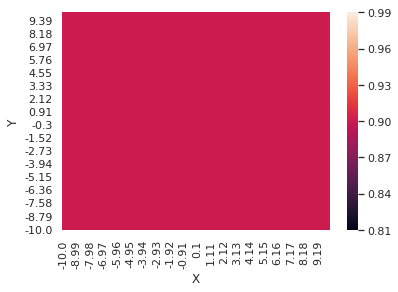

Return recorded for episode 493 :  4975.652431161485
0.010050676395090436


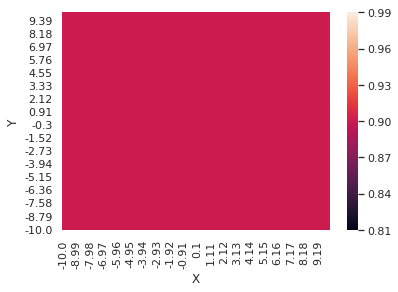

Return recorded for episode 494 :  4982.93544329051
0.010049672935235614


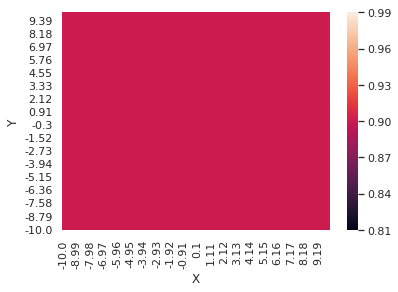

Return recorded for episode 495 :  5018.4846760677765
0.010048689345217202


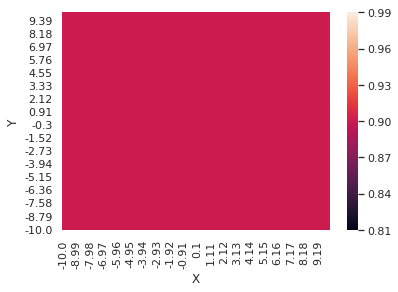

Return recorded for episode 496 :  5014.725829392496
0.010047725231586075


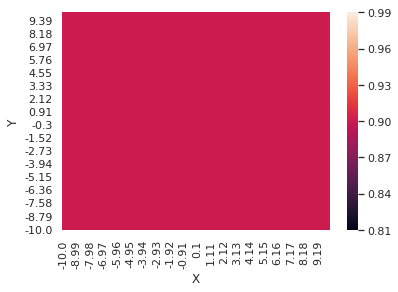

Return recorded for episode 497 :  4991.268553826702
0.010046780208683928


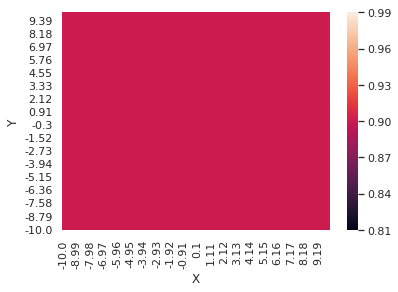

Return recorded for episode 498 :  4983.067055828389
0.010045853898488999


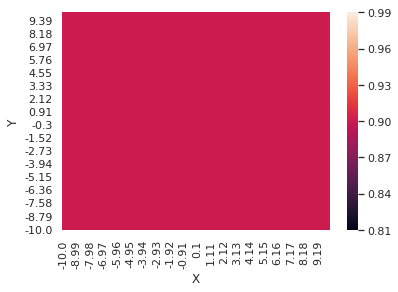

Return recorded for episode 499 :  4987.516176043006
0.010044945930464861


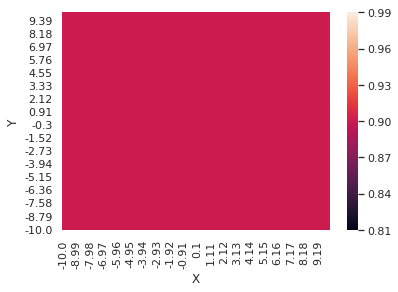

Return recorded for episode 500 :  5047.039657562492
Episode 400 ..500   Avg reward: 4994.403414079116   Epsilon: 0.0100
0.010044055941412194


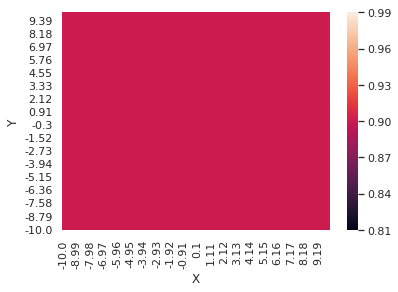

Return recorded for episode 501 :  4977.61685866643
0.010043183575323512


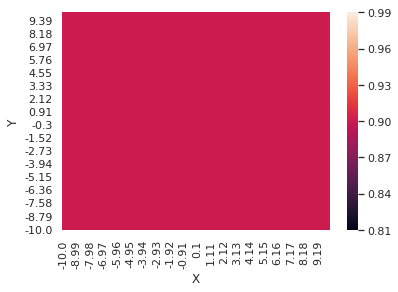

Return recorded for episode 502 :  4994.6219417509055
0.01004232848324075


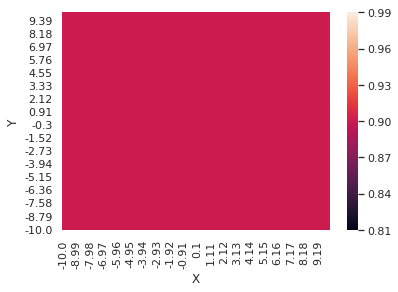

Return recorded for episode 503 :  4994.782143550995
0.01004149032311567


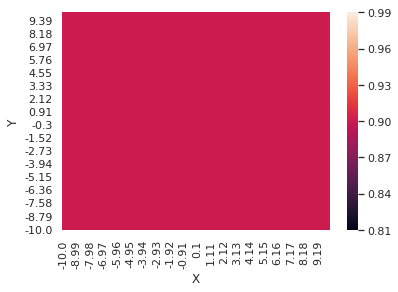

Return recorded for episode 504 :  5051.950845470033
0.010040668759673048


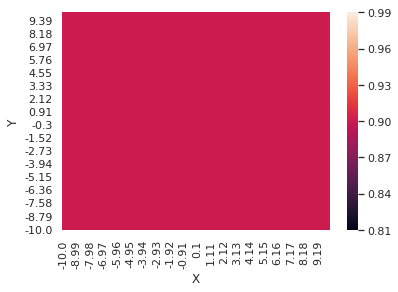

Return recorded for episode 505 :  5057.302286690737
0.010039863464276553


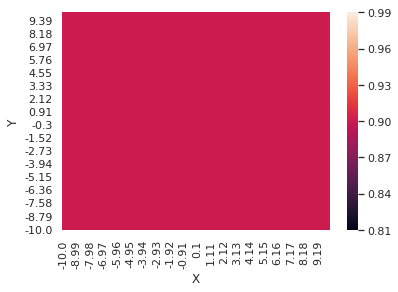

Return recorded for episode 506 :  4992.685059998394
0.010039074114797288


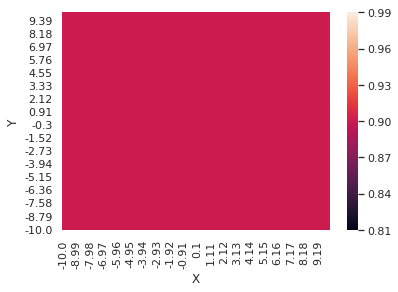

Return recorded for episode 507 :  5008.357451393138
0.010038300395484938


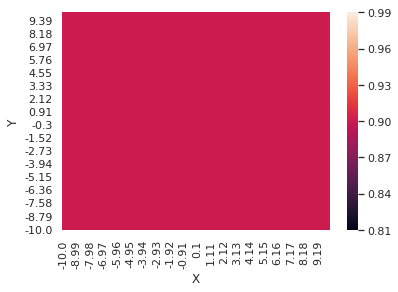

Return recorded for episode 508 :  5017.643559968847
0.01003754199684146


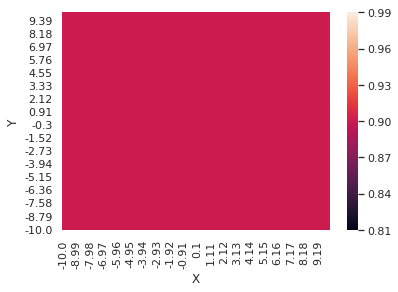

Return recorded for episode 509 :  5029.878445729883
0.010036798615497286


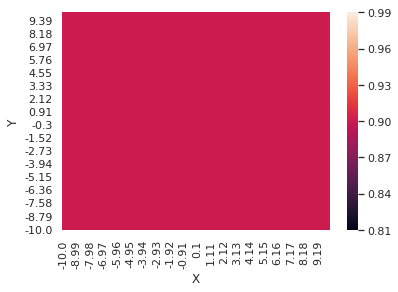

Return recorded for episode 510 :  4996.657335708264
Episode 410 ..510   Avg reward: 5017.187825078186   Epsilon: 0.0100
0.010036069954089965


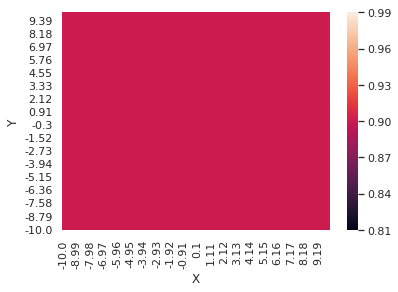

Return recorded for episode 511 :  5047.409927531915
0.01003535572114522


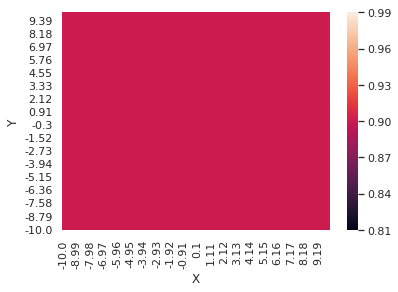

Return recorded for episode 512 :  5084.190964080336
0.010034655630960348


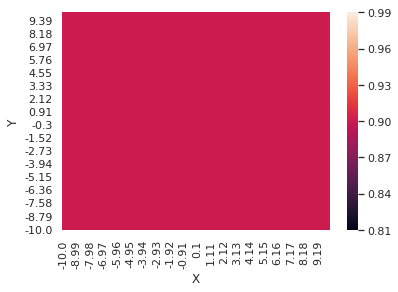

Return recorded for episode 513 :  4982.715037245445
0.010033969403489941


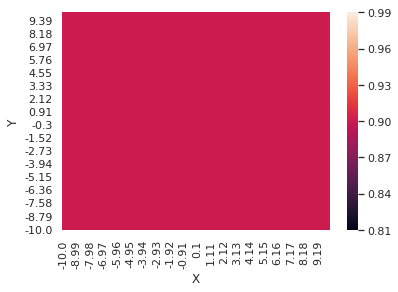

Return recorded for episode 514 :  5017.641435747235
0.010033296764233863


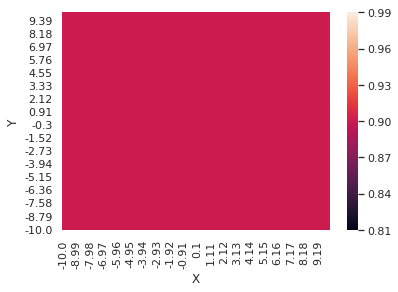

Return recorded for episode 515 :  5047.598379079758
0.01003263744412744


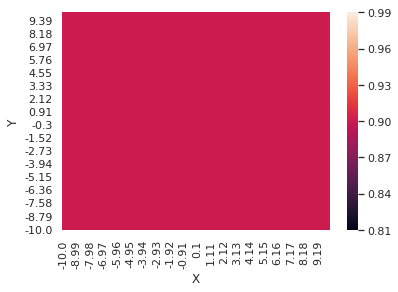

Return recorded for episode 516 :  4973.287944770202
0.01003199117943384


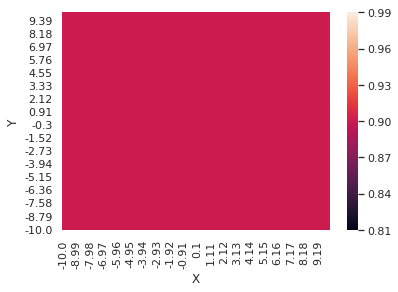

Return recorded for episode 517 :  5028.385627006789
0.010031357711638567


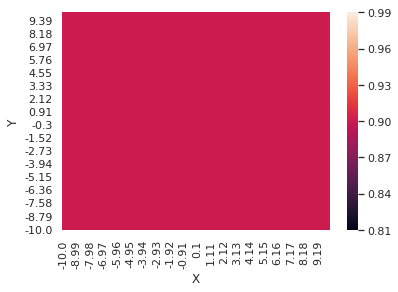

Return recorded for episode 518 :  5001.465001618855
0.01003073678734606


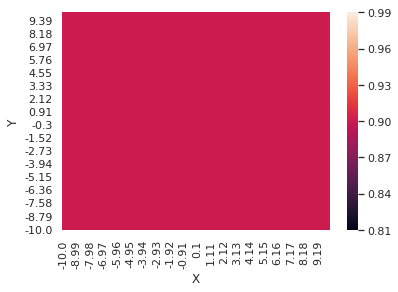

Return recorded for episode 519 :  5027.987831291996
0.01003012815817832


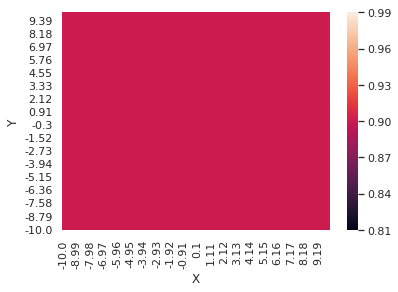

Return recorded for episode 520 :  4992.792006059382
Episode 420 ..520   Avg reward: 5020.733948408079   Epsilon: 0.0100
0.010029531580675564


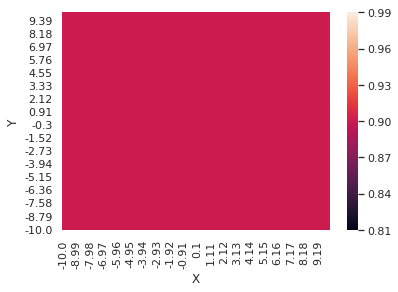

Return recorded for episode 521 :  5030.395402468385
0.01002894681619884


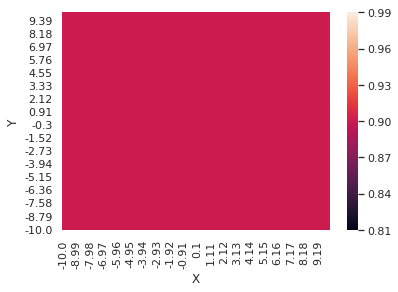

Return recorded for episode 522 :  5060.815974064274
0.010028373630834558


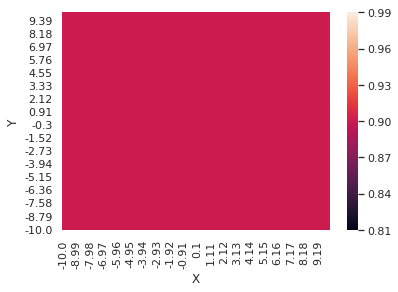

Return recorded for episode 523 :  5002.032181866656
0.010027811795300929


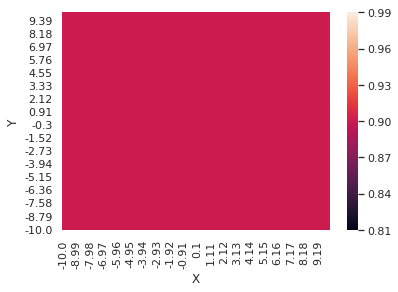

Return recorded for episode 524 :  5024.039681722728
0.01002726108485625


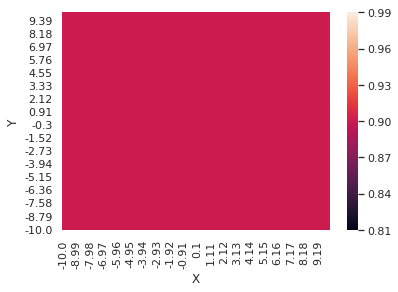

Return recorded for episode 525 :  5119.204101874632
0.010026721279208999


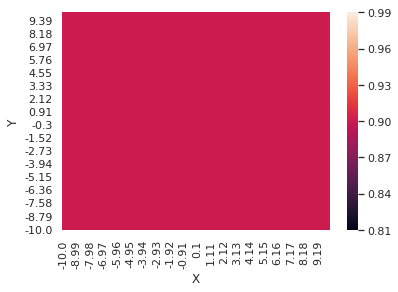

Return recorded for episode 526 :  4957.41592902407
0.01002619216242972


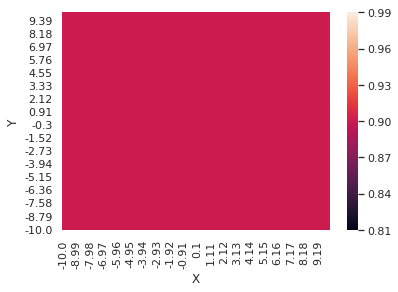

Return recorded for episode 527 :  4984.908088773766
0.010025673522864646


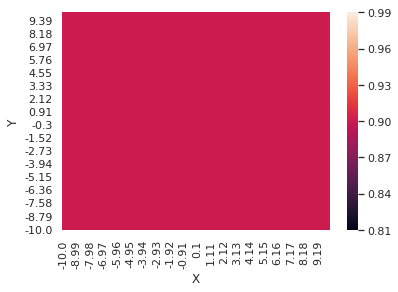

Return recorded for episode 528 :  4990.789742398447
0.010025165153051038


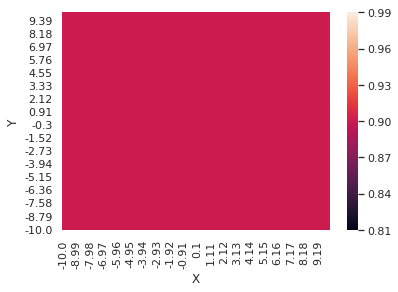

Return recorded for episode 529 :  4996.9091861797915
0.01002466684963419


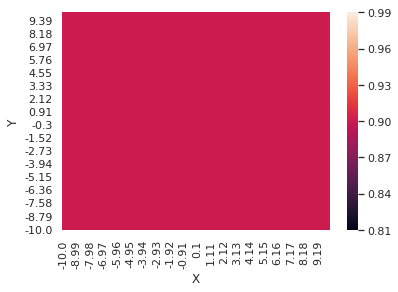

Return recorded for episode 530 :  4985.642023031353
Episode 430 ..530   Avg reward: 5015.930229443214   Epsilon: 0.0100
0.01002417841328609


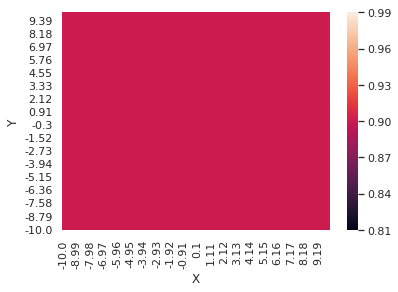

Return recorded for episode 531 :  5064.14081711571
0.010023699648625687


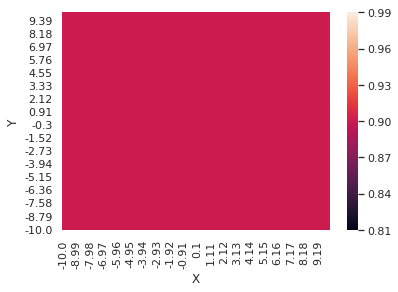

Return recorded for episode 532 :  5074.742042309028
0.010023230364140734


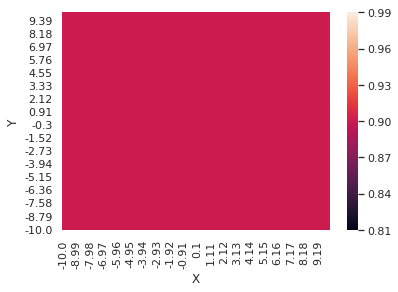

Return recorded for episode 533 :  4997.309389235544
0.01002277037211118


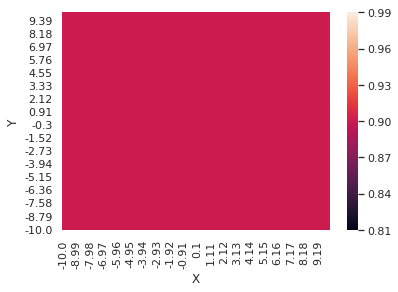

Return recorded for episode 534 :  4969.273738664178
0.01002231948853408


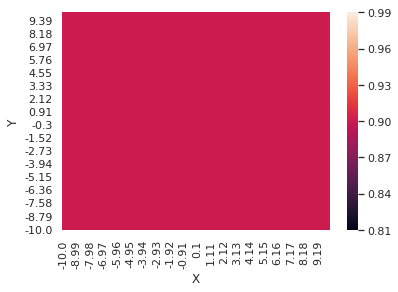

Return recorded for episode 535 :  5036.926663157194
0.010021877533049992


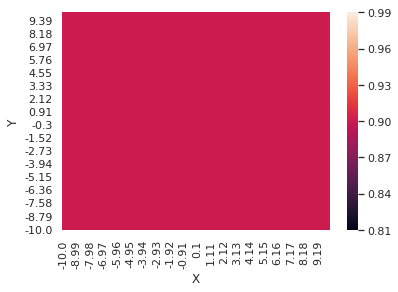

Return recorded for episode 536 :  5041.631392138929
0.010021444328870826


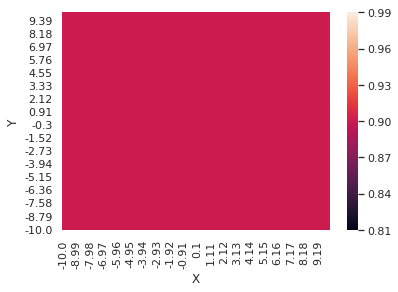

Return recorded for episode 537 :  5036.506120746355
0.010021019702709136


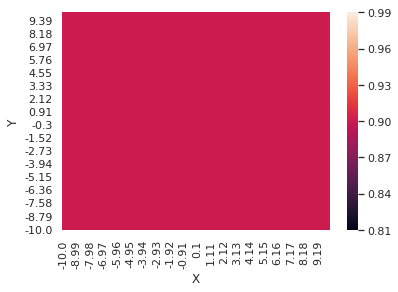

Return recorded for episode 538 :  5024.611669552757
0.010020603484708799


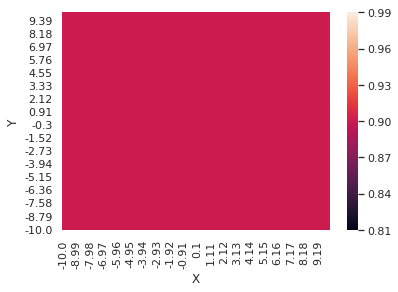

Return recorded for episode 539 :  5028.680770808324
0.01002019550837706


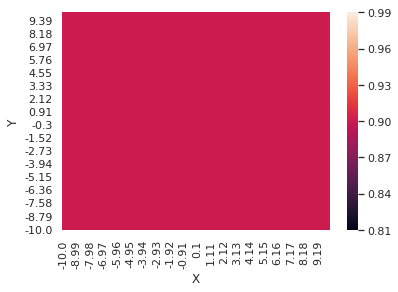

Return recorded for episode 540 :  4995.617325424798
Episode 440 ..540   Avg reward: 5025.946462675938   Epsilon: 0.0100
0.01001979561051795


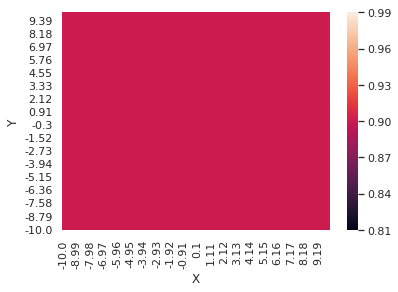

Return recorded for episode 541 :  4982.213472757234
0.010019403631166992


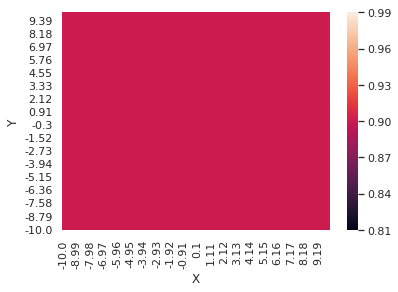

Return recorded for episode 542 :  4975.363843966788
0.01001901941352722


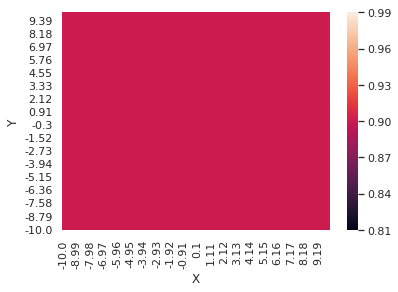

Return recorded for episode 543 :  5034.129058239118
0.010018642803906453


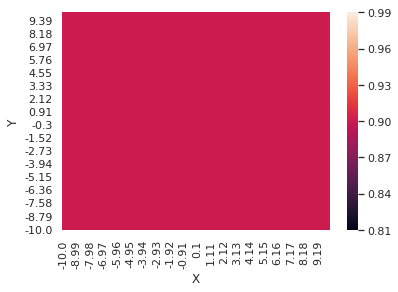

Return recorded for episode 544 :  4985.709123609316
0.010018273651655822


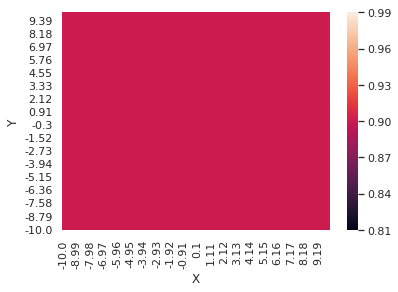

Return recorded for episode 545 :  5094.868241343152
0.010017911809109508


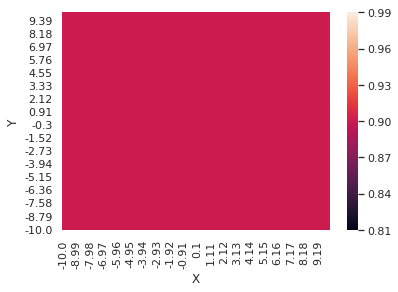

Return recorded for episode 546 :  4997.077995104505
0.010017557131525663


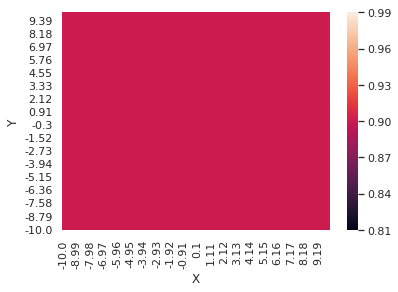

Return recorded for episode 547 :  5040.768380185308
0.010017209477028527


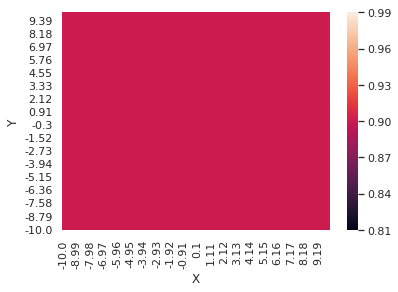

Return recorded for episode 548 :  4942.427300415354
0.010016868706551666


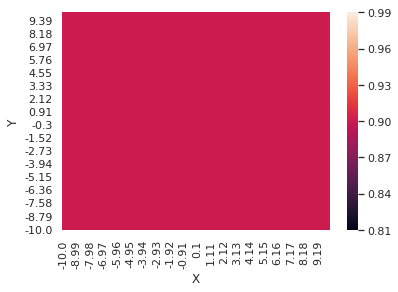

Return recorded for episode 549 :  4933.608427410674
0.010016534683782344


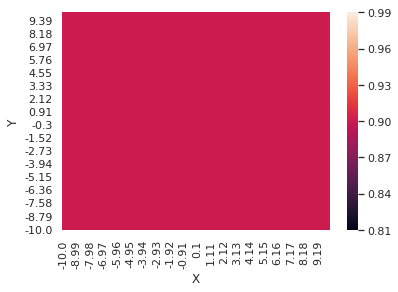

Return recorded for episode 550 :  5000.412737393408
Episode 450 ..550   Avg reward: 4998.178316845625   Epsilon: 0.0100
0.010016207275107


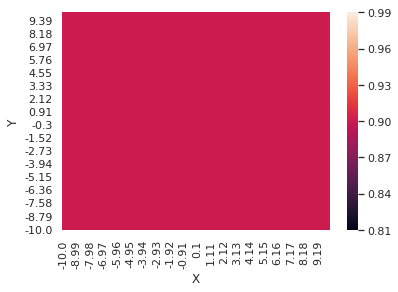

Return recorded for episode 551 :  4998.944520675492
0.0100158863495578


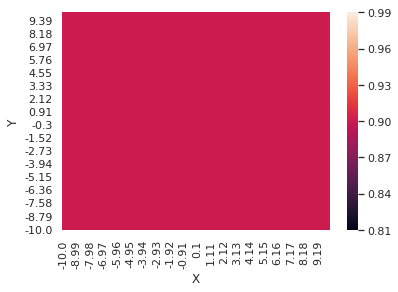

Return recorded for episode 552 :  4995.47619004671
0.010015571778760241


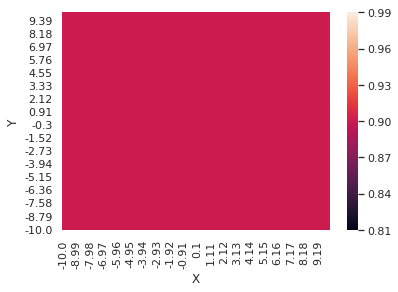

Return recorded for episode 553 :  5026.228008370232
0.010015263436881815


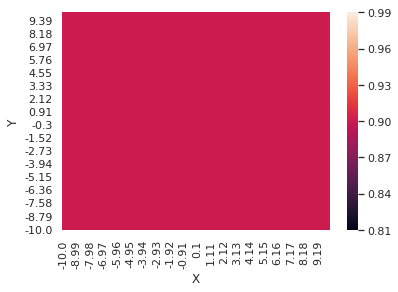

Return recorded for episode 554 :  5003.01630662505
0.010014961200581656


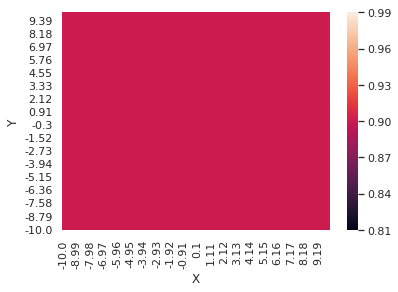

Return recorded for episode 555 :  5043.815506907095
0.010014664948961216


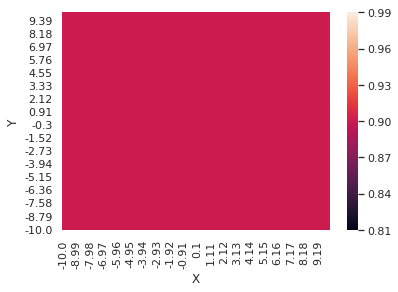

Return recorded for episode 556 :  4975.352823731288
0.010014374563515895


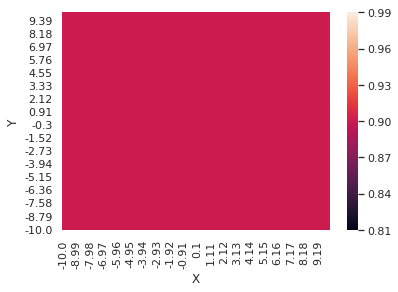

Return recorded for episode 557 :  4999.743111485973
0.010014089928087644


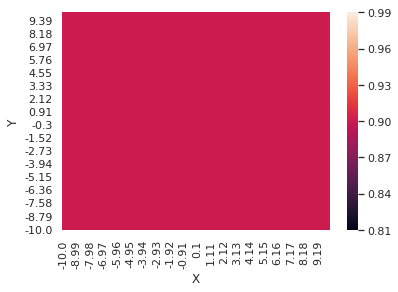

Return recorded for episode 558 :  5016.686148615231
0.010013810928818496


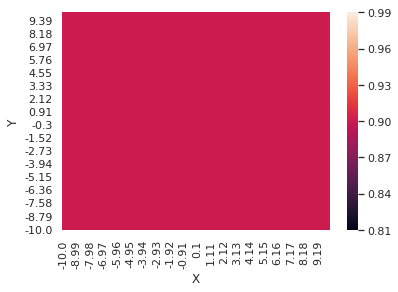

Return recorded for episode 559 :  4975.403988980975
0.010013537454105024


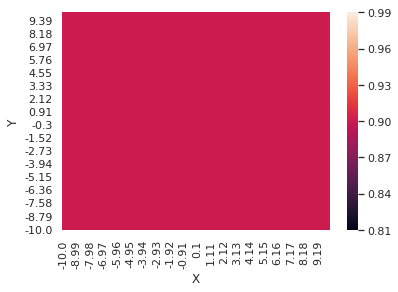

Return recorded for episode 560 :  5015.635386407892
Episode 460 ..560   Avg reward: 5003.507934283145   Epsilon: 0.0100
0.010013269394553695


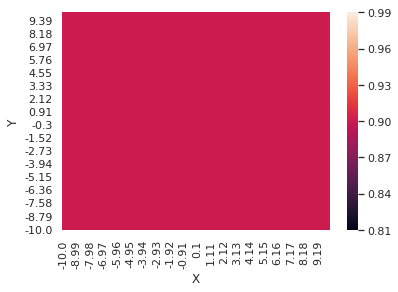

Return recorded for episode 561 :  5002.352296077906
0.010013006642937116


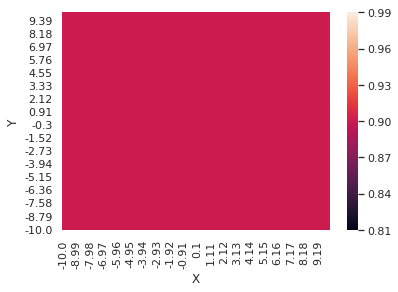

Return recorded for episode 562 :  5051.858209883418
0.010012749094151136


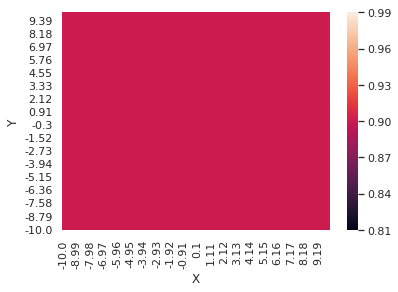

Return recorded for episode 563 :  4985.4894050346675
0.010012496645172807


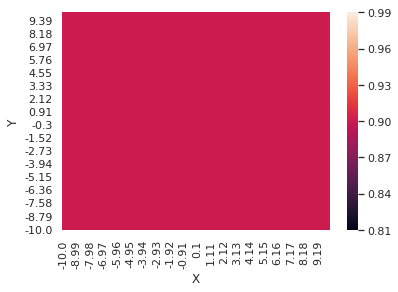

Return recorded for episode 564 :  5054.116809272996
0.01001224919501917


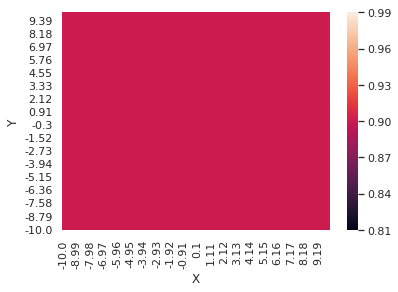

Return recorded for episode 565 :  4978.006328330488
0.010012006644706866


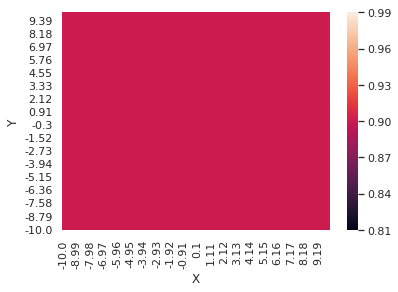

Return recorded for episode 566 :  5007.484353849075
0.010011768897212536


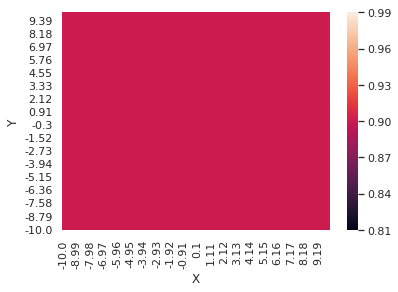

Return recorded for episode 567 :  5061.752460870147
0.010011535857434011


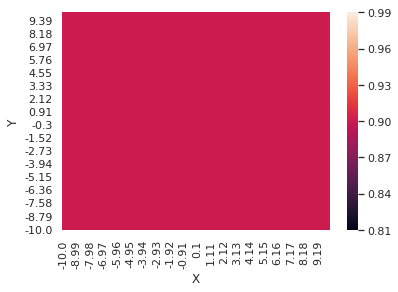

Return recorded for episode 568 :  5044.272028655931
0.010011307432152275


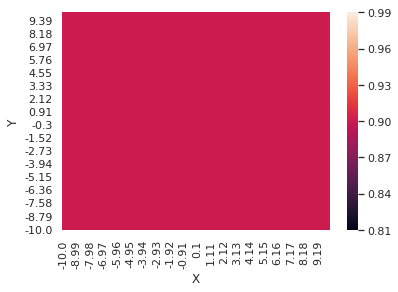

Return recorded for episode 569 :  5059.256302945981
0.010011083529994165


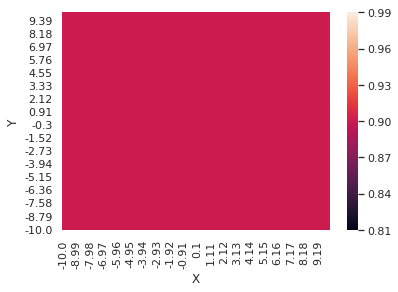

Return recorded for episode 570 :  5042.9361486191365
Episode 470 ..570   Avg reward: 5026.02235813285   Epsilon: 0.0100
0.010010864061395836


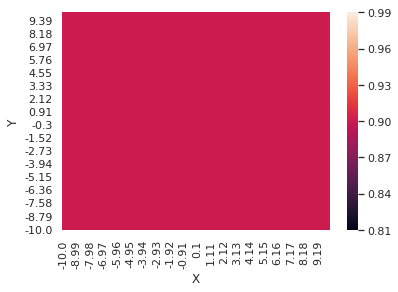

Return recorded for episode 571 :  5072.862362719816
0.010010648938566923


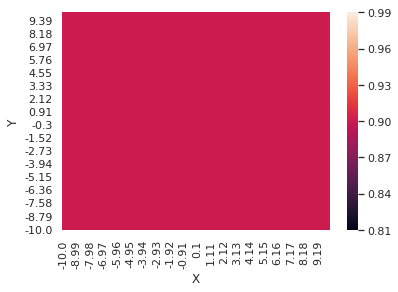

Return recorded for episode 572 :  5012.605476727621
0.010010438075455421


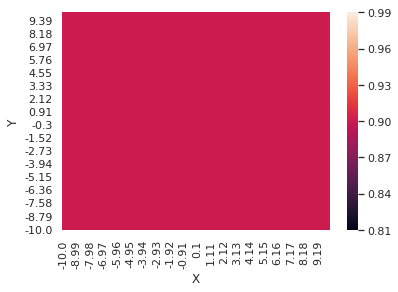

Return recorded for episode 573 :  5023.7830854294025
0.010010231387713281


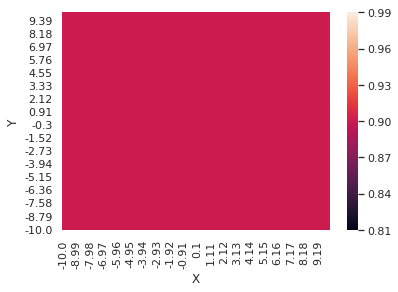

Return recorded for episode 574 :  5011.467124189598
0.010010028792662645


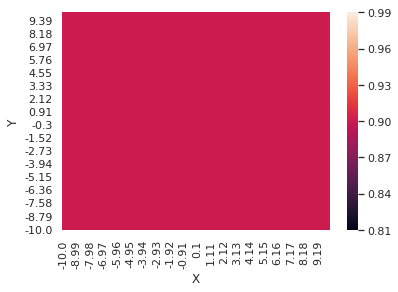

Return recorded for episode 575 :  4968.17337876543
0.010009830209262792


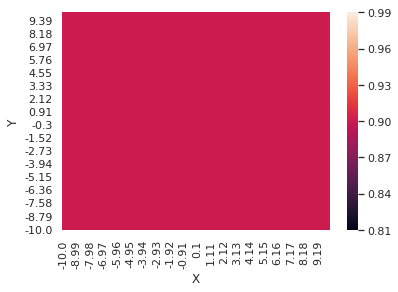

Return recorded for episode 576 :  5055.357405937114
0.010009635558077717


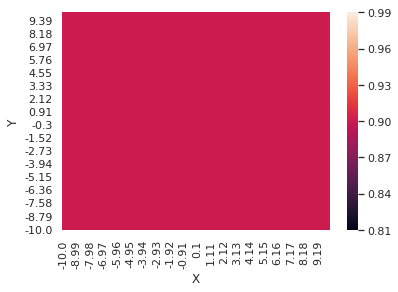

Return recorded for episode 577 :  5010.3569062365905
0.010009444761244348


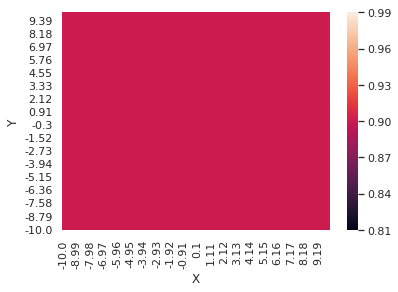

Return recorded for episode 578 :  5002.833926864773
0.01000925774244141


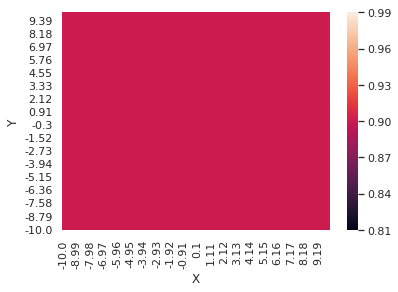

Return recorded for episode 579 :  5013.437666298514
0.010009074426858885


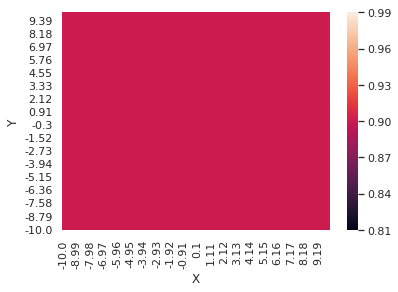

Return recorded for episode 580 :  4986.1758926466355
Episode 480 ..580   Avg reward: 5021.3813481788   Epsilon: 0.0100
0.010008894741168098


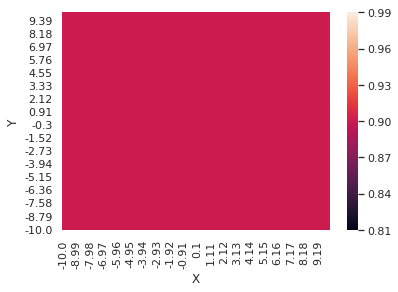

Return recorded for episode 581 :  5003.823933654175
0.010008718613492376


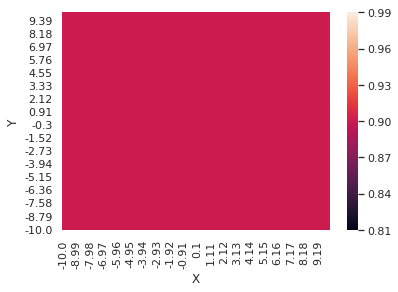

Return recorded for episode 582 :  4988.657882234985
0.010008545973378302


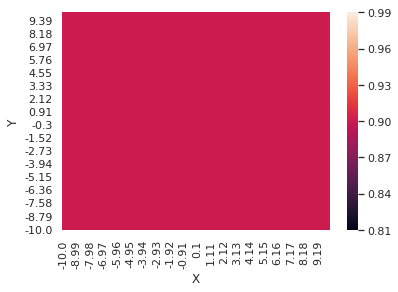

Return recorded for episode 583 :  5053.226058466815
0.010008376751767528


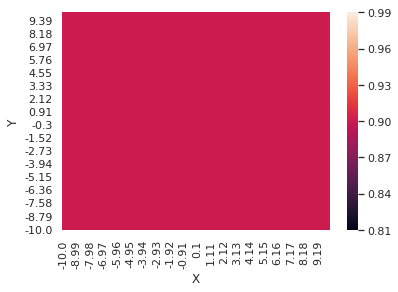

Return recorded for episode 584 :  5024.225759728057
0.01000821088096915


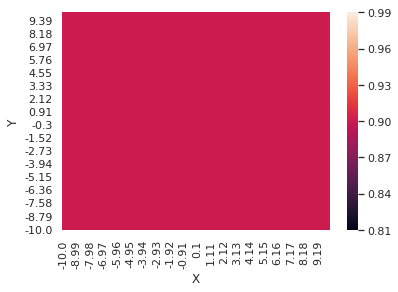

Return recorded for episode 585 :  5002.900221642628
0.01000804829463264


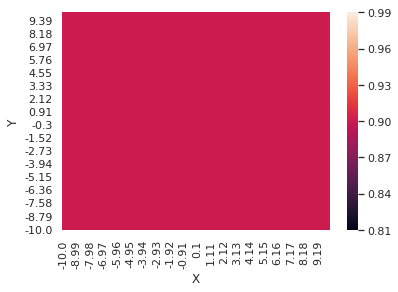

Return recorded for episode 586 :  4989.654385681701
0.010007888927721297


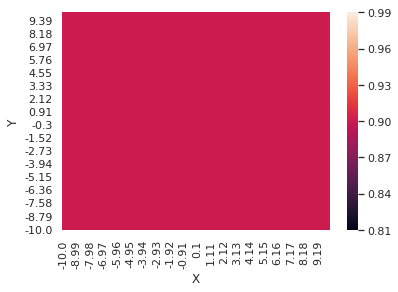

Return recorded for episode 587 :  5004.07970460442
0.010007732716486228


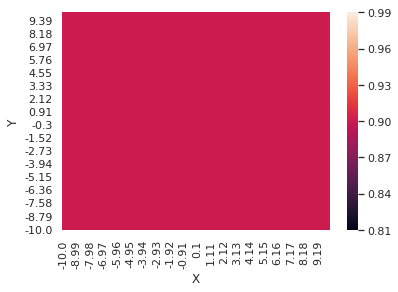

Return recorded for episode 588 :  5002.746464389847
0.010007579598440857


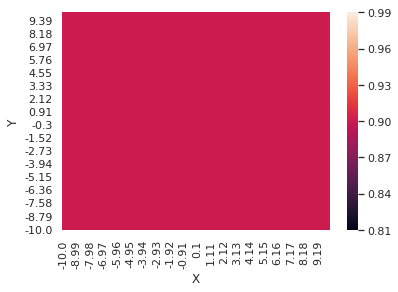

Return recorded for episode 589 :  4956.111782013745
0.010007429512335927


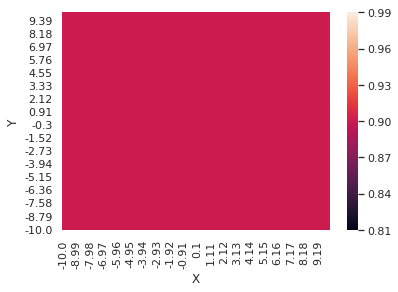

Return recorded for episode 590 :  5016.121528455291
Episode 490 ..590   Avg reward: 5001.1602085063005   Epsilon: 0.0100
0.010007282398134991


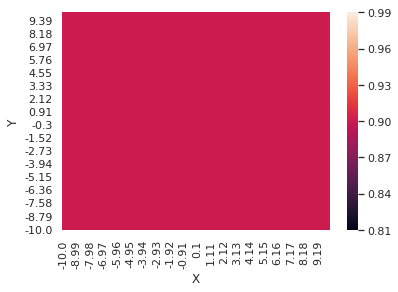

Return recorded for episode 591 :  4988.558682325911
0.01000713819699041


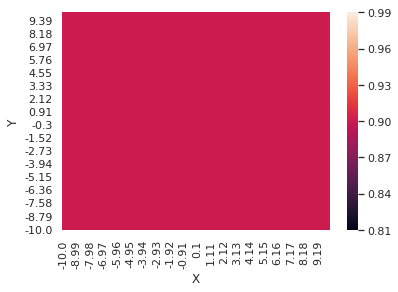

Return recorded for episode 592 :  5009.312799743656
0.010006996851219802


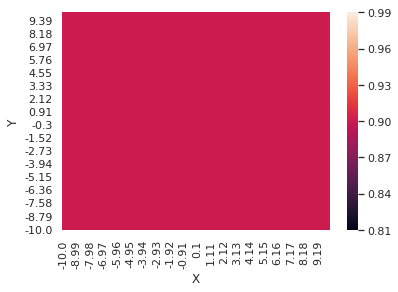

Return recorded for episode 593 :  5050.160418072273
0.010006858304282974


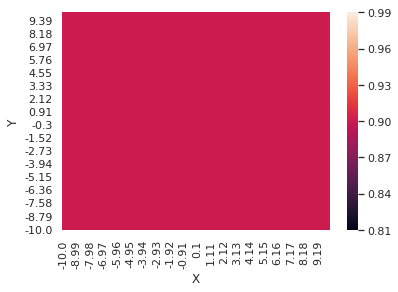

Return recorded for episode 594 :  5062.405290021251
0.010006722500759306


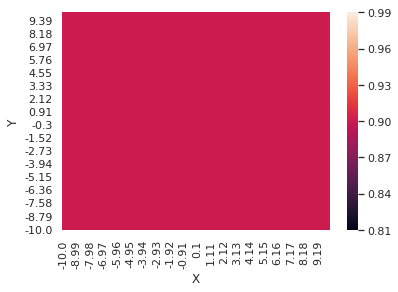

Return recorded for episode 595 :  5010.996553144391
0.010006589386325575


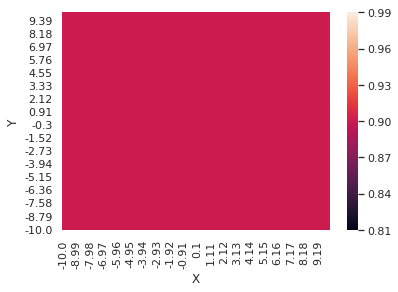

Return recorded for episode 596 :  5056.355710444918
0.010006458907734234


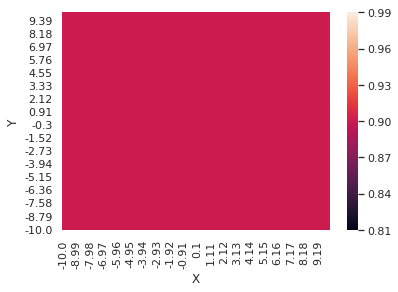

Return recorded for episode 597 :  5015.908100774829
0.010006331012792108


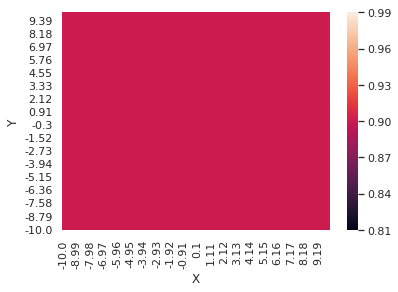

Return recorded for episode 598 :  4999.730128399588
0.010006205650339512


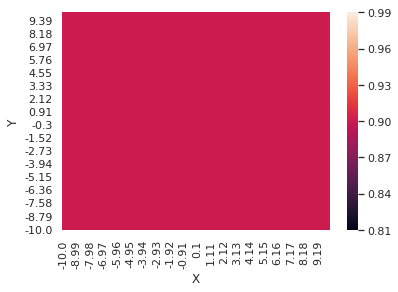

Return recorded for episode 599 :  5015.173499201276
0.010006082770229794


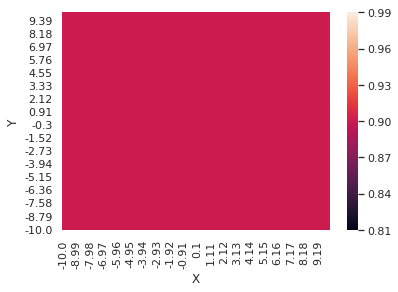

Return recorded for episode 600 :  5017.969018350447
Episode 500 ..600   Avg reward: 5022.472271058339   Epsilon: 0.0100
0.010005962323309275


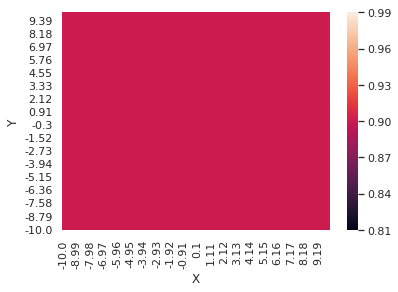

Return recorded for episode 601 :  4988.415080233088
0.010005844261397577


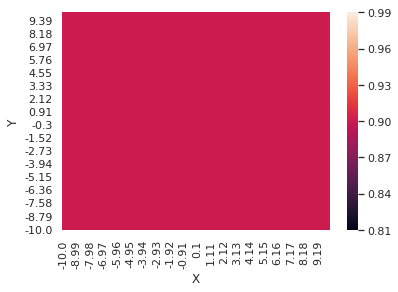

Return recorded for episode 602 :  5075.215213217734
0.010005728537268364


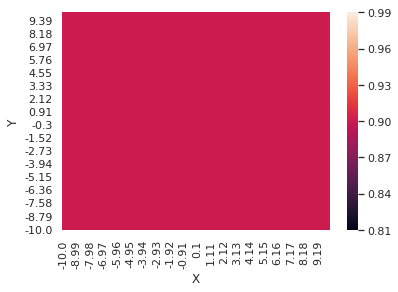

Return recorded for episode 603 :  4982.686309762593
0.010005615104630439


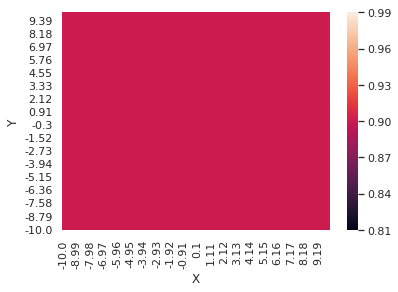

Return recorded for episode 604 :  5009.67628072305
0.010005503918109233


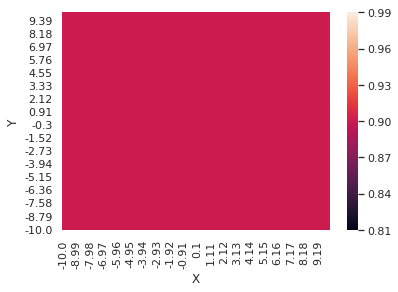

Return recorded for episode 605 :  5006.228314652359
0.01000539493322866


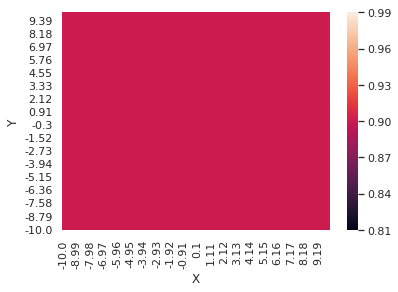

Return recorded for episode 606 :  5045.16050578838
0.010005288106393312


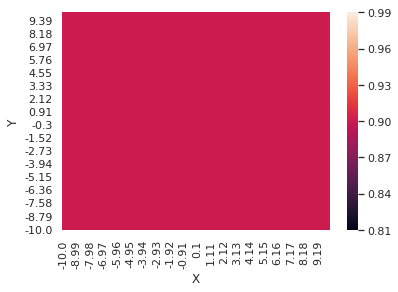

Return recorded for episode 607 :  4924.402628030931
0.010005183394871029


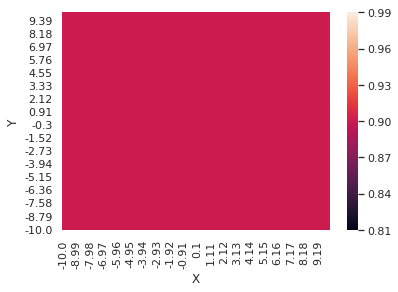

Return recorded for episode 608 :  5003.570937557422
0.010005080756775806


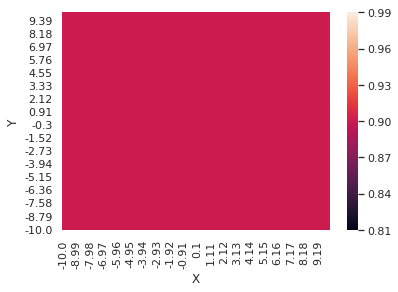

Return recorded for episode 609 :  5001.224923532027
0.01000498015105104


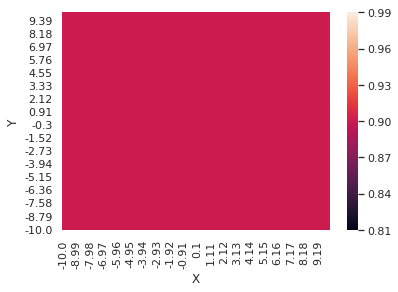

Return recorded for episode 610 :  5028.083171179135
Episode 510 ..610   Avg reward: 5005.454921184803   Epsilon: 0.0100
0.010004881537453098


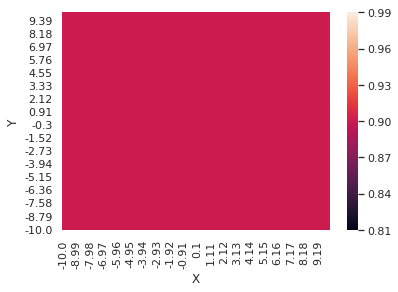

Return recorded for episode 611 :  5041.17342854806
0.010004784876535224


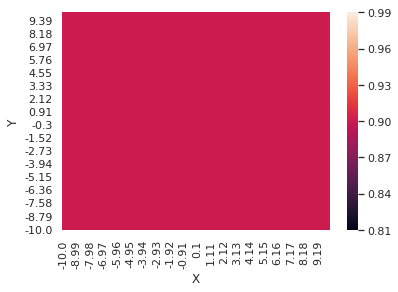

Return recorded for episode 612 :  5060.739927400722
0.010004690129631762


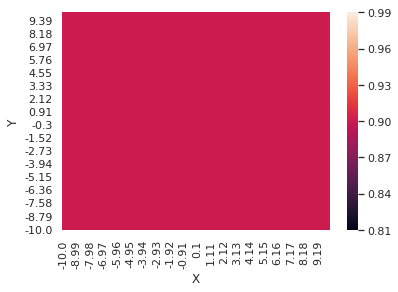

Return recorded for episode 613 :  4980.0327899930335
0.01000459725884269


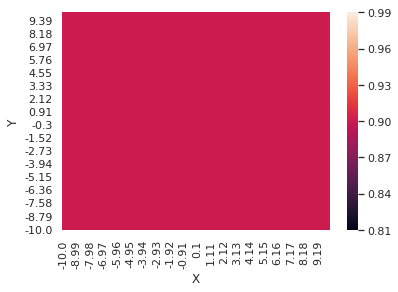

Return recorded for episode 614 :  5016.5629163232625
0.010004506227018452


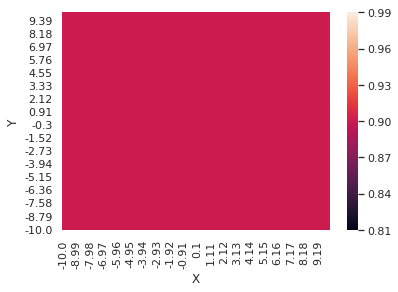

Return recorded for episode 615 :  4995.818365250042
0.010004416997745106


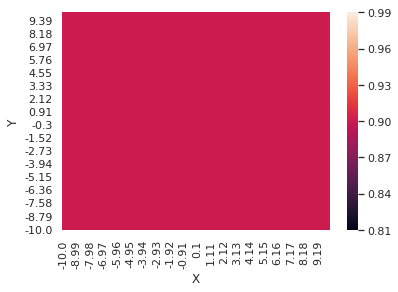

Return recorded for episode 616 :  5014.158743904805
0.010004329535329752


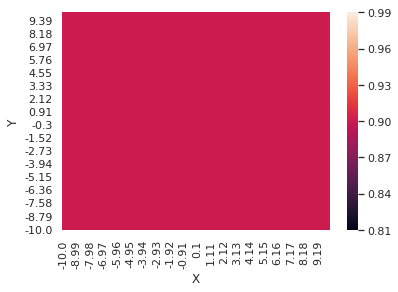

Return recorded for episode 617 :  4971.83744102388
0.010004243804786258


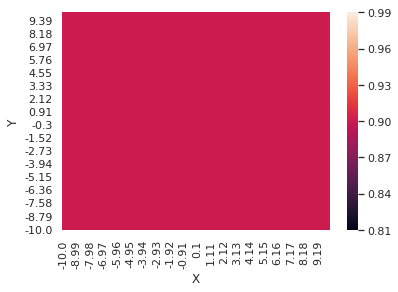

Return recorded for episode 618 :  4993.738443733277
0.010004159771821263


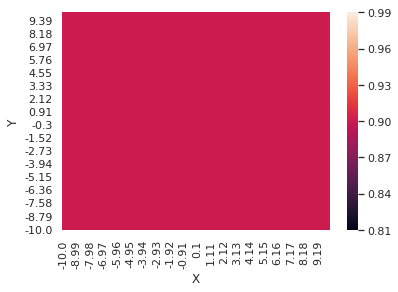

Return recorded for episode 619 :  5028.23596832093
0.010004077402820461


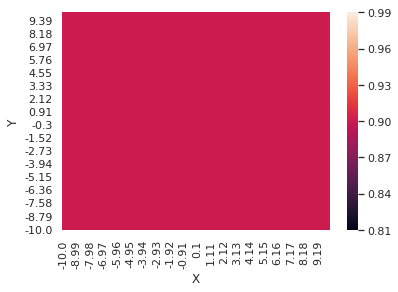

Return recorded for episode 620 :  4991.739342629307
Episode 520 ..620   Avg reward: 5013.038119567715   Epsilon: 0.0100
0.010003996664835153


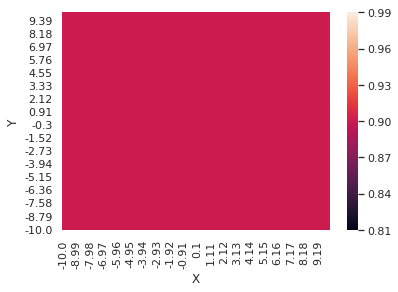

Return recorded for episode 621 :  5027.599792695881
0.010003917525569068


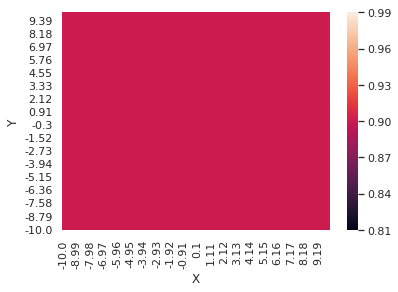

Return recorded for episode 622 :  5008.767616888575
0.010003839953365446


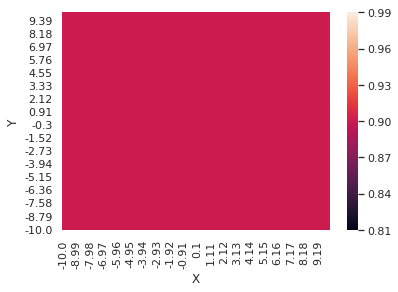

Return recorded for episode 623 :  5035.0440973522145
0.01000376391719437


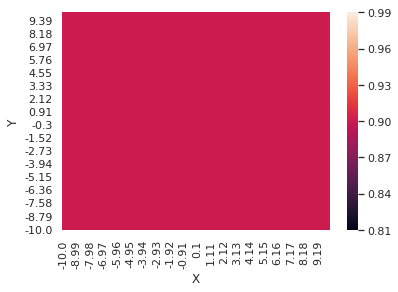

Return recorded for episode 624 :  4965.864695960693
0.010003689386640358


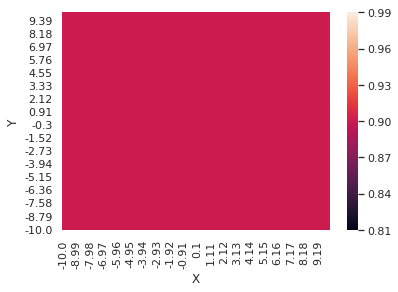

Return recorded for episode 625 :  5050.1629846908245
0.010003616331890194


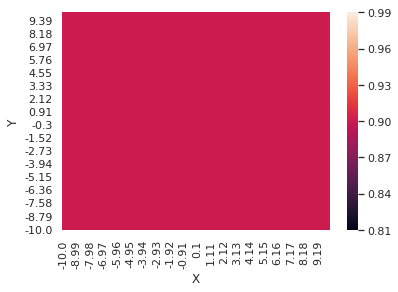

Return recorded for episode 626 :  4996.579085567586
0.010003544723721006


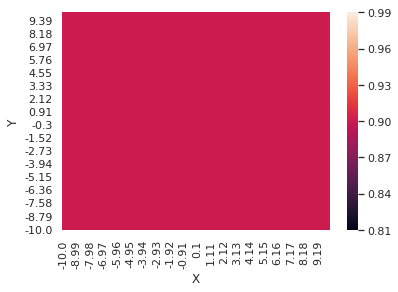

Return recorded for episode 627 :  5042.532033262197
0.01000347453348857


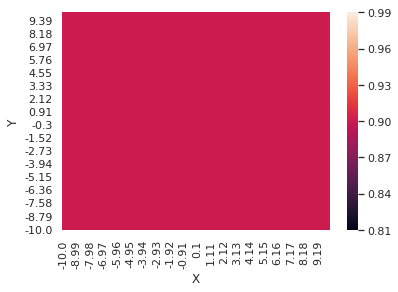

Return recorded for episode 628 :  4965.544789819349
0.010003405733115854


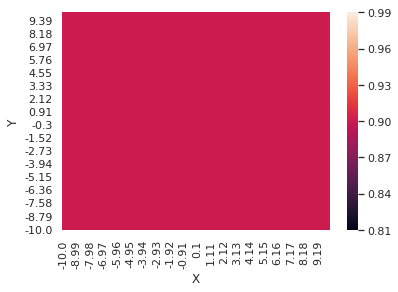

Return recorded for episode 629 :  4980.110997241599
0.010003338295081798


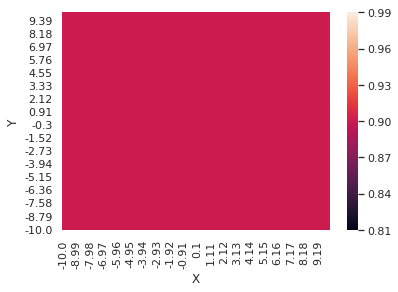

Return recorded for episode 630 :  5038.782797591562
Episode 530 ..630   Avg reward: 5006.394543610823   Epsilon: 0.0100
0.010003272192410284


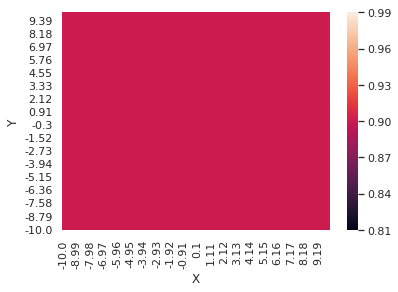

Return recorded for episode 631 :  5036.904127809698
0.010003207398659366


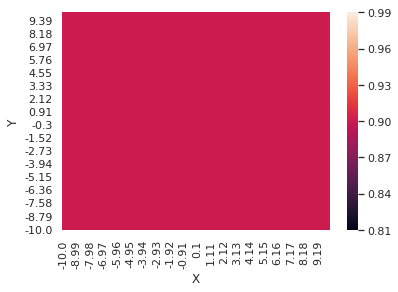

Return recorded for episode 632 :  4999.14118146053
0.010003143887910676


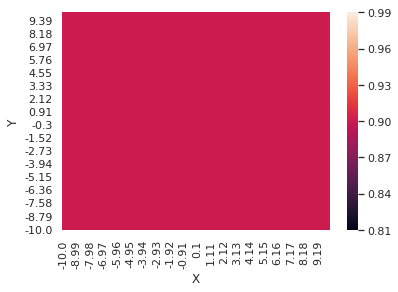

Return recorded for episode 633 :  5071.0138535421465
0.01000308163475907


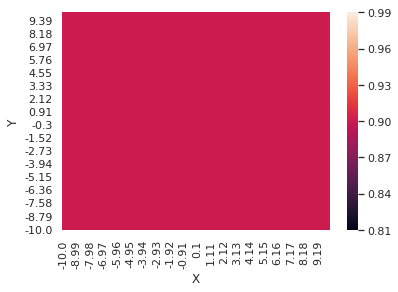

Return recorded for episode 634 :  4966.563321822045
0.010003020614302456


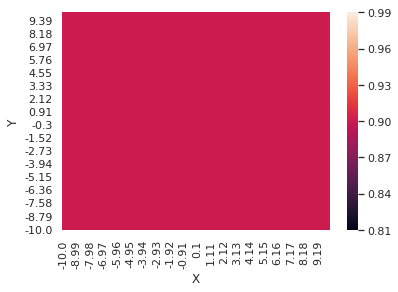

Return recorded for episode 635 :  5042.604332848239
0.010002960802131838


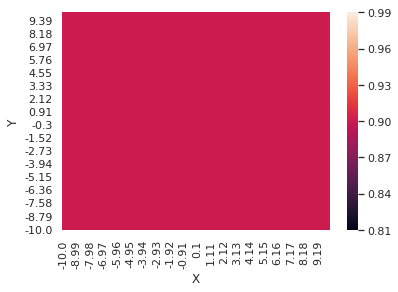

Return recorded for episode 636 :  4969.957797443824
0.010002902174321553


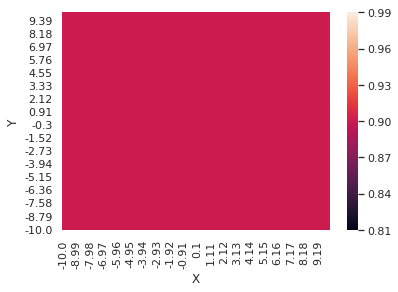

Return recorded for episode 637 :  4952.799018656685
0.01000284470741969


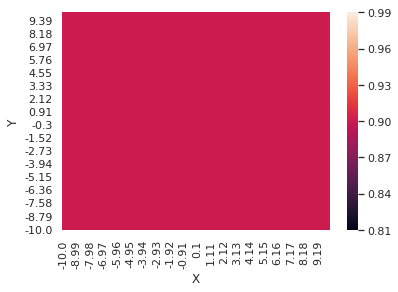

Return recorded for episode 638 :  4976.2032642055565
0.010002788378438727


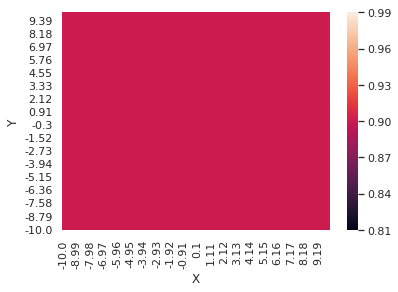

Return recorded for episode 639 :  5005.4791535800705
0.010002733164846317


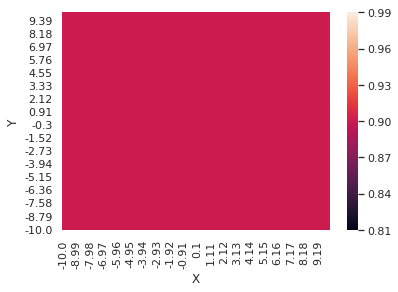

Return recorded for episode 640 :  5012.998431252612
Episode 540 ..640   Avg reward: 5005.944884896036   Epsilon: 0.0100
0.010002679044556288


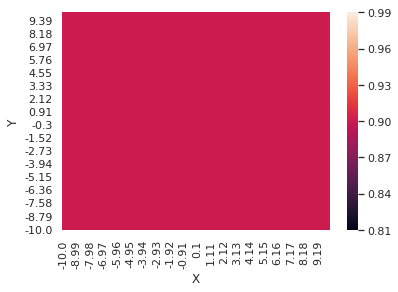

Return recorded for episode 641 :  5104.54443141392
0.010002625995919804


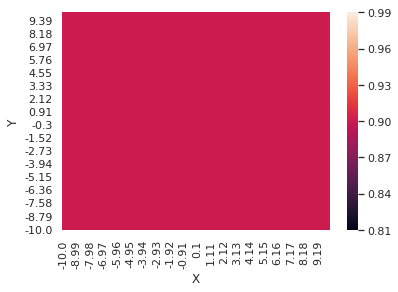

Return recorded for episode 642 :  4995.392192827809
0.0100025739977167


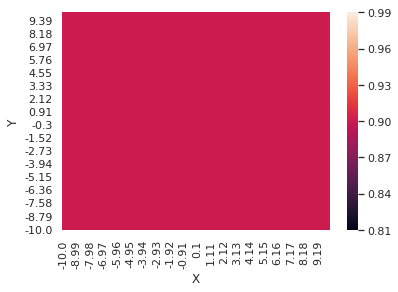

Return recorded for episode 643 :  5094.00235075257
0.010002523029147005


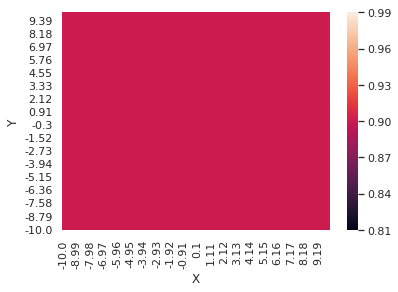

Return recorded for episode 644 :  5040.574874647271
0.010002473069822607


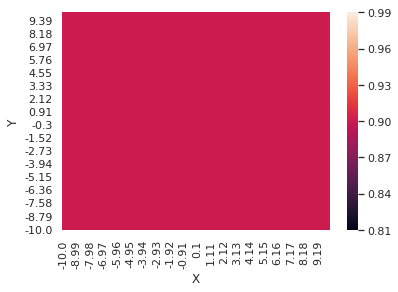

Return recorded for episode 645 :  5071.858792801752
0.010002424099759115


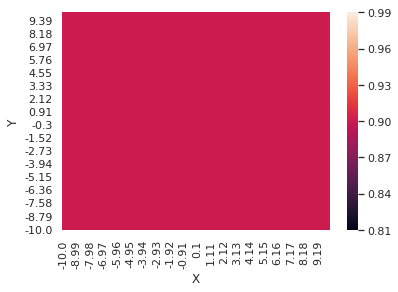

Return recorded for episode 646 :  5031.128071713882
0.010002376099367848


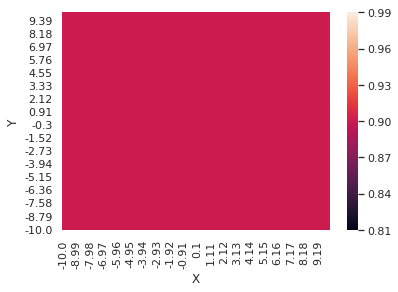

Return recorded for episode 647 :  5033.780094615799
0.01000232904944801


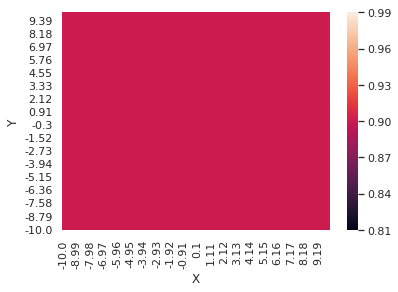

Return recorded for episode 648 :  4976.8397113152505
0.010002282931179005


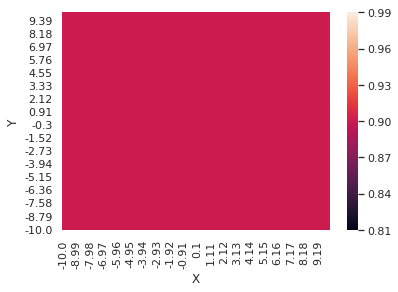

Return recorded for episode 649 :  4993.92815974875
0.010002237726112912


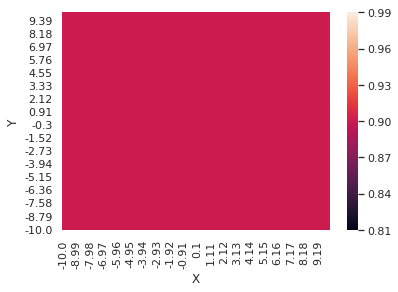

Return recorded for episode 650 :  5007.267267778169
Episode 550 ..650   Avg reward: 5035.504711108962   Epsilon: 0.0100
0.0100021934161671


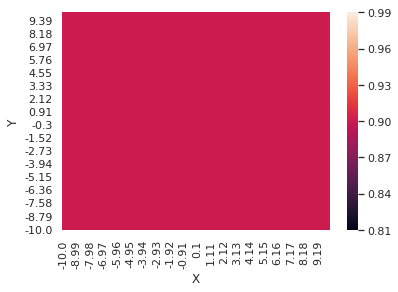

Return recorded for episode 651 :  5093.937301272979
0.010002149983617


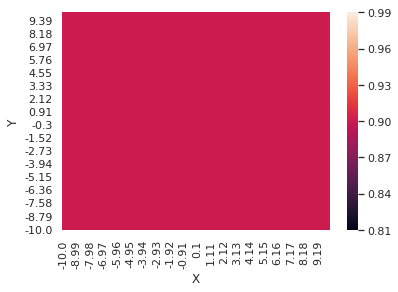

Return recorded for episode 652 :  4994.908198005484
0.010002107411089015


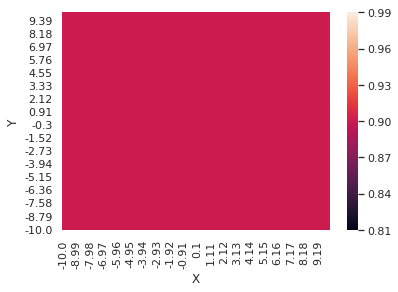

Return recorded for episode 653 :  4983.206561857104
0.010002065681553565


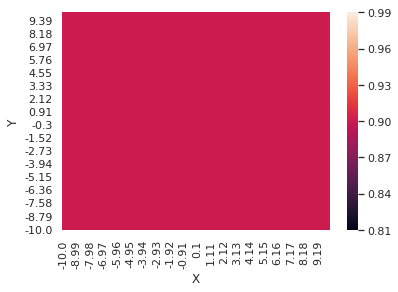

Return recorded for episode 654 :  5038.805478428995
0.010002024778318278


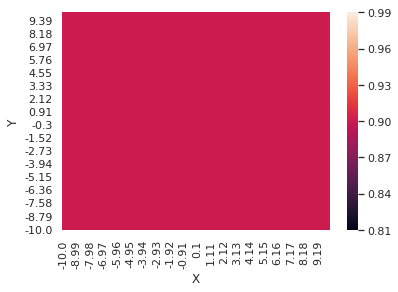

Return recorded for episode 655 :  4976.583739439273
0.010001984685021318


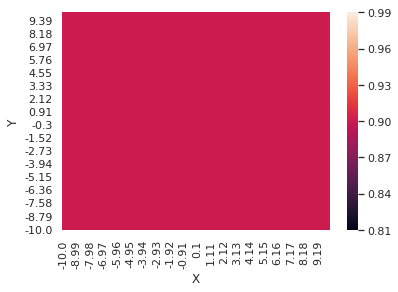

Return recorded for episode 656 :  4985.908431710488
0.010001945385624827


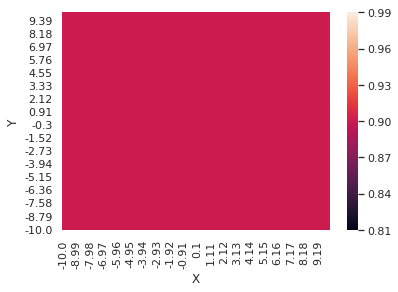

Return recorded for episode 657 :  5016.368465131848
0.010001906864408525


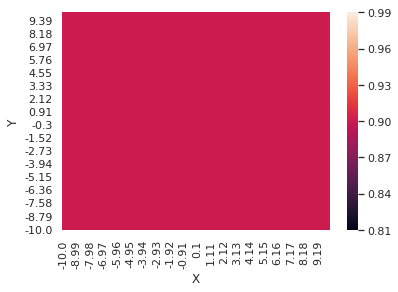

Return recorded for episode 658 :  4993.360896140934
0.010001869105963412


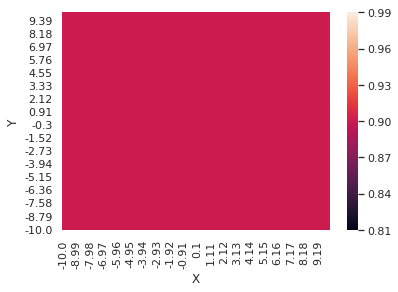

Return recorded for episode 659 :  5038.5882850561675
0.010001832095185606


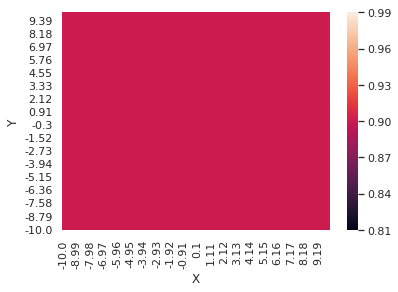

Return recorded for episode 660 :  5037.992116241337
Episode 560 ..660   Avg reward: 5012.893462482144   Epsilon: 0.0100
0.010001795817270303


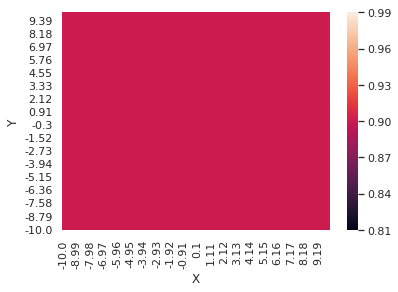

Return recorded for episode 661 :  4996.321585408634
0.010001760257705852


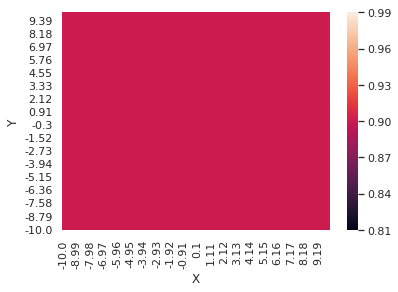

Return recorded for episode 662 :  5009.988157071594
0.010001725402267955


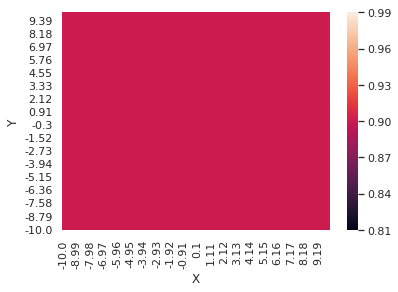

Return recorded for episode 663 :  4989.471497803387
0.01000169123701397


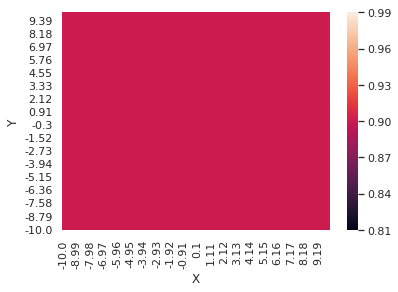

Return recorded for episode 664 :  5016.693134435532
0.01000165774827734


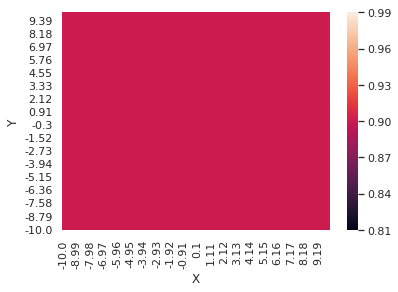

Return recorded for episode 665 :  5027.811729438585
0.010001624922662126


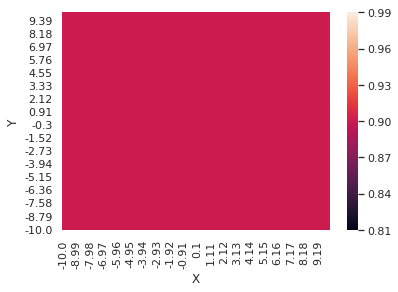

Return recorded for episode 666 :  5018.622392290464
0.010001592747037642


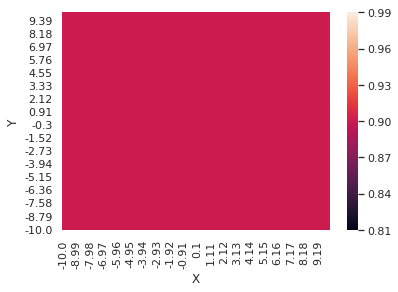

Return recorded for episode 667 :  4990.031485636696
0.010001561208533209


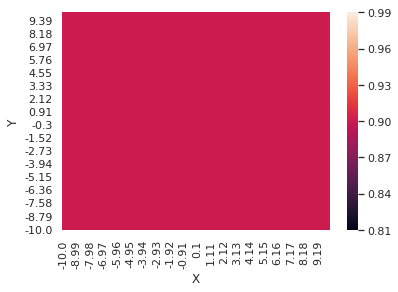

Return recorded for episode 668 :  4974.377277660876
0.010001530294533007


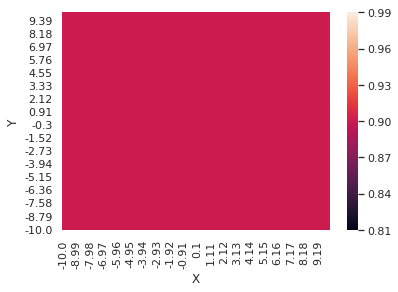

Return recorded for episode 669 :  5033.109931024068
0.010001499992671022


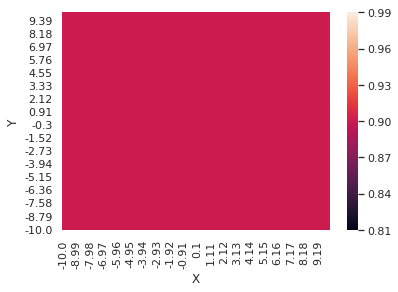

Return recorded for episode 670 :  5018.71982504934
Episode 570 ..670   Avg reward: 5009.441930701118   Epsilon: 0.0100
0.010001470290826106


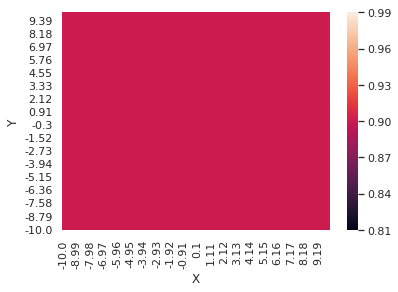

Return recorded for episode 671 :  5088.4674383577985
0.010001441177117125


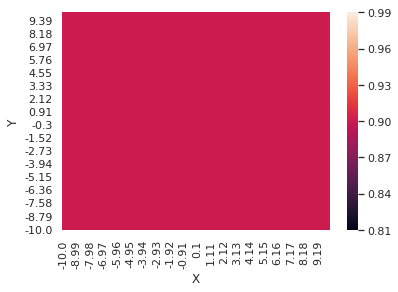

Return recorded for episode 672 :  4998.48698065776
0.010001412639898205


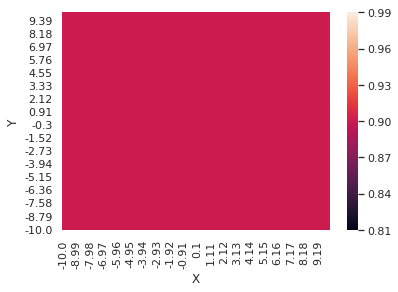

Return recorded for episode 673 :  5009.97818049991
0.01000138466775408


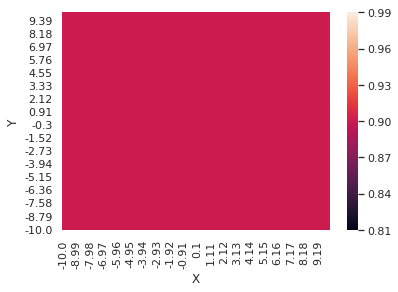

Return recorded for episode 674 :  4994.284749234974
0.01000135724949552


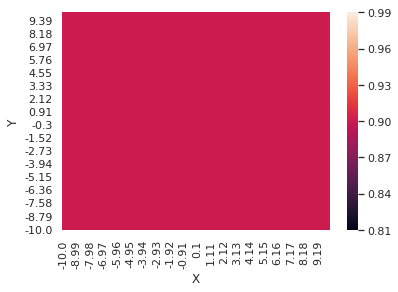

Return recorded for episode 675 :  4989.421653317069
0.010001330374154856


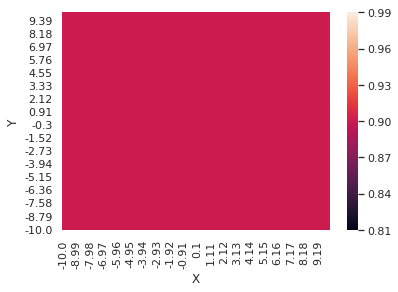

Return recorded for episode 676 :  5032.244643619741
0.010001304030981591


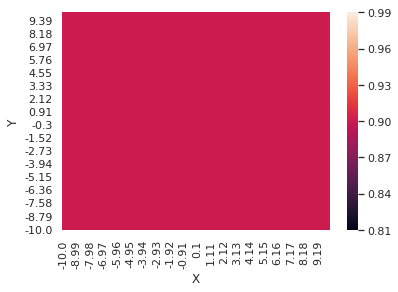

Return recorded for episode 677 :  5021.70683990567
0.010001278209438106


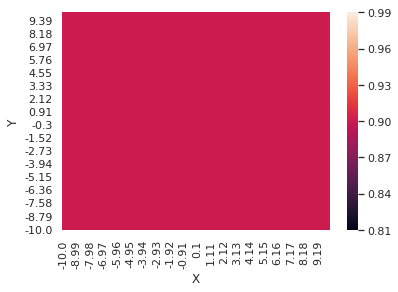

Return recorded for episode 678 :  5005.984358332422
0.01000125289919544


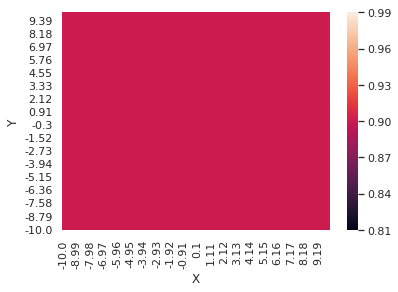

Return recorded for episode 679 :  5020.556680859041
0.010001228090129157


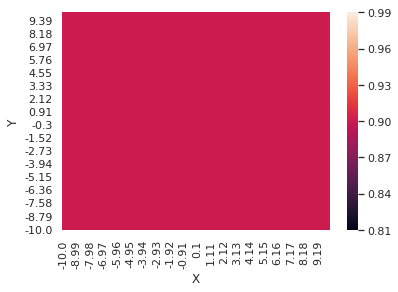

Return recorded for episode 680 :  5039.6565179842555
Episode 580 ..680   Avg reward: 5017.9851349833725   Epsilon: 0.0100
0.0100012037723153


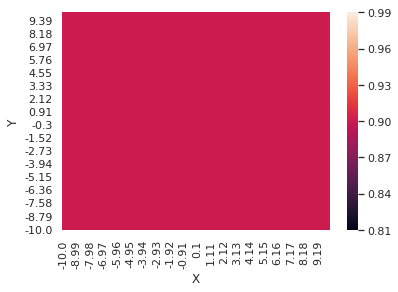

Return recorded for episode 681 :  5021.456661049291
0.010001179936026422


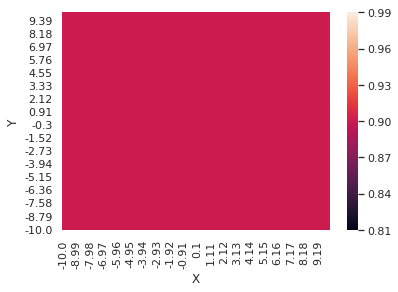

Return recorded for episode 682 :  5012.620378933394
0.010001156571727685


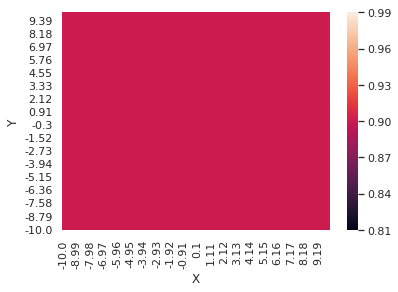

Return recorded for episode 683 :  5043.216945473294
0.010001133670073062


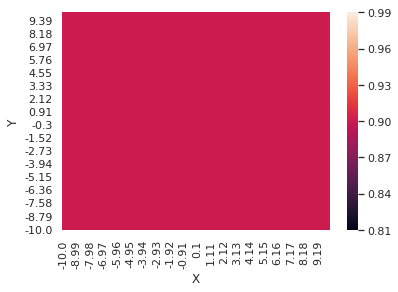

Return recorded for episode 684 :  5005.8063084979885
0.010001111221901582


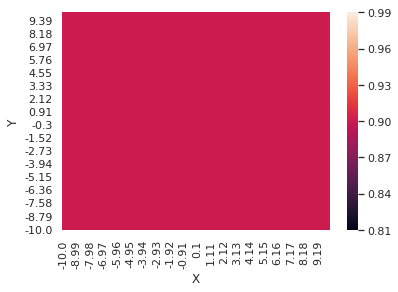

Return recorded for episode 685 :  5059.877891144885
0.01000108921823368


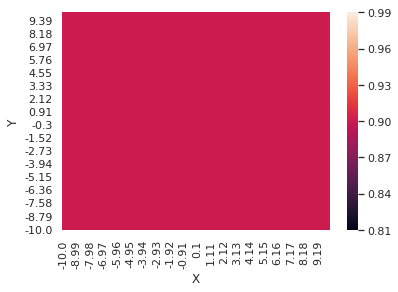

Return recorded for episode 686 :  4992.954789139066
0.010001067650267596


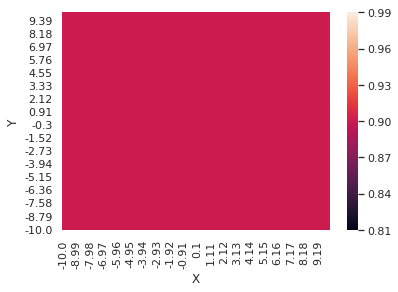

Return recorded for episode 687 :  4964.575961487009
0.010001046509375852


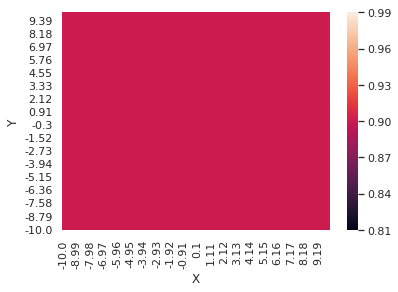

Return recorded for episode 688 :  5009.574069734057
0.010001025787101813


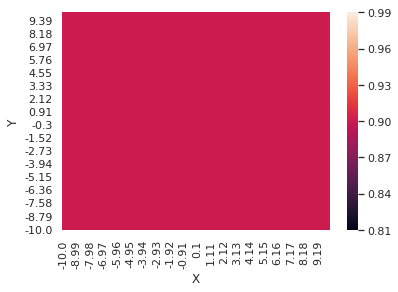

Return recorded for episode 689 :  4995.8185525907065
0.010001005475156293


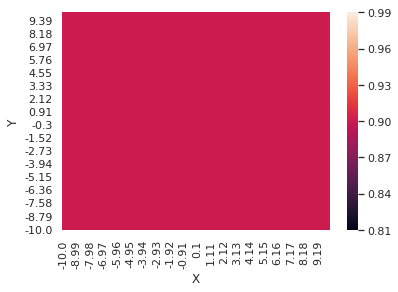

Return recorded for episode 690 :  5001.308836554385
Episode 590 ..690   Avg reward: 5014.555807603395   Epsilon: 0.0100
0.01000098556541424


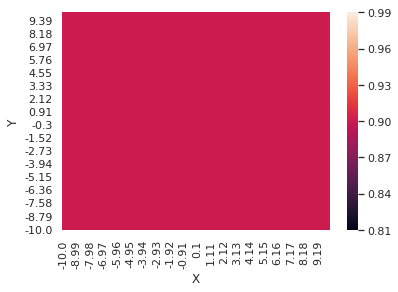

Return recorded for episode 691 :  5024.901492963038
0.010000966049911497


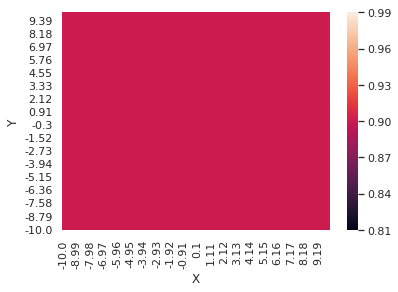

Return recorded for episode 692 :  5040.708707558671
0.010000946920841596


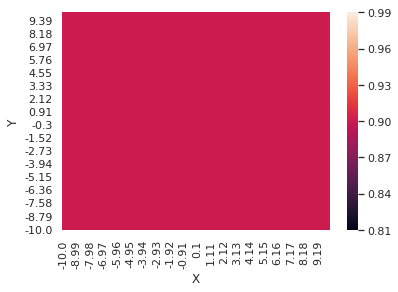

Return recorded for episode 693 :  4996.722439257057
0.01000092817055266


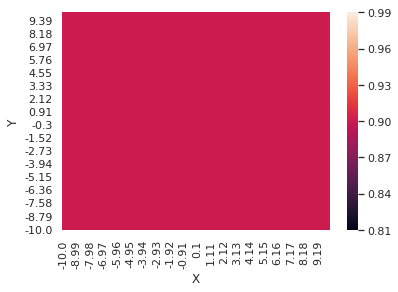

Return recorded for episode 694 :  4974.877771236866
0.010000909791544318


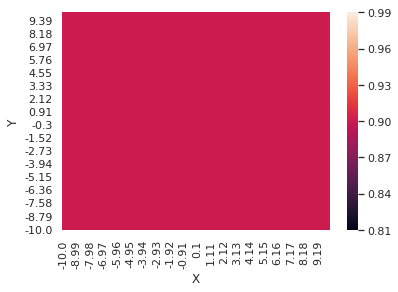

Return recorded for episode 695 :  5011.774519484191
0.010000891776464727


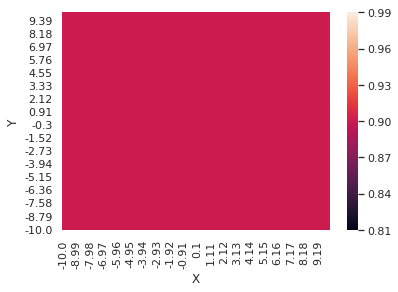

Return recorded for episode 696 :  5048.831386956361
0.010000874118107612


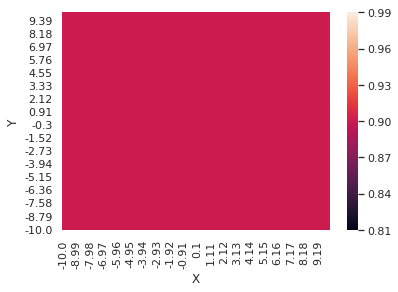

Return recorded for episode 697 :  5019.216190136121
0.010000856809409394


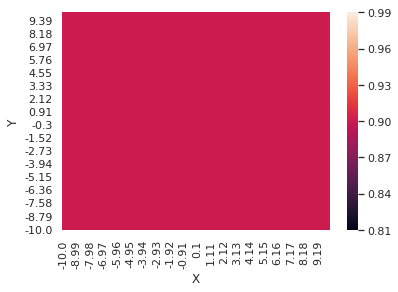

Return recorded for episode 698 :  5046.892443857722
0.010000839843446366


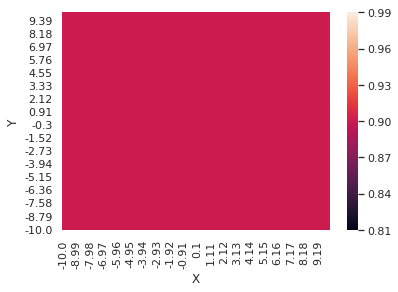

Return recorded for episode 699 :  4983.667235649704
0.010000823213431913


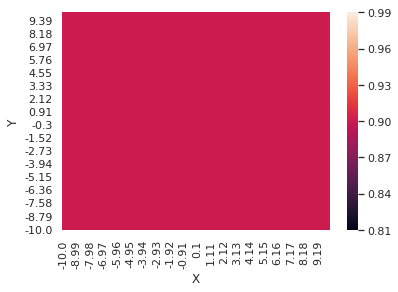

Return recorded for episode 700 :  5036.93479045897
Episode 600 ..700   Avg reward: 5014.8901023654125   Epsilon: 0.0100
0.01000080691271381


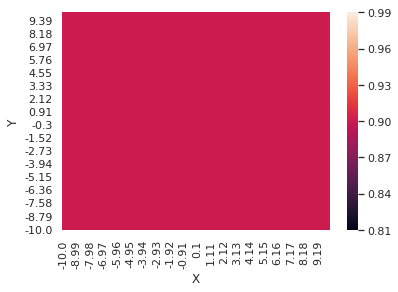

Return recorded for episode 701 :  4979.193764952745
0.01000079093477155


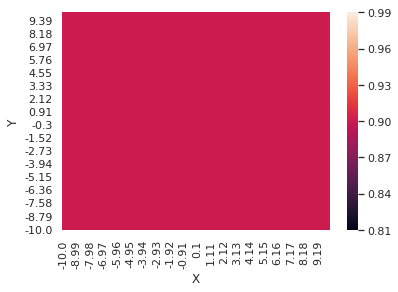

Return recorded for episode 702 :  5030.113706647069
0.010000775273213745


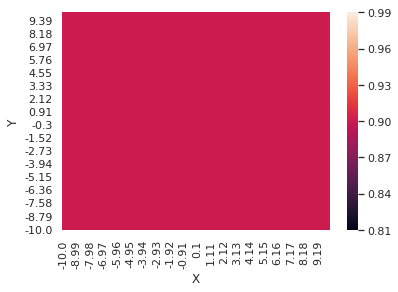

Return recorded for episode 703 :  4973.633779881312
0.010000759921775564


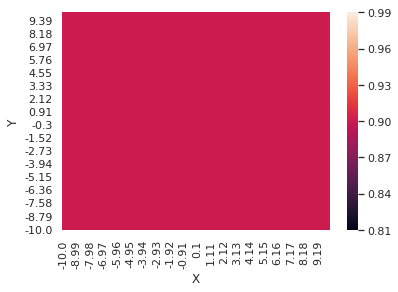

Return recorded for episode 704 :  5033.470378269174
0.010000744874316224


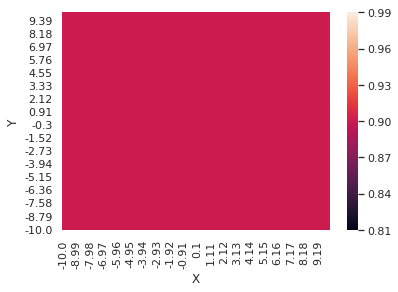

Return recorded for episode 705 :  4985.118438544121
0.010000730124816544


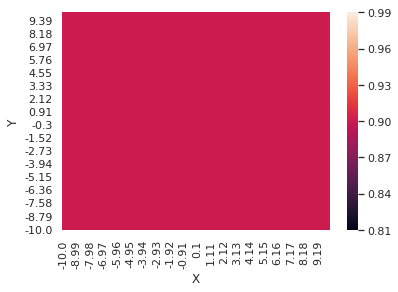

Return recorded for episode 706 :  4993.03075652906
0.010000715667376524


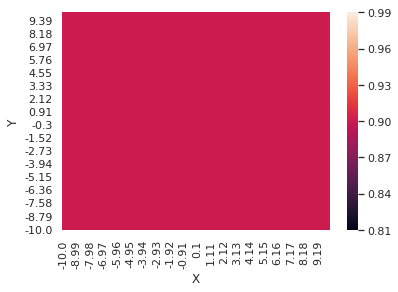

Return recorded for episode 707 :  5052.073423024383
0.010000701496212999


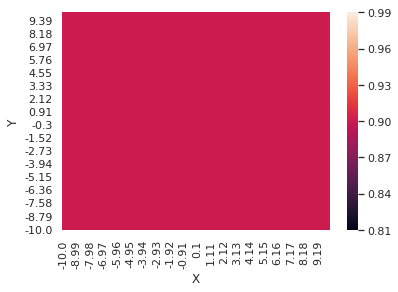

Return recorded for episode 708 :  5034.161860589932
0.01000068760565731


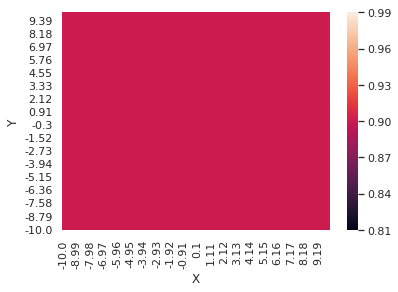

Return recorded for episode 709 :  5006.8022198872195
0.010000673990153053


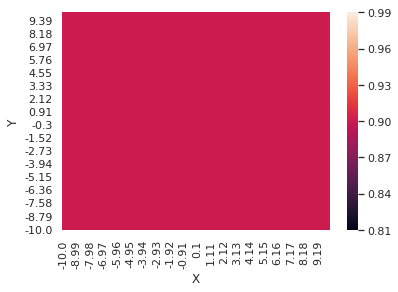

Return recorded for episode 710 :  5002.5333625017665
Episode 610 ..710   Avg reward: 5012.4533118784   Epsilon: 0.0100
0.010000660644253844


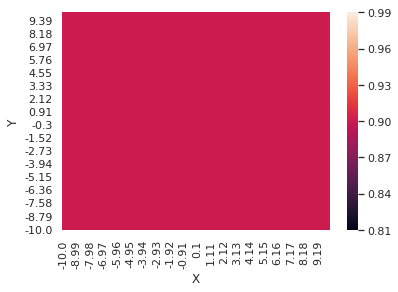

Return recorded for episode 711 :  4959.25911652943
0.010000647562621147


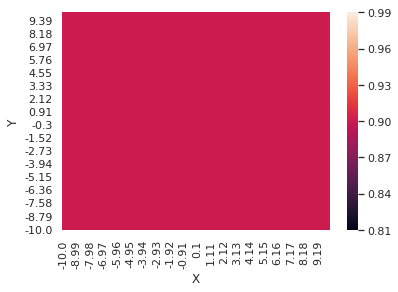

Return recorded for episode 712 :  4966.130753036467
0.010000634740022132


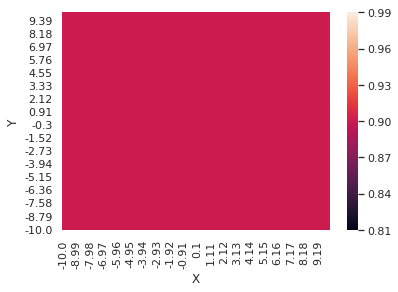

Return recorded for episode 713 :  4989.476365495028
0.010000622171327588


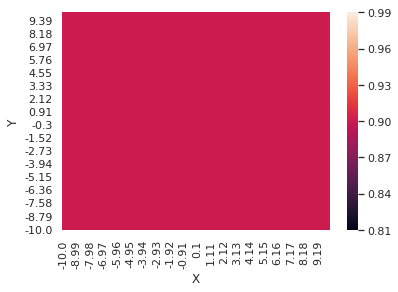

Return recorded for episode 714 :  4974.485159799123
0.01000060985150987


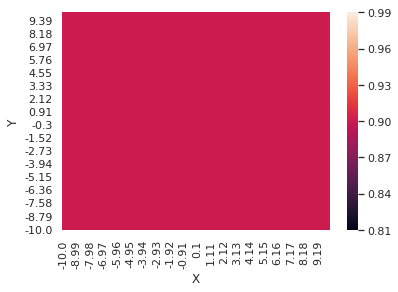

Return recorded for episode 715 :  4984.401587895573
0.01000059777564089


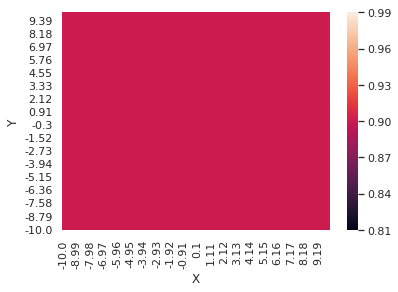

Return recorded for episode 716 :  5062.900992988154
0.010000585938890135


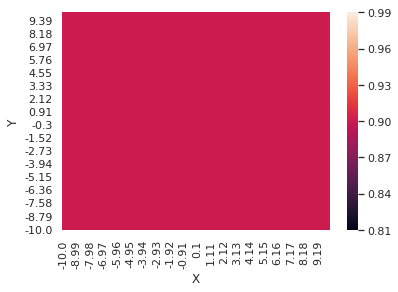

Return recorded for episode 717 :  5005.1770244863255
0.010000574336522749


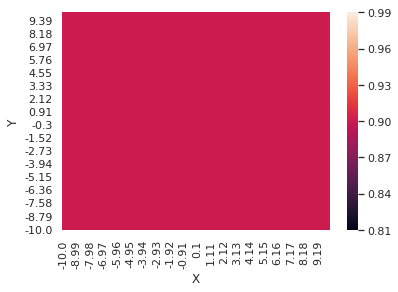

Return recorded for episode 718 :  5003.13897976811
0.010000562963897631


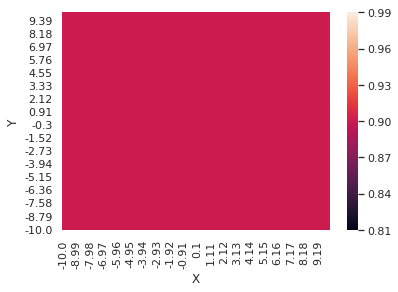

Return recorded for episode 719 :  5017.550263671224
0.010000551816465577


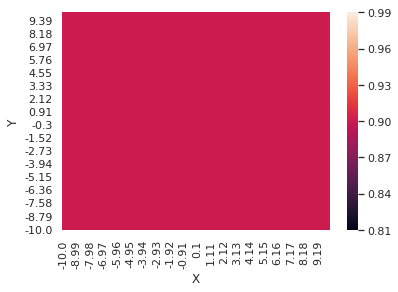

Return recorded for episode 720 :  5081.882912636531
Episode 620 ..720   Avg reward: 4996.5053606171205   Epsilon: 0.0100
0.010000540889767467


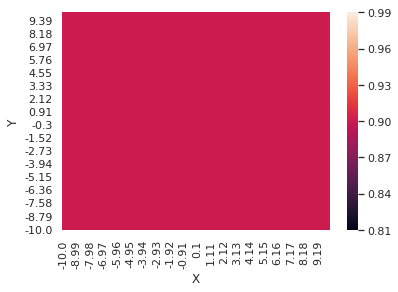

Return recorded for episode 721 :  4970.74704784628
0.010000530179432476


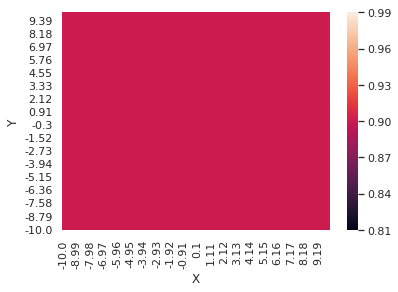

Return recorded for episode 722 :  5025.01093263562
0.010000519681176328


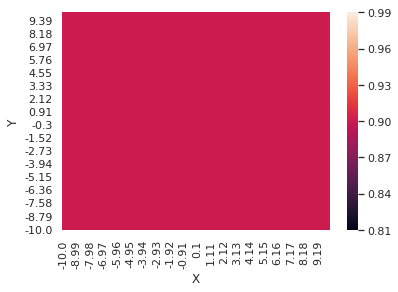

Return recorded for episode 723 :  5059.764701055994
0.01000050939079958


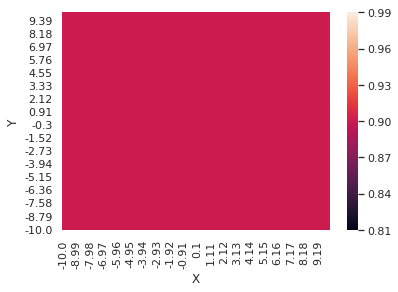

Return recorded for episode 724 :  5036.145531756175
0.010000499304185942


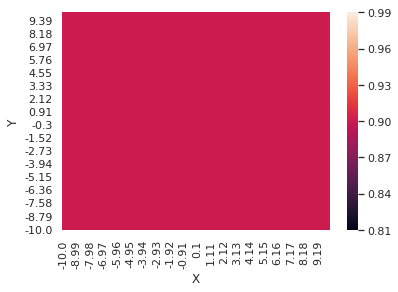

Return recorded for episode 725 :  5030.906451299083
0.010000489417300638


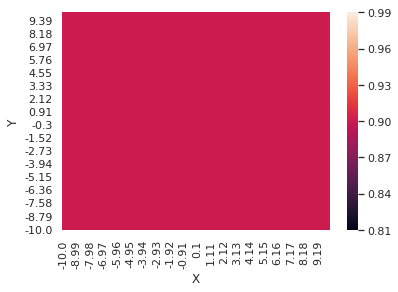

Return recorded for episode 726 :  5061.08910911625
0.010000479726188779


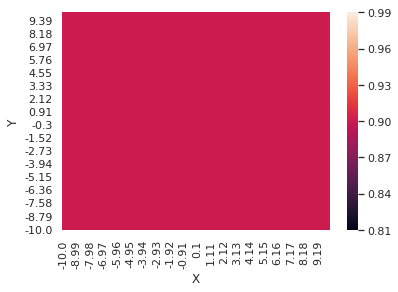

Return recorded for episode 727 :  5008.65889626281
0.010000470226973791


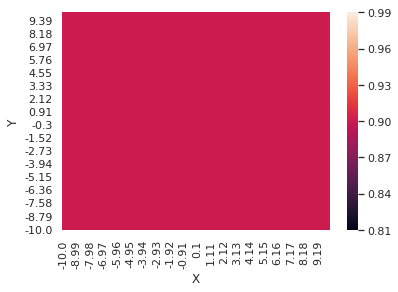

Return recorded for episode 728 :  5099.157759789217
0.010000460915855863


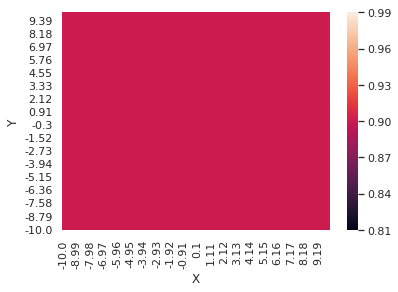

Return recorded for episode 729 :  5007.640142559178
0.010000451789110423


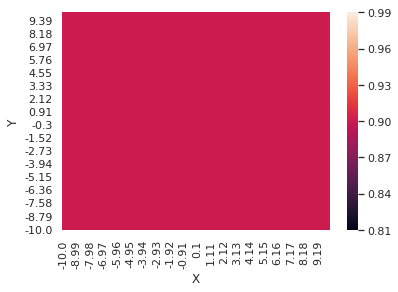

Return recorded for episode 730 :  5008.457052379942
Episode 630 ..730   Avg reward: 5038.100348495713   Epsilon: 0.0100
0.01000044284308665


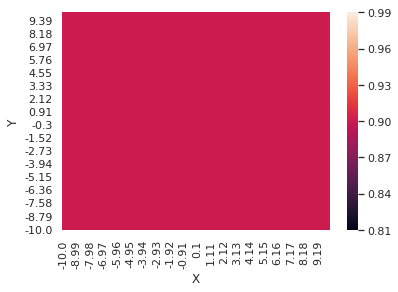

Return recorded for episode 731 :  4971.389076559308
0.010000434074206019


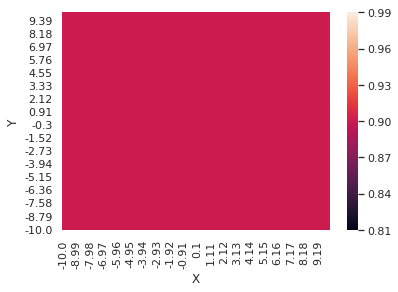

Return recorded for episode 732 :  4993.640712636763
0.010000425478960856


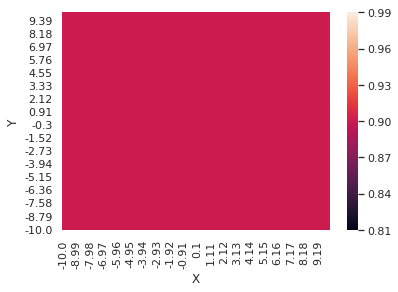

Return recorded for episode 733 :  4975.48920206238
0.010000417053912952


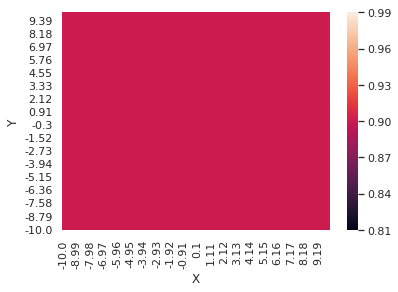

Return recorded for episode 734 :  5003.010436924397
0.010000408795692172


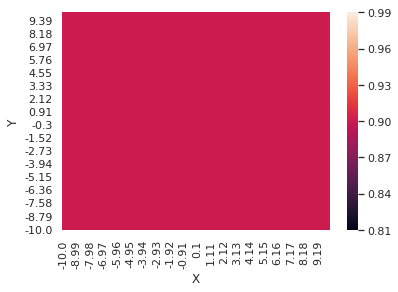

Return recorded for episode 735 :  5043.1006093738015
0.010000400700995121


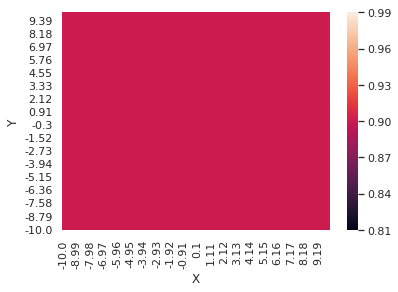

Return recorded for episode 736 :  4982.652687479447
0.010000392766583809


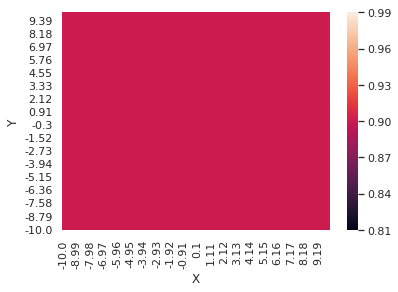

Return recorded for episode 737 :  5037.548834561693
0.010000384989284369


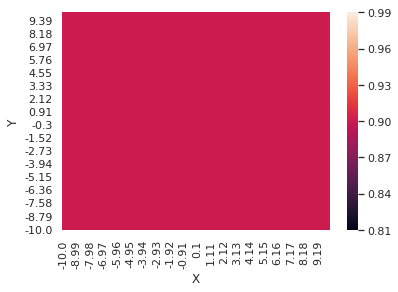

Return recorded for episode 738 :  4978.9111318733
0.010000377365985776


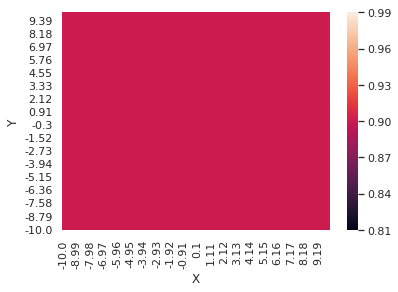

Return recorded for episode 739 :  4989.4288136012765
0.01000036989363861


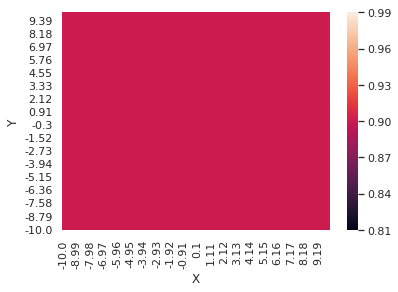

Return recorded for episode 740 :  5019.430523378516
Episode 640 ..740   Avg reward: 4998.36285574523   Epsilon: 0.0100
0.010000362569253829


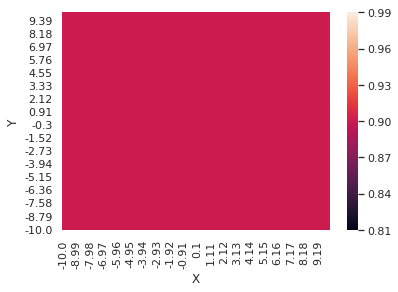

Return recorded for episode 741 :  4994.932273455888
0.010000355389901586


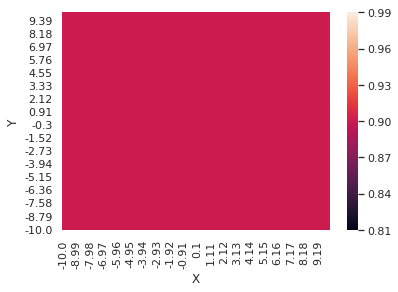

Return recorded for episode 742 :  5057.472859418725
0.010000348352710041


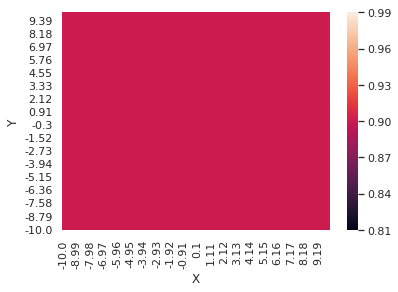

Return recorded for episode 743 :  5044.304327497311
0.010000341454864224


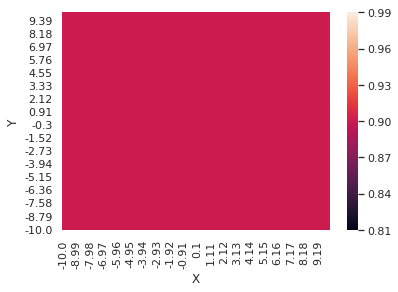

Return recorded for episode 744 :  4970.826848182833
0.010000334693604907


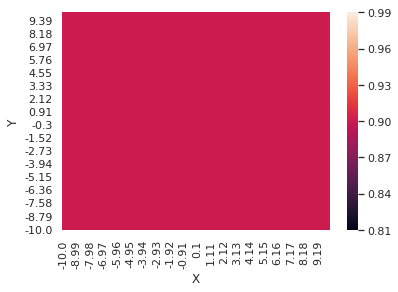

Return recorded for episode 745 :  5052.964419538659
0.010000328066227493


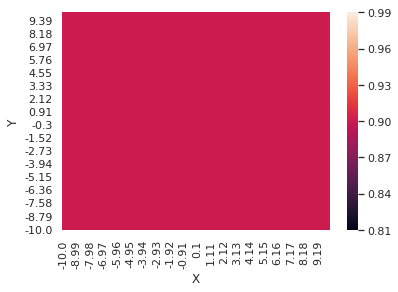

Return recorded for episode 746 :  5017.5139533058145
0.010000321570080946


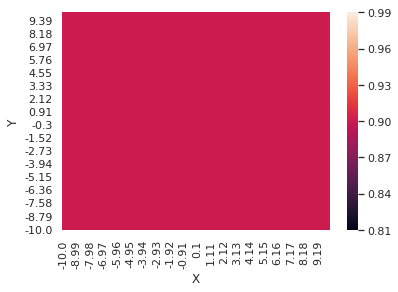

Return recorded for episode 747 :  5046.141970235697
0.010000315202566718


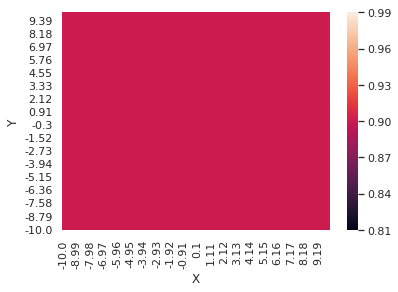

Return recorded for episode 748 :  5029.920833573124
0.010000308961137721


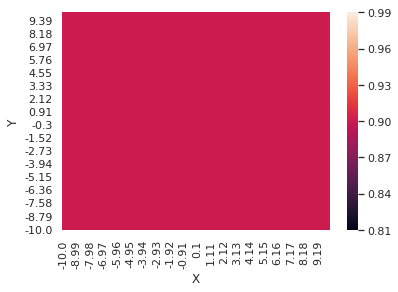

Return recorded for episode 749 :  4998.918078027935
0.010000302843297297


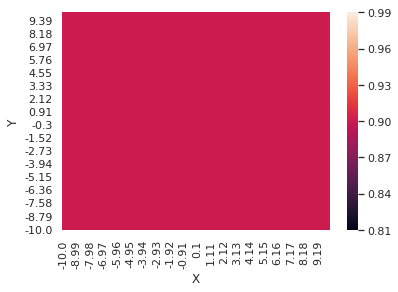

Return recorded for episode 750 :  4989.924622067521
Episode 650 ..750   Avg reward: 5023.24260866145   Epsilon: 0.0100
0.01000029684659823


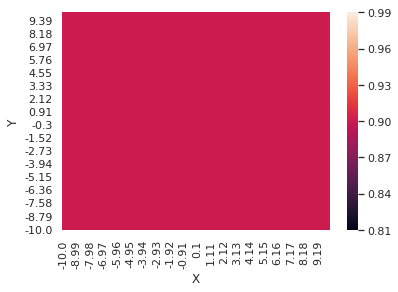

Return recorded for episode 751 :  5020.52091300355
0.01000029096864176


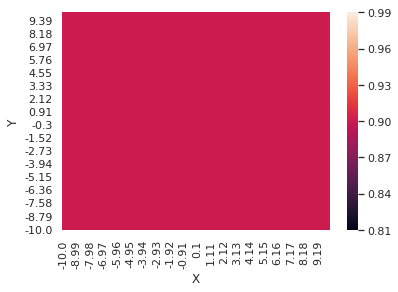

Return recorded for episode 752 :  5019.267762596204
0.010000285207076628


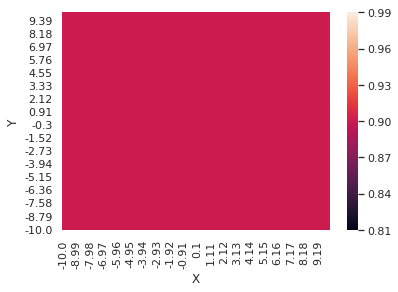

Return recorded for episode 753 :  5024.9948334207775
0.010000279559598129


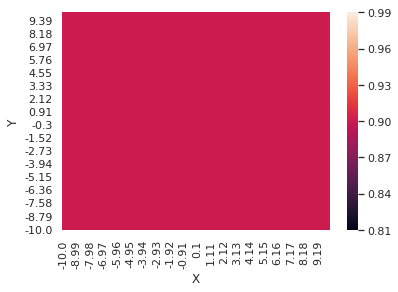

Return recorded for episode 754 :  5025.385422867017
0.010000274023947195


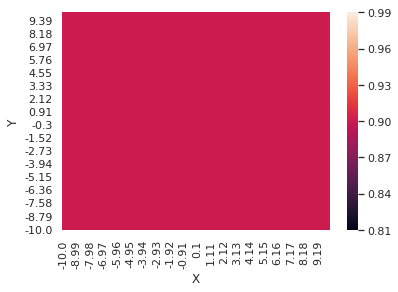

Return recorded for episode 755 :  5058.349316850056
0.010000268597909496


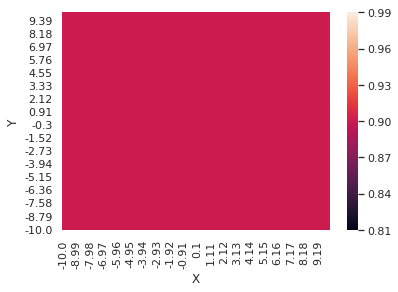

Return recorded for episode 756 :  4964.887816730444
0.01000026327931454


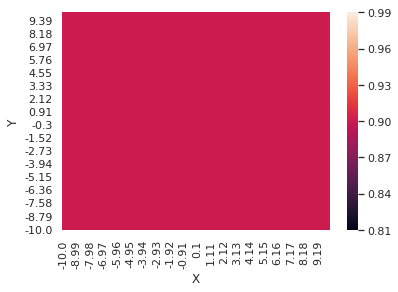

Return recorded for episode 757 :  5051.044603454274
0.010000258066034821


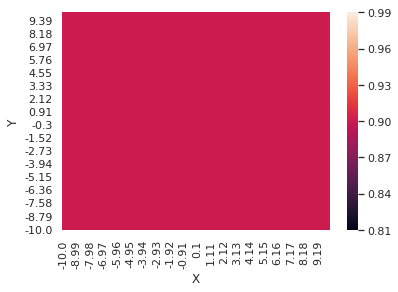

Return recorded for episode 758 :  5002.750122771802
0.010000252955984957


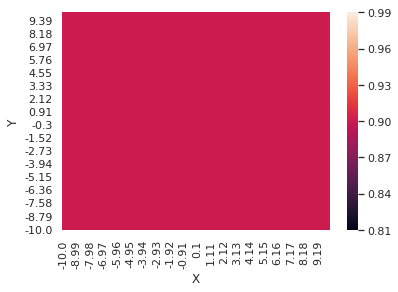

Return recorded for episode 759 :  5003.788268358927
0.010000247947120861


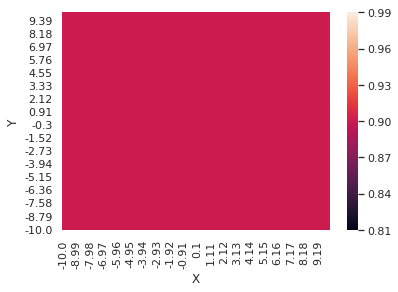

Return recorded for episode 760 :  4975.690147215544
Episode 660 ..760   Avg reward: 5016.091368212057   Epsilon: 0.0100
0.010000243037438917


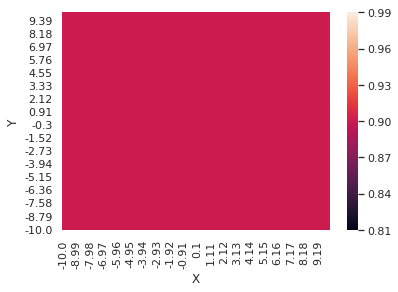

Return recorded for episode 761 :  5027.730145060598
0.010000238224975191


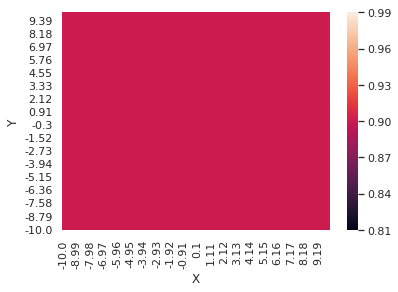

Return recorded for episode 762 :  5012.630304774252
0.01000023350780463


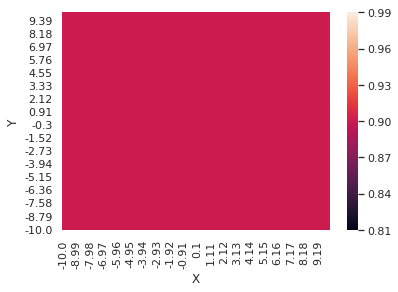

Return recorded for episode 763 :  5038.645509430318
0.010000228884040306


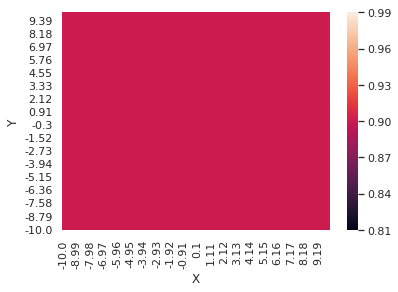

Return recorded for episode 764 :  5038.786298781765
0.010000224351832648


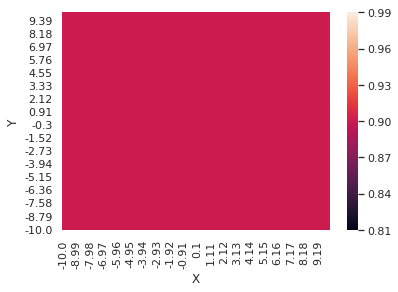

Return recorded for episode 765 :  5066.8501549815965
0.010000219909368717


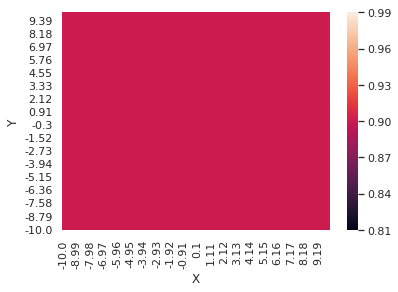

Return recorded for episode 766 :  4990.824763938674
0.010000215554871463


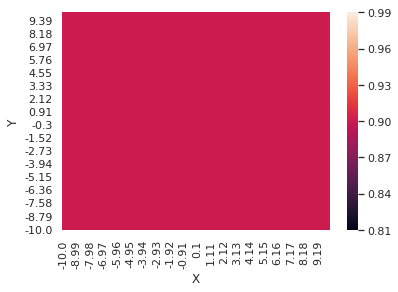

Return recorded for episode 767 :  4999.537914417491
0.010000211286599033


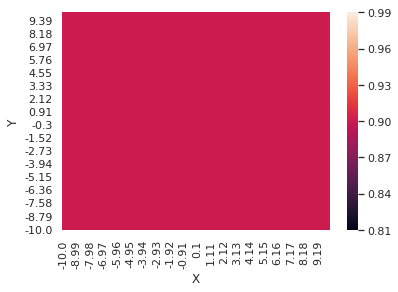

Return recorded for episode 768 :  4957.964426272901
0.01000020710284406


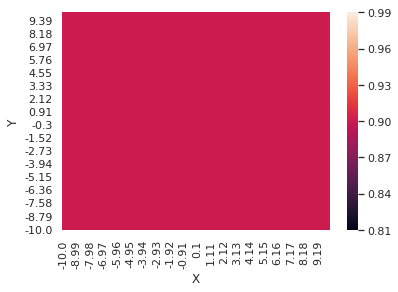

Return recorded for episode 769 :  5037.251765129251
0.010000203001932986


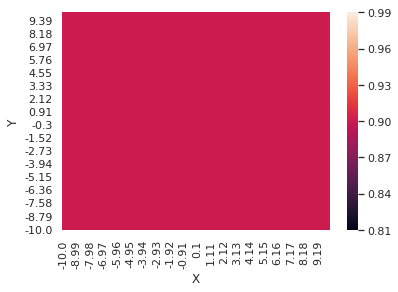

Return recorded for episode 770 :  4985.225959632848
Episode 670 ..770   Avg reward: 5014.591143000239   Epsilon: 0.0100
0.010000198982225391


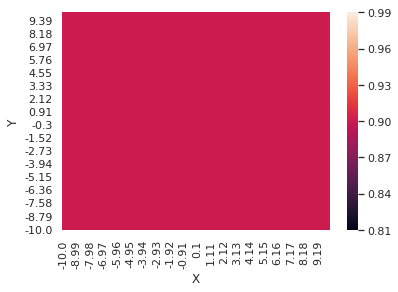

Return recorded for episode 771 :  5062.058764598534
0.01000019504211334


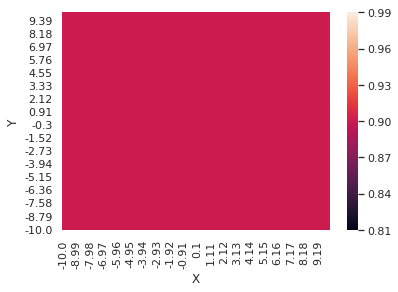

Return recorded for episode 772 :  5019.243120179524
0.010000191180020735


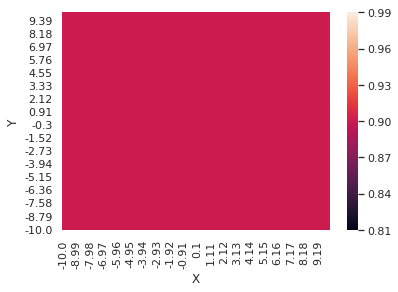

Return recorded for episode 773 :  5027.354776003329
0.010000187394402687


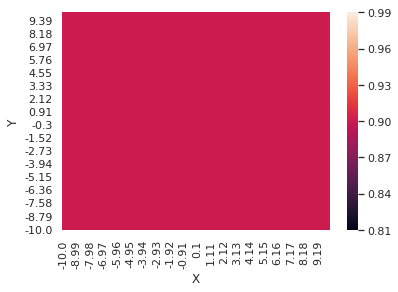

Return recorded for episode 774 :  5025.873232907764
0.010000183683744899


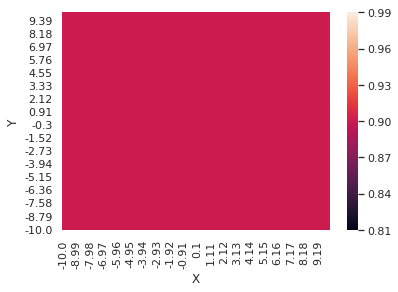

Return recorded for episode 775 :  4986.12693451218
0.010000180046563058


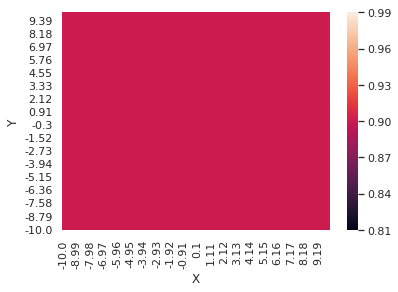

Return recorded for episode 776 :  5030.5909026926465
0.010000176481402244


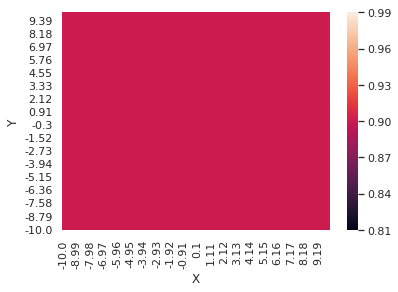

Return recorded for episode 777 :  5016.063024973504
0.010000172986836342


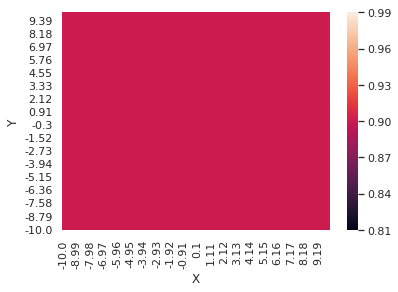

Return recorded for episode 778 :  5004.682367575286
0.010000169561467482


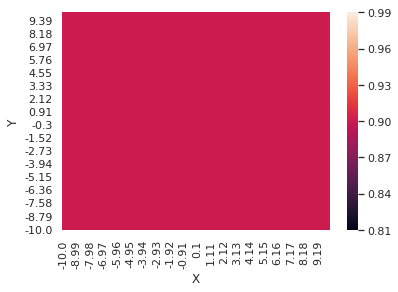

Return recorded for episode 779 :  4995.438721484749
0.01000016620392547


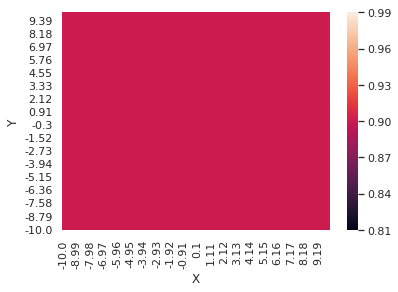

Return recorded for episode 780 :  4994.802989537935
Episode 680 ..780   Avg reward: 5015.265780456037   Epsilon: 0.0100
0.010000162912867244


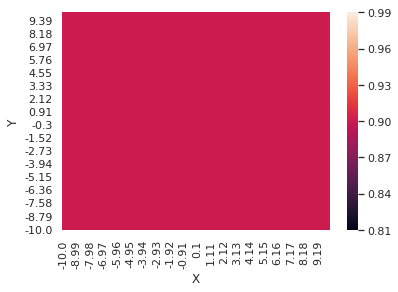

Return recorded for episode 781 :  5044.454089331436
0.010000159686976337


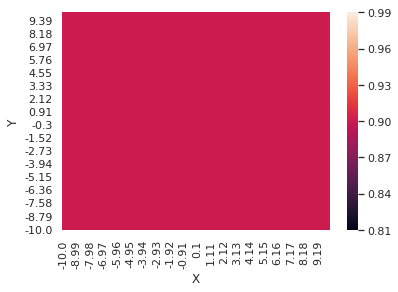

Return recorded for episode 782 :  4977.471365322136
0.01000015652496235


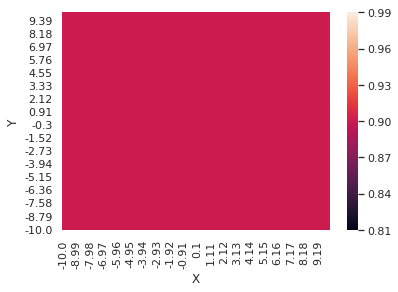

Return recorded for episode 783 :  5063.221556981378
0.010000153425560435


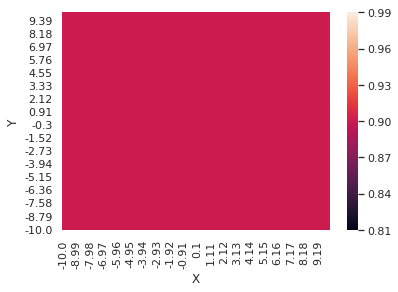

Return recorded for episode 784 :  4985.302991941363
0.01000015038753079


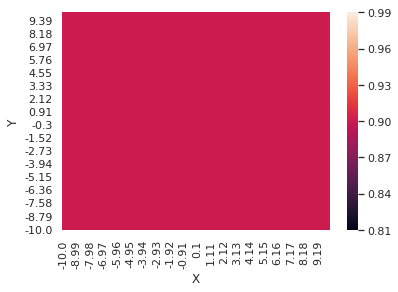

Return recorded for episode 785 :  5017.925024345553
0.010000147409658162


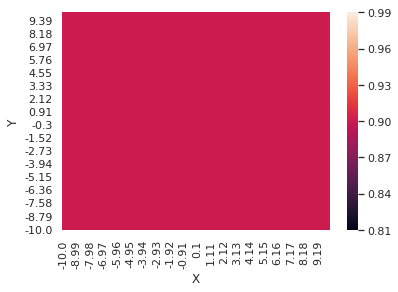

Return recorded for episode 786 :  4981.480327772612
0.010000144490751362


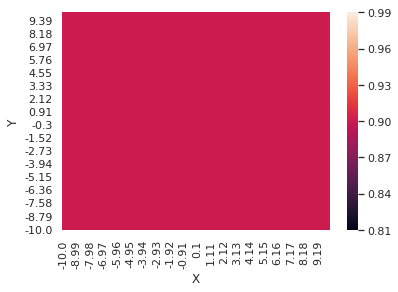

Return recorded for episode 787 :  5118.389042906016
0.010000141629642792


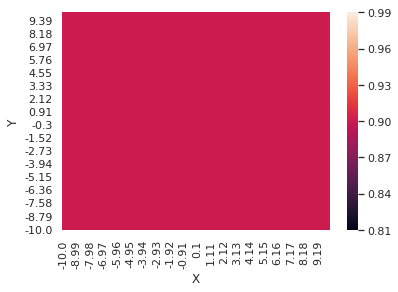

Return recorded for episode 788 :  5060.157935760325
0.010000138825187965


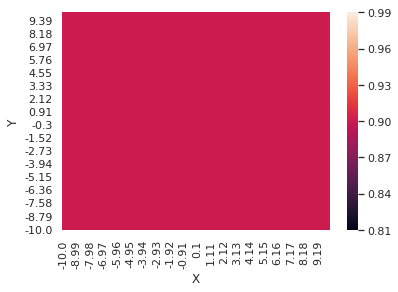

Return recorded for episode 789 :  5039.910105415897
0.010000136076265065


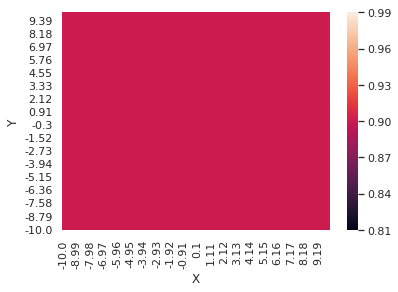

Return recorded for episode 790 :  5075.8719466662005
Episode 690 ..790   Avg reward: 5028.311542931465   Epsilon: 0.0100
0.010000133381774485


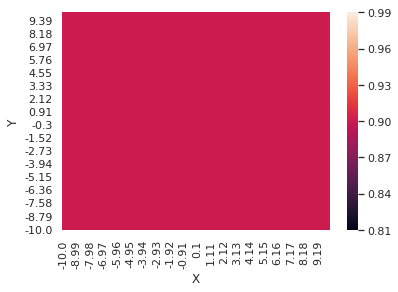

Return recorded for episode 791 :  5018.914322144078
0.010000130740638394


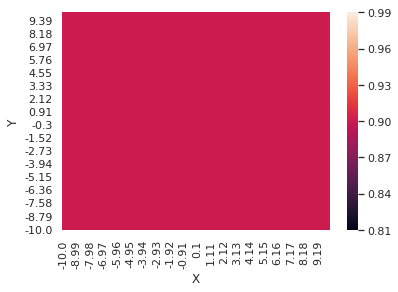

Return recorded for episode 792 :  5046.3866453758765
0.0100001281518003


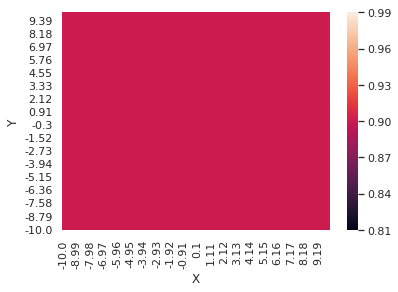

Return recorded for episode 793 :  5001.905723801945
0.010000125614224637


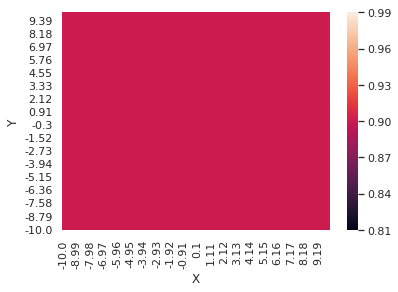

Return recorded for episode 794 :  4987.536520623339
0.010000123126896337


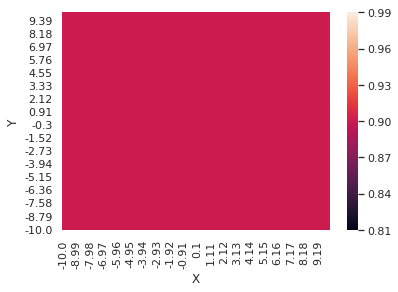

Return recorded for episode 795 :  4975.728145003933
0.010000120688820438


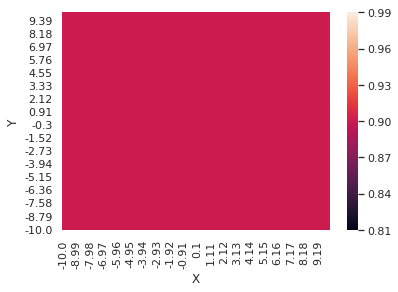

Return recorded for episode 796 :  4999.947750527042
0.010000118299021676


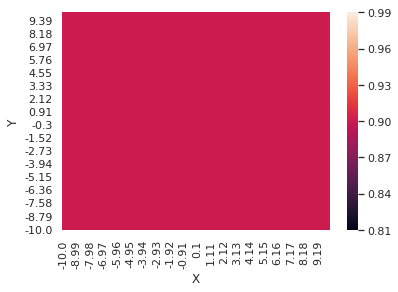

Return recorded for episode 797 :  5020.899279424983
0.010000115956544101


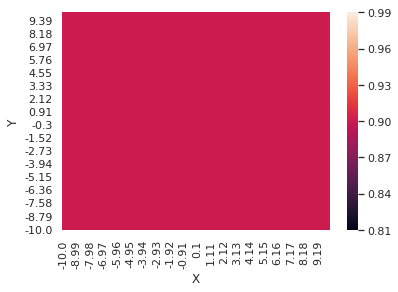

Return recorded for episode 798 :  5012.479457577529
0.010000113660450689


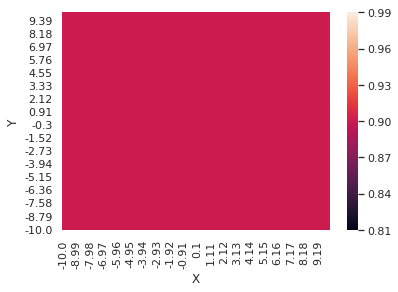

Return recorded for episode 799 :  4997.5169067301495
0.010000111409822971


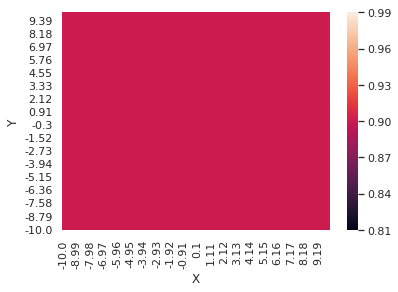

Return recorded for episode 800 :  5065.913747436627
Episode 700 ..800   Avg reward: 5013.718669787509   Epsilon: 0.0100
0.010000109203760672


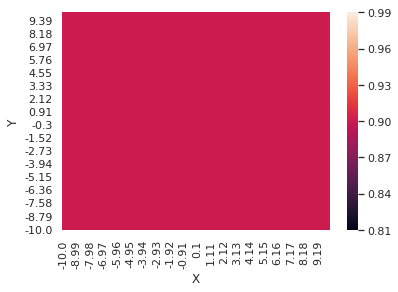

Return recorded for episode 801 :  5059.61172682787
0.01000010704138133


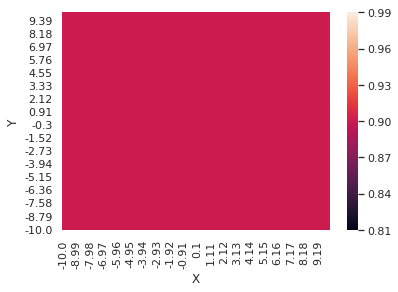

Return recorded for episode 802 :  4991.924034040691
0.010000104921819969


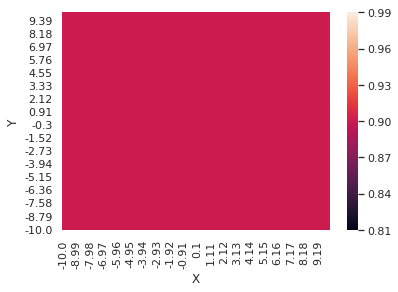

Return recorded for episode 803 :  5022.540407954415
0.010000102844228734


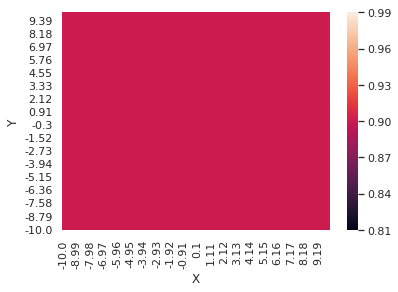

Return recorded for episode 804 :  4986.703373361612
0.010000100807776562


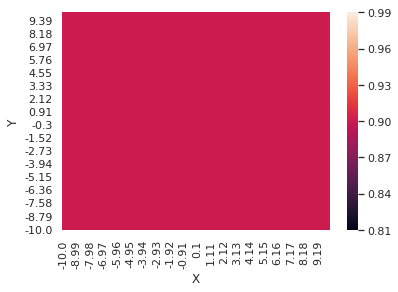

Return recorded for episode 805 :  5002.8926296225945
0.010000098811648846


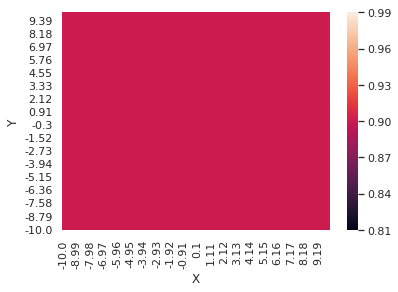

Return recorded for episode 806 :  4992.3705476936775
0.010000096855047106


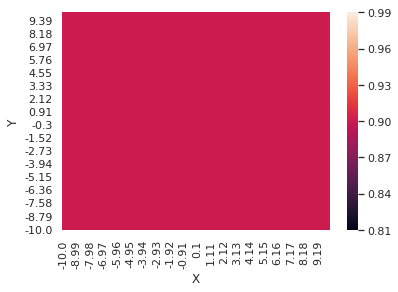

Return recorded for episode 807 :  5049.705298358567
0.010000094937188675


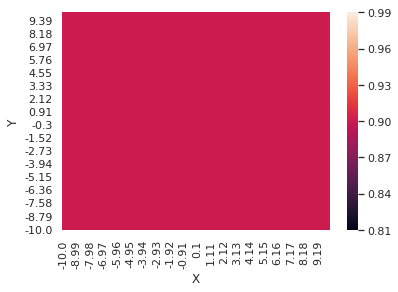

Return recorded for episode 808 :  5023.176923904352
0.010000093057306387


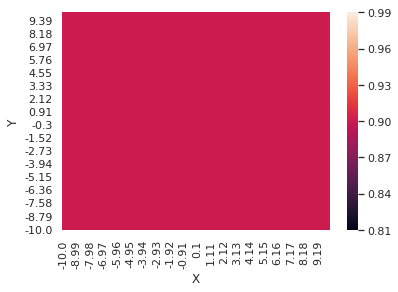

Return recorded for episode 809 :  5015.218780805029
0.010000091214648262


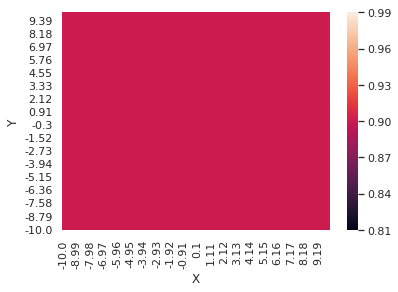

Return recorded for episode 810 :  5022.784974527012
Episode 710 ..810   Avg reward: 5021.005747000543   Epsilon: 0.0100
0.010000089408477212


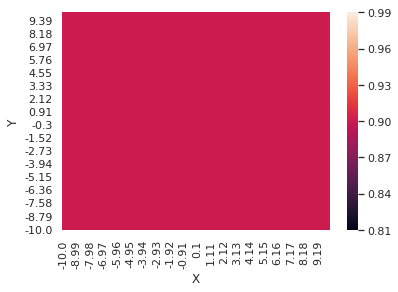

Return recorded for episode 811 :  4961.739937577497
0.010000087638070747


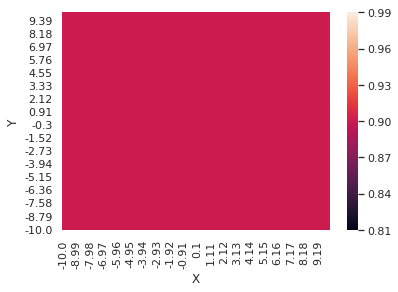

Return recorded for episode 812 :  5007.094151994326
0.010000085902720677


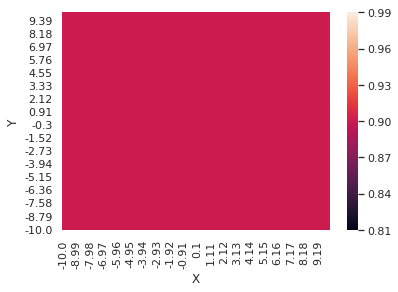

Return recorded for episode 813 :  5009.328104541345
0.010000084201732842


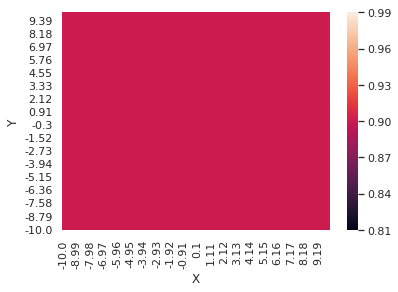

Return recorded for episode 814 :  5013.977279260017
0.010000082534426821


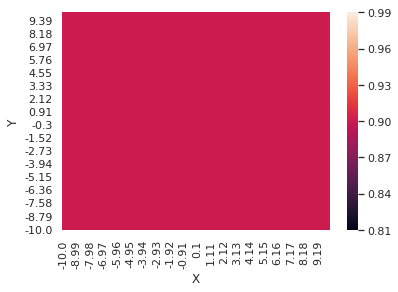

Return recorded for episode 815 :  4964.636414237526
0.010000080900135672


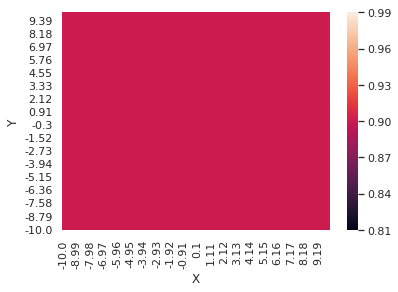

Return recorded for episode 816 :  5058.2454720131345
0.010000079298205657


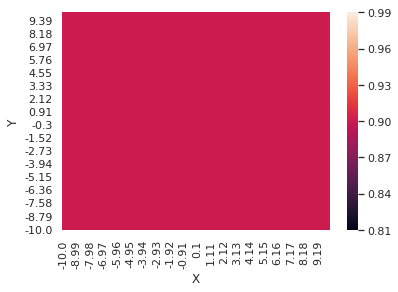

Return recorded for episode 817 :  4983.888021149991
0.010000077727995979


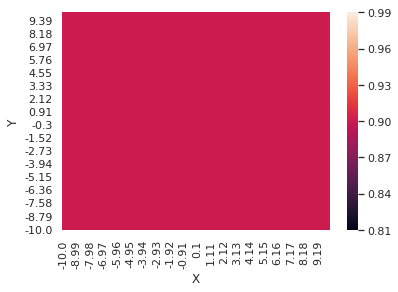

Return recorded for episode 818 :  5033.6150749775325
0.010000076188878538


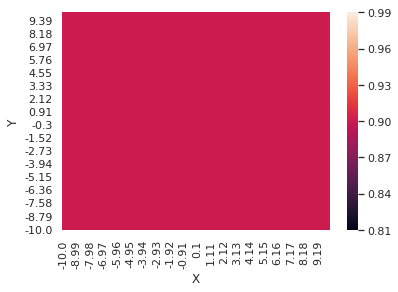

Return recorded for episode 819 :  5012.16886120501
0.010000074680237664


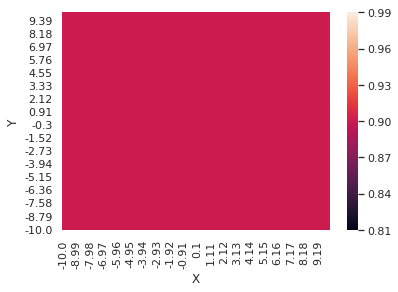

Return recorded for episode 820 :  5016.4297319192365
Episode 720 ..820   Avg reward: 5006.74782914834   Epsilon: 0.0100
0.01000007320146988


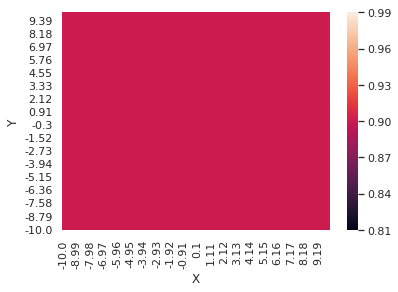

Return recorded for episode 821 :  4999.341891946244
0.01000007175198366


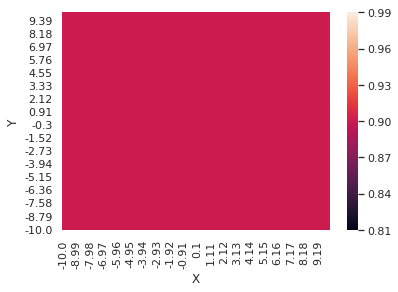

Return recorded for episode 822 :  5008.28012395729
0.010000070331199191


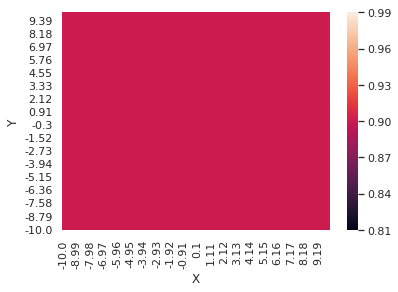

Return recorded for episode 823 :  5022.954441081623
0.01000006893854814


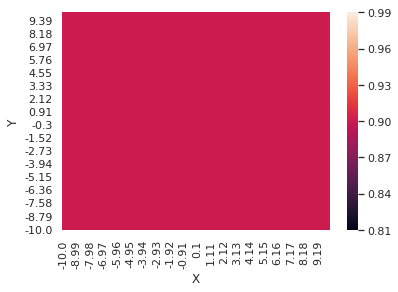

Return recorded for episode 824 :  5041.644523986162
0.010000067573473426


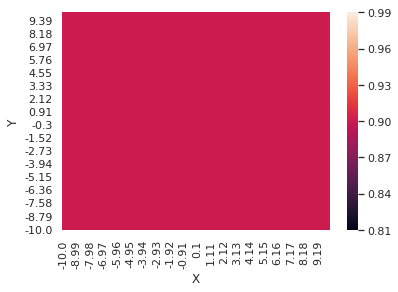

Return recorded for episode 825 :  4966.8523018920405
0.010000066235429003


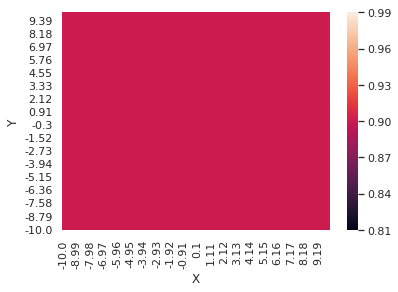

Return recorded for episode 826 :  5076.757082352632
0.010000064923879634


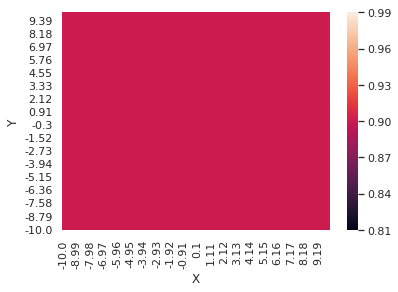

Return recorded for episode 827 :  5024.056377366832
0.010000063638300683


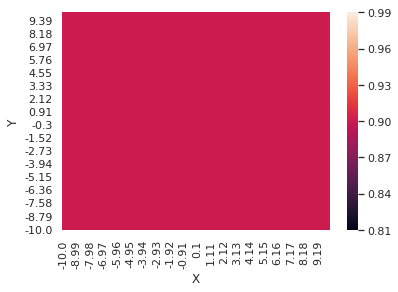

Return recorded for episode 828 :  5031.540202766548
0.010000062378177901


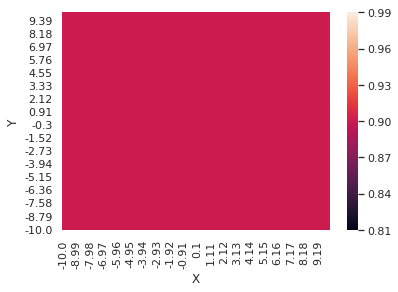

Return recorded for episode 829 :  5024.279628049015
0.010000061143007222


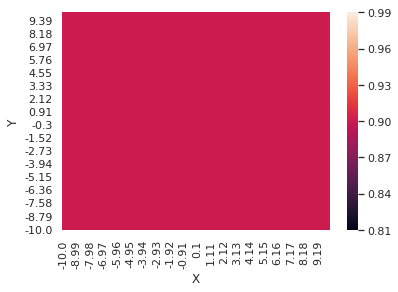

Return recorded for episode 830 :  4990.749651520824
Episode 730 ..830   Avg reward: 5021.213630531763   Epsilon: 0.0100
0.010000059932294561


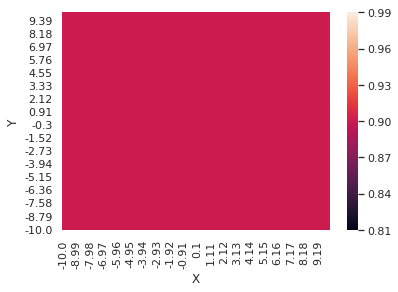

Return recorded for episode 831 :  5007.070296867385
0.010000058745555618


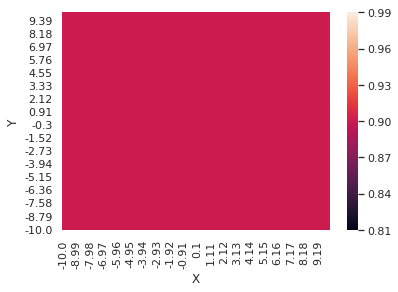

Return recorded for episode 832 :  5025.868531785798
0.010000057582315678


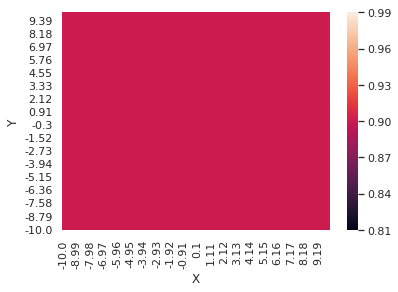

Return recorded for episode 833 :  4993.638974526545
0.010000056442109434


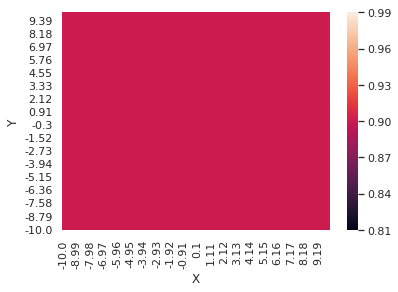

Return recorded for episode 834 :  5079.827510216599
0.010000055324480787


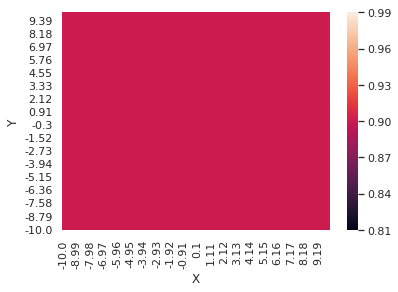

Return recorded for episode 835 :  4968.92698679445
0.010000054228982667


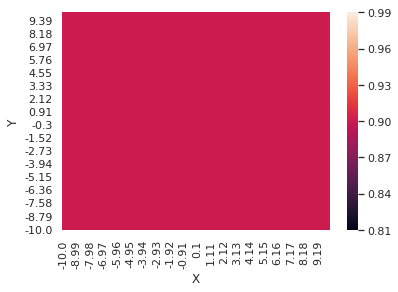

Return recorded for episode 836 :  5057.483410505241
0.010000053155176866


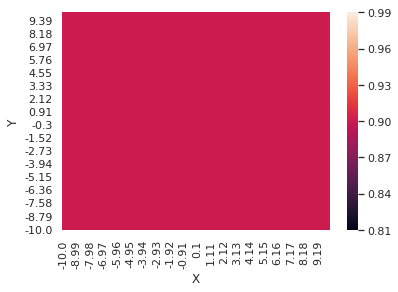

Return recorded for episode 837 :  5013.962608977498
0.010000052102633843


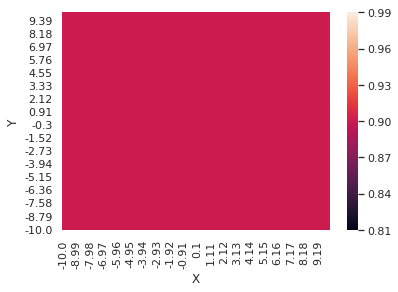

Return recorded for episode 838 :  5061.665567215552
0.010000051070932568


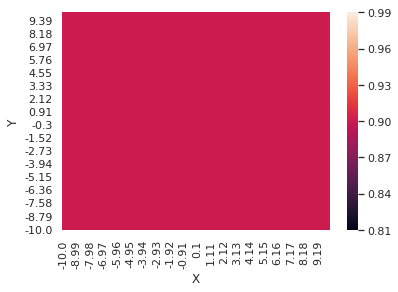

Return recorded for episode 839 :  4992.121259368209
0.01000005005966035


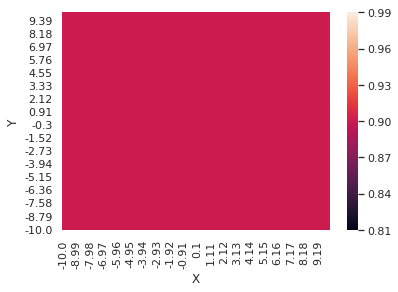

Return recorded for episode 840 :  5020.8791609382515
Episode 740 ..840   Avg reward: 5019.13147977781   Epsilon: 0.0100
0.01000004906841266


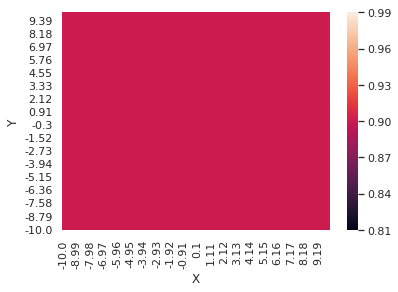

Return recorded for episode 841 :  5045.425863340939
0.010000048096792991


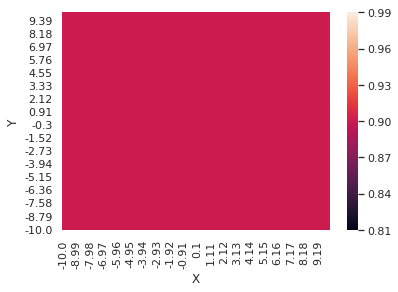

Return recorded for episode 842 :  5043.11362518211
0.01000004714441268


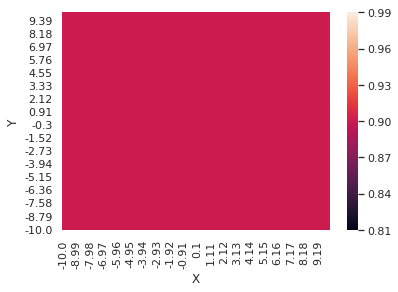

Return recorded for episode 843 :  5031.370015004246
0.010000046210890762


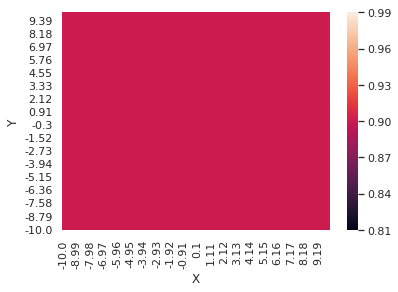

Return recorded for episode 844 :  5020.30853661325
0.010000045295853818


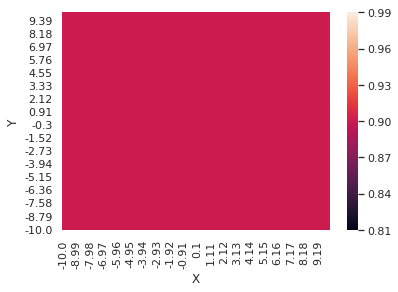

Return recorded for episode 845 :  5046.132927614251
0.010000044398935818


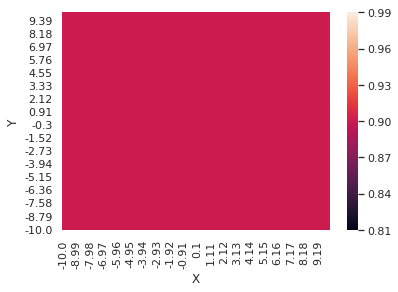

Return recorded for episode 846 :  4998.534257818837
0.010000043519777985


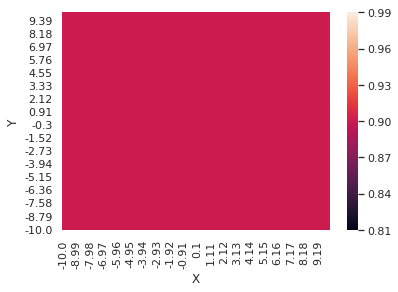

Return recorded for episode 847 :  5029.603707756567
0.010000042658028644


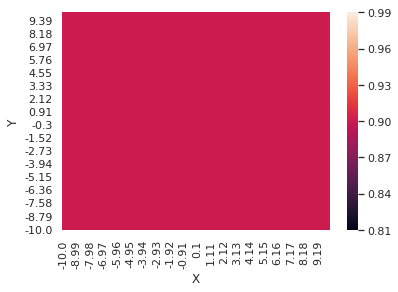

Return recorded for episode 848 :  5016.378733635566
0.010000041813343083


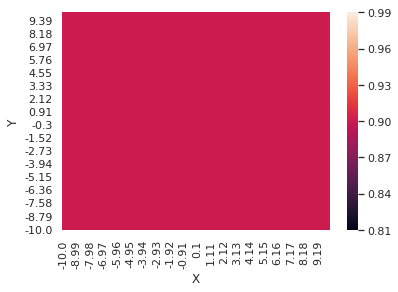

Return recorded for episode 849 :  5001.994266097236
0.010000040985383415


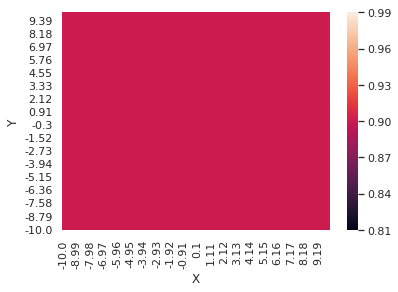

Return recorded for episode 850 :  5015.525595146883
Episode 750 ..850   Avg reward: 5025.374109400125   Epsilon: 0.0100
0.01000004017381845


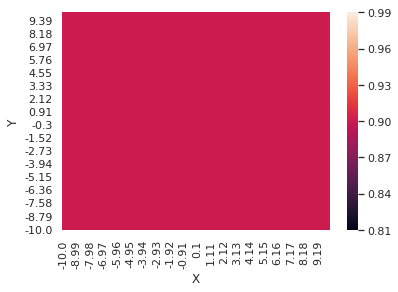

Return recorded for episode 851 :  4993.575907033491
0.010000039378323547


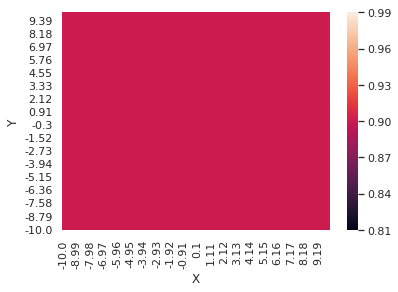

Return recorded for episode 852 :  4992.304342650365
0.010000038598580497


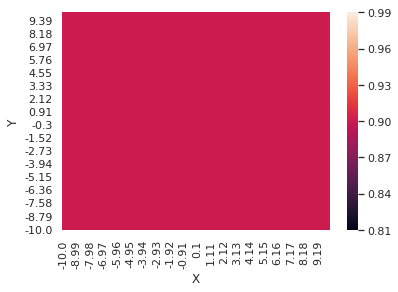

Return recorded for episode 853 :  5024.635903134622
0.010000037834277395


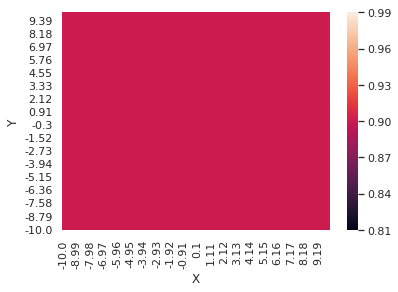

Return recorded for episode 854 :  5004.982798403091
0.010000037085108507


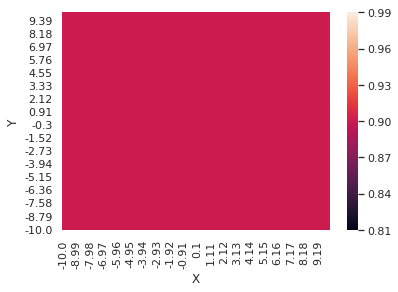

Return recorded for episode 855 :  5039.783057054701
0.010000036350774158


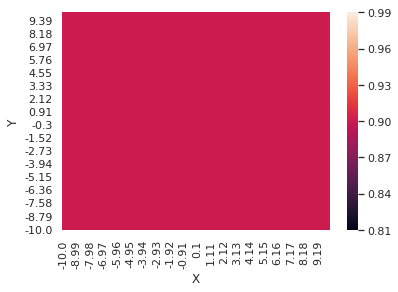

Return recorded for episode 856 :  5067.398066731913
0.010000035630980604


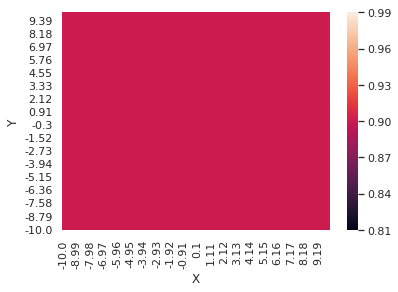

Return recorded for episode 857 :  5038.754222279199
0.010000034925439917


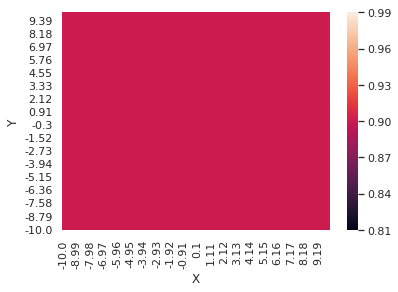

Return recorded for episode 858 :  5029.950351143932
0.010000034233869871


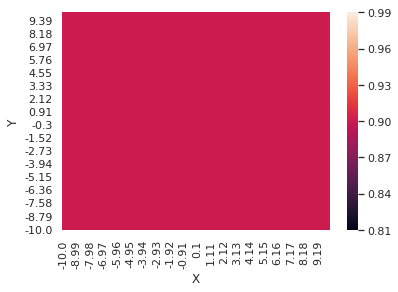

Return recorded for episode 859 :  5038.962709704518
0.01000003355599383


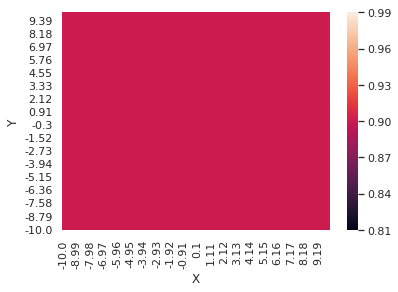

Return recorded for episode 860 :  5042.331776011676
Episode 760 ..860   Avg reward: 5024.587295328271   Epsilon: 0.0100
0.010000032891540634


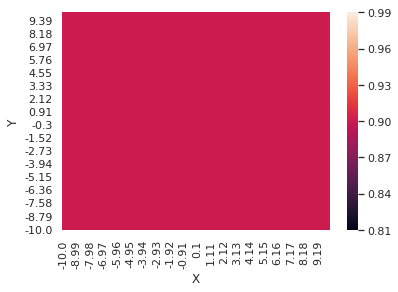

Return recorded for episode 861 :  5012.058711528523
0.010000032240244492


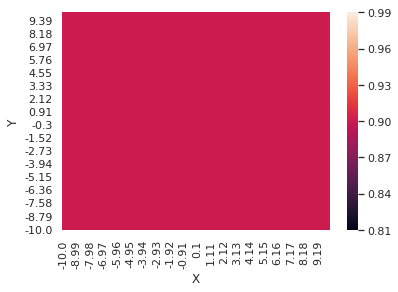

Return recorded for episode 862 :  4939.883455156861
0.010000031601844877


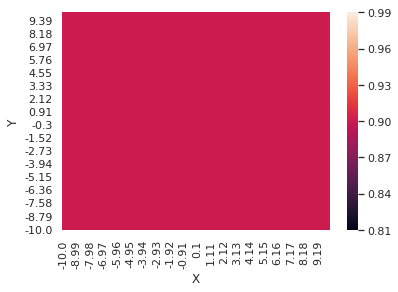

Return recorded for episode 863 :  4991.944827343474
0.010000030976086424


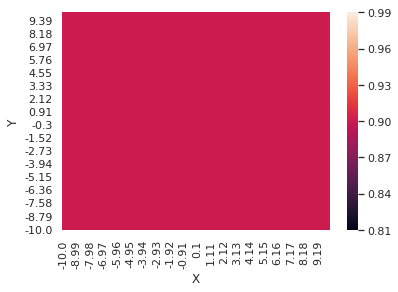

Return recorded for episode 864 :  5001.657468336286
0.010000030362718817


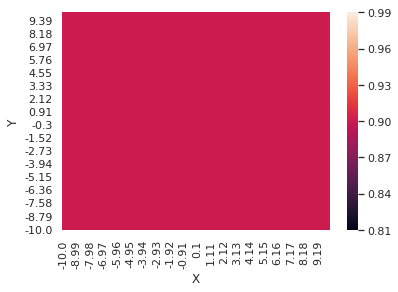

Return recorded for episode 865 :  5059.481945874058
0.010000029761496701


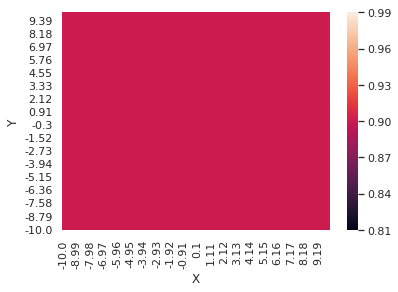

Return recorded for episode 866 :  4996.225742456493
0.010000029172179582


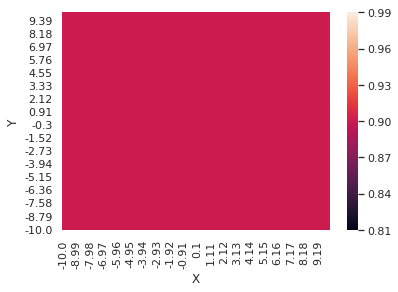

Return recorded for episode 867 :  5039.633348961683
0.010000028594531725


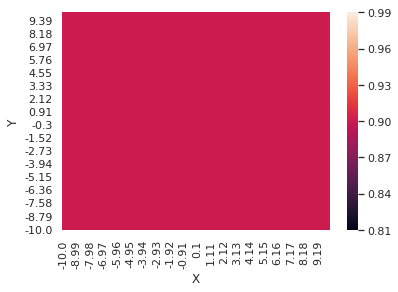

Return recorded for episode 868 :  5024.815696062723
0.01000002802832206


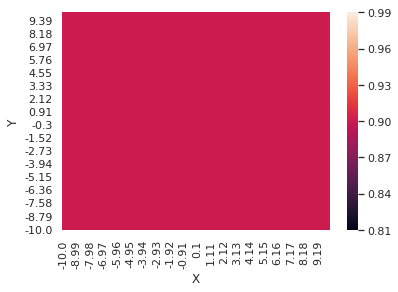

Return recorded for episode 869 :  5034.98813362155
0.010000027473324099


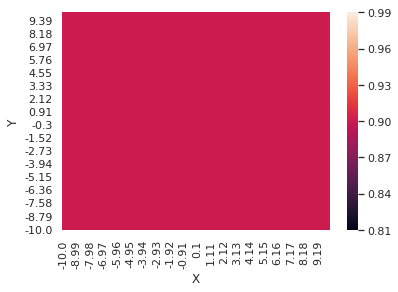

Return recorded for episode 870 :  5019.297894060084
Episode 770 ..870   Avg reward: 5014.302110535332   Epsilon: 0.0100
0.010000026929315833


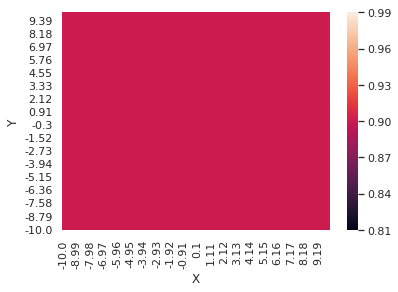

Return recorded for episode 871 :  5028.879953684369
0.010000026396079652


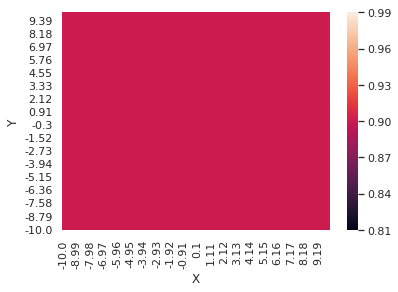

Return recorded for episode 872 :  5015.316880343703
0.010000025873402256


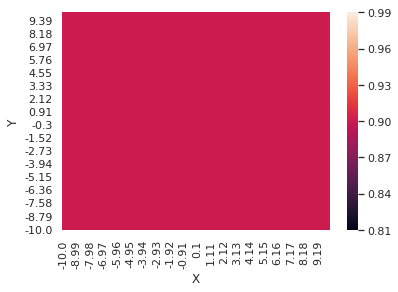

Return recorded for episode 873 :  4946.237553960753
0.010000025361074565


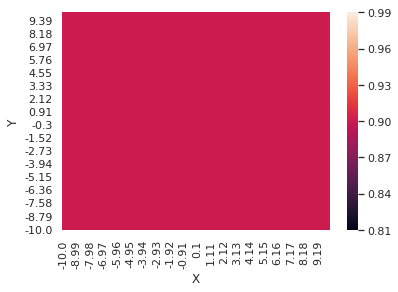

Return recorded for episode 874 :  5002.942944514505
0.010000024858891642


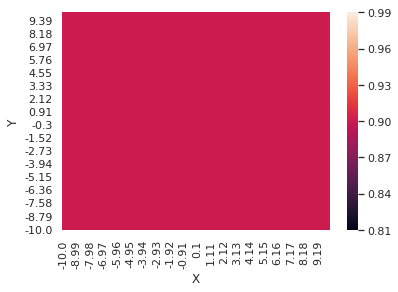

Return recorded for episode 875 :  5028.828826291557
0.010000024366652607


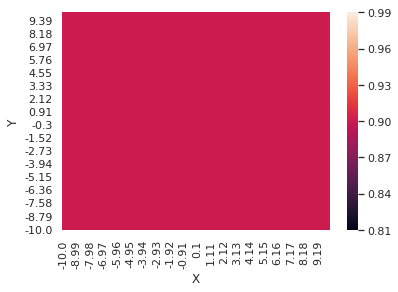

Return recorded for episode 876 :  5022.350483693426
0.01000002388416056


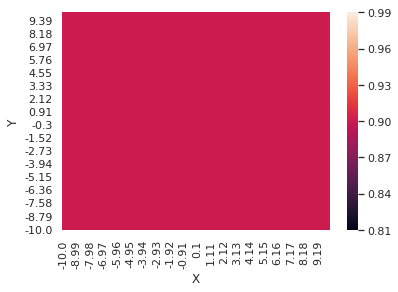

Return recorded for episode 877 :  5028.778447850344
0.010000023411222492


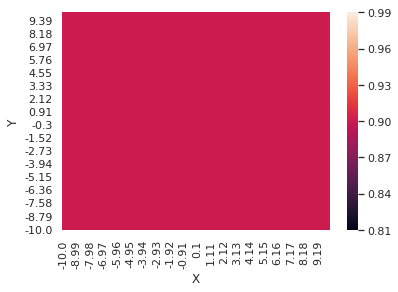

Return recorded for episode 878 :  4982.823471490757
0.010000022947649227


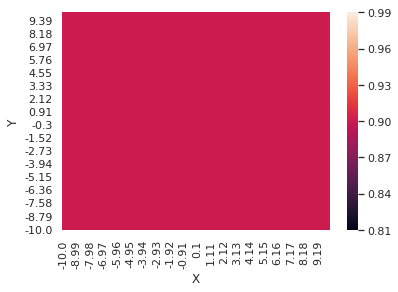

Return recorded for episode 879 :  5021.696153201117
0.010000022493255328


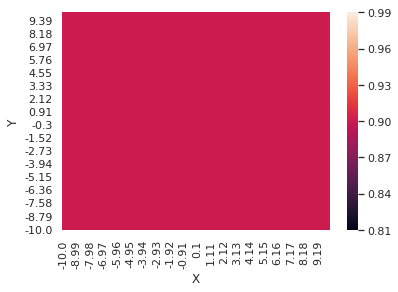

Return recorded for episode 880 :  5055.00050471584
Episode 780 ..880   Avg reward: 5009.715260909062   Epsilon: 0.0100
0.010000022047859032


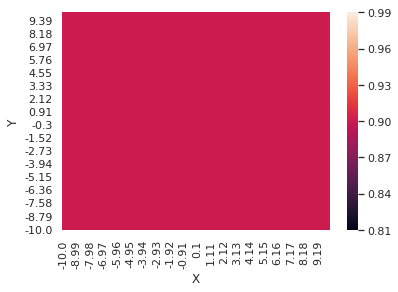

Return recorded for episode 881 :  5036.087626086424
0.010000021611282172


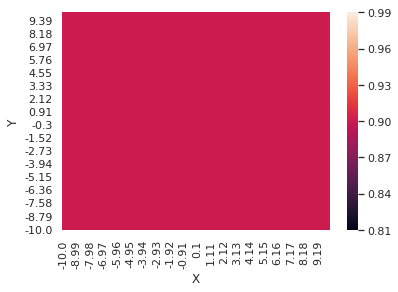

Return recorded for episode 882 :  5058.660060681841
0.010000021183350114


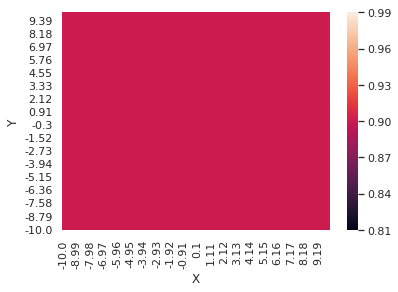

Return recorded for episode 883 :  5061.168579777819
0.010000020763891677


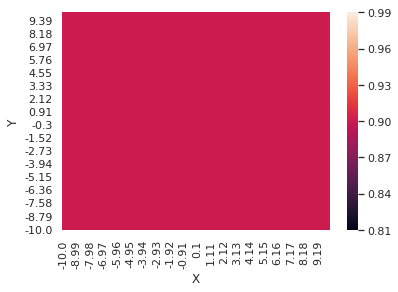

Return recorded for episode 884 :  4938.783119437259
0.010000020352739074


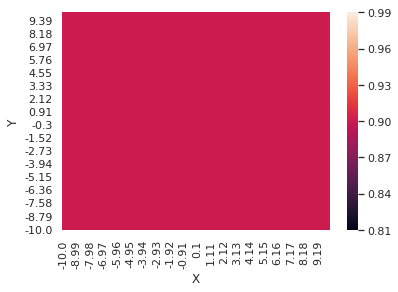

Return recorded for episode 885 :  5137.397370630839
0.010000019949727839


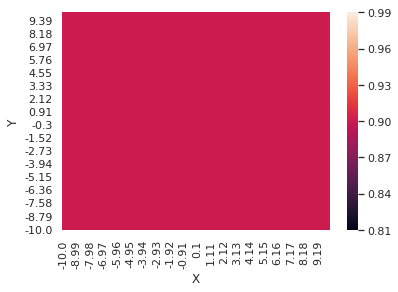

Return recorded for episode 886 :  5012.013356724266
0.010000019554696761


KeyboardInterrupt: 

In [13]:
# Exploration parameters
min_epsilon = 0.01           # minimum exploration probability
decay_rate = 20/NUM_EPISODES

returns = np.zeros(NUM_EPISODES)

for ep in range(1, NUM_EPISODES):
    # Start new episode
    state = env.reset()
    state = np.reshape(state, [1, state.size])

    total_reward = 0
    episode_step = 0
    done = False

    epsilon = min_epsilon + (1.0 - min_epsilon)*np.exp(-decay_rate*ep)

    while not done:
        episode_step += 1
        
        action = DQN.action_sampler(state, epsilon)
        
        # Take action, get new state and reward
        next_state, reward, done, _ = env.step(action)
        next_state = np.reshape(next_state, [1, state.size])

        total_reward += reward
        
        # add to replay buffer
        DQN.replay_buffer.push(state, action, reward, next_state, done)
        state = next_state
    
    # Progress updates
    returns[ep]=total_reward

    # Plot policy learning process
    if ep % 10 == 0:
        ax = action_heatmap.main(env, DQN.mainDQN)
        fig = ax.get_figure()
        fig.savefig('./heatmaps/action_heatmap_ep_' + str(ep) +'.png')
    
    print('Return recorded for episode ' + str(ep) + ' : ', total_reward)
    if ep % 10 == 0 or ep == NUM_EPISODES-1: #print out gradual improvement
        print('Episode {}'.format(ep-10),'..{}'.format(ep),'  Avg reward: {}'.format(sum(returns[ep-10:ep])/10),'  Epsilon: {:.4f}'.format(epsilon))
    
    # Train network!
    if len(DQN.replay_buffer) >= learn_start:
        DQN.train()



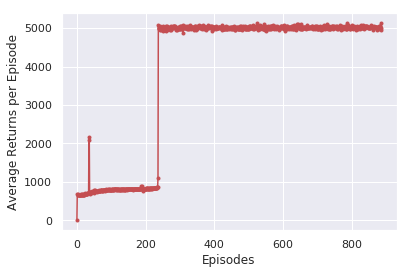

In [14]:
# plot average returns
returns_over_each_episode = []
x = []
for i in range(ep):
    returns_over_each_episode.append(sum(returns[1*i:1*(i+1)-1])/1)
    x.append((i+1)*1)
plt.plot(returns[:ep], '.-r')
plt.ylabel('Average Returns per Episode')
plt.xlabel('Episodes')
plt.show()
    

## Ignore the rest of this file

Called only for testing helper scripts

In [ ]:
import importlib
importlib.reload(action_heatmap)
print(env)
ax = action_heatmap.main(env, DQN.mainDQN)
fig = ax.get_figure()
fig.savefig('./heatmaps/action_heatmap_ep_' + str(ep) +'.png')


In [ ]:
 %matplotlib qt
import reward_surface
import importlib
importlib.reload(reward_surface)
ax = reward_surface.main(env)
fig = ax.get_figure()